<a href="https://colab.research.google.com/github/Samy-Annasri/backcasting-for-adversarial-attacks-on-time-series/blob/main/BATS_birth_rate.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, Dataset,TensorDataset
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
import pandas as pd
import numpy as np
import random
import os
from sklearn.metrics import mean_absolute_error, mean_squared_error

In [ ]:
import sys
import os

def in_colab():
    return 'google.colab' in sys.modules

if in_colab():
    repo_name = "ReverseForecastAttack"
    ipynb_name = "ReverseForecastAttack.ipynb"
    cwd = os.getcwd()
    basename = os.path.basename(cwd)

    if basename != repo_name:
        if not os.path.exists(repo_name):
            !git clone https://github.com/Samy-Annasri/ReverseForecastAttack.git
        %cd {repo_name}
        %rm {ipynb_name}

Cloning into 'ReverseForecastAttack'...
remote: Enumerating objects: 7333, done.
remote: Counting objects: 100% (473/473), done.
remote: Compressing objects: 100% (456/456), done.
remote: Total 7333 (delta 58), reused 395 (delta 9), pack-reused 6860 (from 2)
Receiving objects: 100% (7333/7333), 533.30 MiB | 29.49 MiB/s, done.
Resolving deltas: 100% (339/339), done.
Updating files: 100% (3958/3958), done.
/content/ReverseForecastAttack


In [ ]:
seed = 999
def set_seed(seed):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

set_seed(seed)

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda


In [ ]:
from utils.birth.load_tsf import load_us_births_tsf_flat
df = load_us_births_tsf_flat("data/us_births_dataset.tsf")
print(df)

           date  births
0    1969-01-01    8486
1    1969-01-02    9002
2    1969-01-03    9542
3    1969-01-04    8960
4    1969-01-05    8390
...         ...     ...
7300 1988-12-27   11528
7301 1988-12-28   11847
7302 1988-12-29   11704
7303 1988-12-30   11837
7304 1988-12-31    9133

[7305 rows x 2 columns]


count     7305.000000
mean      9648.940178
std       1127.315229
min       6675.000000
25%       8792.000000
50%       9622.000000
75%      10510.000000
max      12851.000000
Name: births, dtype: float64


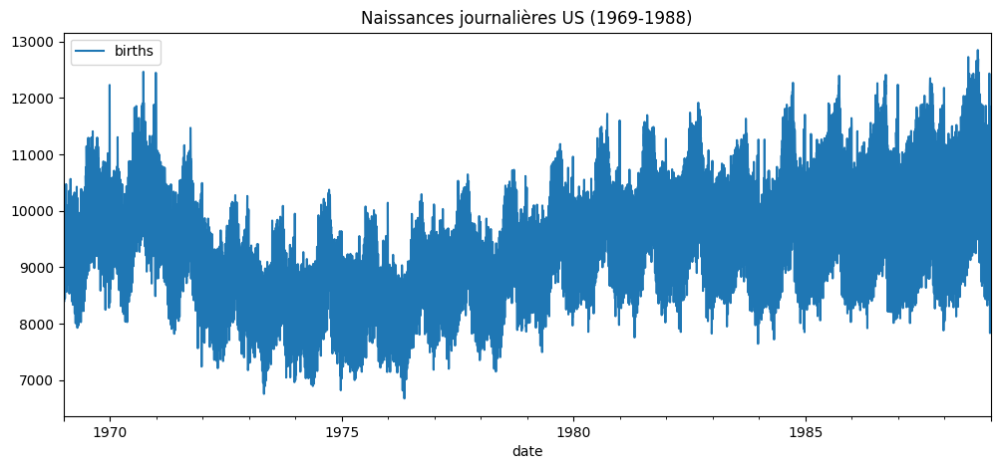

In [ ]:
print(df["births"].describe())

import matplotlib.pyplot as plt
df.plot(x="date", y="births", figsize=(12,5), title="Naissances journalières US (1969-1988)")
plt.show()


In [ ]:
from utils.birth.setup_birth import prepare_births_dataset

In [ ]:
sequence_length = 30
result = prepare_births_dataset(df, sequence_length)

train_loader = result['train_loader']
test_loader = result['test_loader']
train_size = result['train_size']
serie_min, serie_max = result['min_max']
dates = result['dates_train']
dates_test = result['dates_test']

In [ ]:
#name model_elec but work also with birth btw
from utils.elec.train_model_elec import train_models_elec

In [ ]:
from models.lstm import SimpleLSTM
model = SimpleLSTM(input_size=1, hidden_size=64, output_size=1, num_layers=2)
model.to(device)
loss_fn = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)
num_epochs = 50

train_models_elec(model, loss_fn, optimizer, num_epochs, train_loader,device)

Epoch [1/50], Train Loss: 0.0396
Epoch [2/50], Train Loss: 0.0179
Epoch [3/50], Train Loss: 0.0163
Epoch [4/50], Train Loss: 0.0164
Epoch [5/50], Train Loss: 0.0165
Epoch [6/50], Train Loss: 0.0163
Epoch [7/50], Train Loss: 0.0159
Epoch [8/50], Train Loss: 0.0152
Epoch [9/50], Train Loss: 0.0078
Epoch [10/50], Train Loss: 0.0056
Epoch [11/50], Train Loss: 0.0053
Epoch [12/50], Train Loss: 0.0049
Epoch [13/50], Train Loss: 0.0049
Epoch [14/50], Train Loss: 0.0046
Epoch [15/50], Train Loss: 0.0045
Epoch [16/50], Train Loss: 0.0043
Epoch [17/50], Train Loss: 0.0041
Epoch [18/50], Train Loss: 0.0041
Epoch [19/50], Train Loss: 0.0040
Epoch [20/50], Train Loss: 0.0038
Epoch [21/50], Train Loss: 0.0037
Epoch [22/50], Train Loss: 0.0038
Epoch [23/50], Train Loss: 0.0037
Epoch [24/50], Train Loss: 0.0036
Epoch [25/50], Train Loss: 0.0035
Epoch [26/50], Train Loss: 0.0035
Epoch [27/50], Train Loss: 0.0034
Epoch [28/50], Train Loss: 0.0035
Epoch [29/50], Train Loss: 0.0036
Epoch [30/50], Train Lo

In [ ]:
from utils.birth.evaluate_model_births import evaluate_model_births

In [ ]:
results = evaluate_model_births(model, test_loader, dates_test, train_size)

real_values = results['real_values']
predicted_values = results['predicted_values']
test_dates = results['test_dates']

In [ ]:
# Computes scalar similarity (cosine similarity) between true and predicted values.
# Higher values indicate that adversarial predictions remain directionally aligned
# with the true values, suggesting stealthy and rational attacks!
def scalar_similarity(y_true, y_pred):
    numerator = np.dot(y_true, y_pred)
    denominator = np.linalg.norm(y_true) * np.linalg.norm(y_pred)
    if denominator == 0:
        return 0.0
    return numerator / denominator

In [ ]:
# Creation of the tab result for plotting adversial attack result
models = ['LSTM','RNN','GRU']
metrics = ['MAE', "RMSE", 'SIM']

row_index = pd.MultiIndex.from_product([models, metrics], names=['Model', 'Metric'])

attacks = ['NA','PAST','REV']
epsilons = {
    'NA': [0],
    'PAST':[0],
    'REV':[0.01, 0.02, 0.03, 0.04, 0.05, 0.075, 0.1, 0.2],
}

col_tuples = []
for atk, eps_list in epsilons.items():
    for eps in eps_list:
        col_tuples.append((atk, f"{eps:.2f}"))

col_index = pd.MultiIndex.from_tuples(col_tuples, names=['Attack', 'ε'])

res_tab = pd.DataFrame(index=row_index, columns=col_index, dtype=float)

print(res_tab)

Attack         NA PAST  REV                                   
ε            0.00 0.00 0.01 0.02 0.03 0.04 0.05 0.07 0.10 0.20
Model Metric                                                  
LSTM  MAE     NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      RMSE    NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      SIM     NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
RNN   MAE     NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      RMSE    NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      SIM     NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
GRU   MAE     NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      RMSE    NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      SIM     NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN


In [ ]:
from utils.birth.log_and_plot_births import log_and_plot_births

LSTM | NA – Epsilon 0.00 – MAE: 427.8173 | SIM: 0.9991 | RMSE: 529.7172


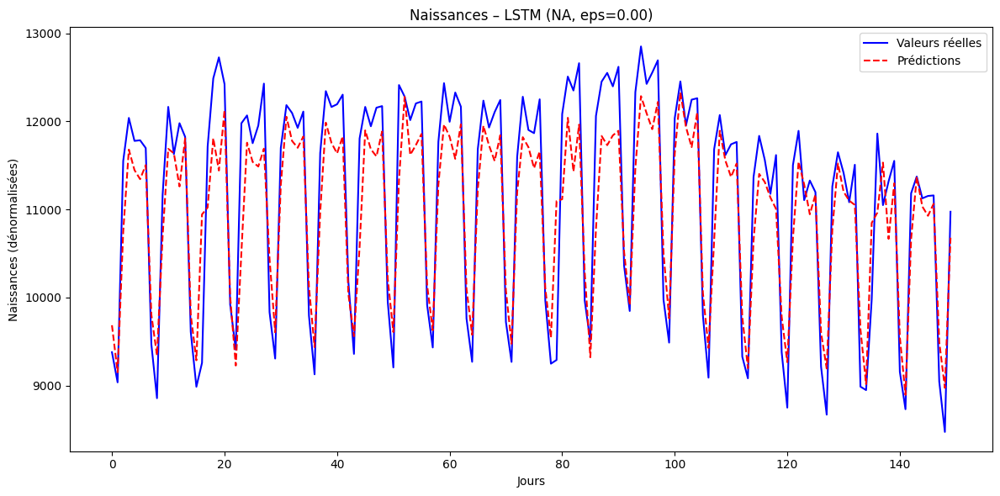

In [ ]:
# Dénormalisation
real_values_denorm = results['real_values'] * (serie_max - serie_min) + serie_min
predicted_values_denorm = results['predicted_values'] * (serie_max - serie_min) + serie_min

days_plot = 150

log_and_plot_births(
    true_values=real_values_denorm[-days_plot:],
    predictions=predicted_values_denorm[-days_plot:],
    model_name='LSTM',
    attack_name='NA',
    epsilon=0.0,
    res_tab=res_tab,
    similarity_fn=scalar_similarity,
    save_path=f"results/birth/SEED_{seed}/plots/NA/0",
    save_png=True
)


In [ ]:
result_rev = prepare_births_dataset(df, sequence_length,reverse=True)

train_loader_rev = result_rev['train_loader']
test_loader_rev = result_rev['test_loader']
train_size_rev = result_rev['train_size']
serie_min_rev, serie_max_rev = result_rev['min_max']
dates_rev = result_rev['dates_test']

In [ ]:
model_rev = SimpleLSTM(input_size=1, hidden_size=64, output_size=1, num_layers=2)
optimizer_rev = torch.optim.Adam(model_rev.parameters(), lr=0.001)
model_rev.to(device)
train_models_elec(model_rev, loss_fn, optimizer_rev, num_epochs, train_loader_rev,device)

Epoch [1/50], Train Loss: 0.0479
Epoch [2/50], Train Loss: 0.0190
Epoch [3/50], Train Loss: 0.0168
Epoch [4/50], Train Loss: 0.0161
Epoch [5/50], Train Loss: 0.0159
Epoch [6/50], Train Loss: 0.0158
Epoch [7/50], Train Loss: 0.0135
Epoch [8/50], Train Loss: 0.0077
Epoch [9/50], Train Loss: 0.0056
Epoch [10/50], Train Loss: 0.0049
Epoch [11/50], Train Loss: 0.0045
Epoch [12/50], Train Loss: 0.0043
Epoch [13/50], Train Loss: 0.0041
Epoch [14/50], Train Loss: 0.0039
Epoch [15/50], Train Loss: 0.0040
Epoch [16/50], Train Loss: 0.0038
Epoch [17/50], Train Loss: 0.0038
Epoch [18/50], Train Loss: 0.0037
Epoch [19/50], Train Loss: 0.0036
Epoch [20/50], Train Loss: 0.0036
Epoch [21/50], Train Loss: 0.0035
Epoch [22/50], Train Loss: 0.0035
Epoch [23/50], Train Loss: 0.0033
Epoch [24/50], Train Loss: 0.0033
Epoch [25/50], Train Loss: 0.0033
Epoch [26/50], Train Loss: 0.0032
Epoch [27/50], Train Loss: 0.0032
Epoch [28/50], Train Loss: 0.0032
Epoch [29/50], Train Loss: 0.0031
Epoch [30/50], Train Lo

In [ ]:
results_rev = evaluate_model_births(model_rev, test_loader_rev, dates_rev, train_size_rev)

real_values_rev = results_rev['real_values']
predicted_values_rev = results_rev['predicted_values']
test_dates_rev = results_rev['test_dates']

LSTM | PAST – Epsilon 0.00 – MAE: 328.9230 | SIM: 0.9993 | RMSE: 439.1503


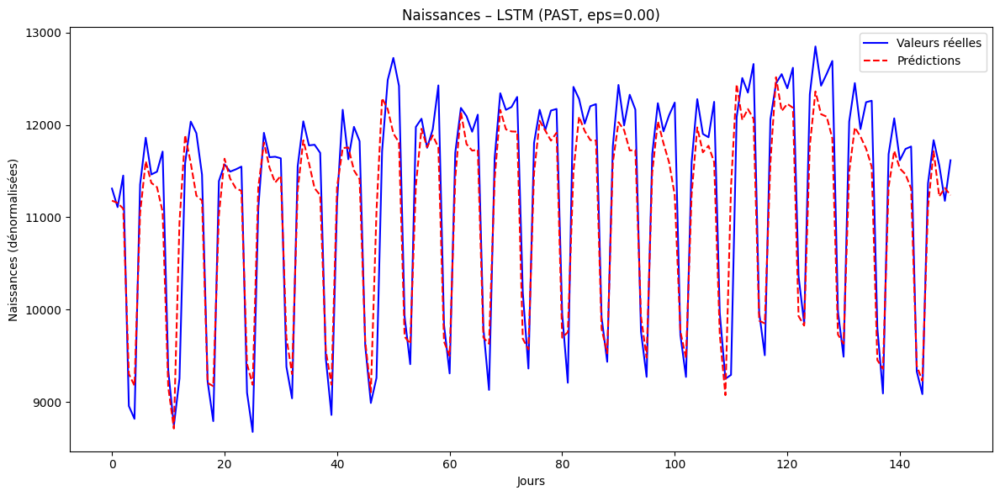

In [ ]:
# Denormalize
true_values_denorm_rev = real_values_rev * (serie_max_rev - serie_min_rev) + serie_min_rev
predictions_denorm_rev = predicted_values_rev * (serie_max_rev - serie_min_rev) + serie_min_rev

log_and_plot_births(
    true_values=true_values_denorm_rev[-days_plot:],
    predictions=predictions_denorm_rev[-days_plot:],
    model_name='LSTM',
    attack_name='PAST',
    epsilon=0.00,
    res_tab=res_tab,
    similarity_fn=scalar_similarity,
    save_path=f"results/birth/SEED_{seed}/plots/PAST/0",
    save_png=True
)

LSTM | REV – Epsilon 0.01 – MAE: 428.9673 | SIM: 0.9990 | RMSE: 530.5879


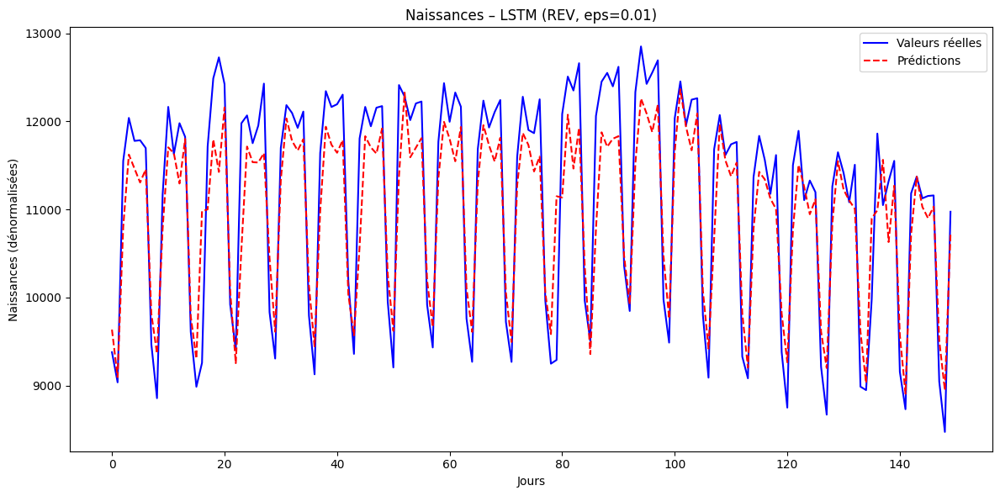

LSTM | REV – Epsilon 0.02 – MAE: 429.8119 | SIM: 0.9990 | RMSE: 533.9607


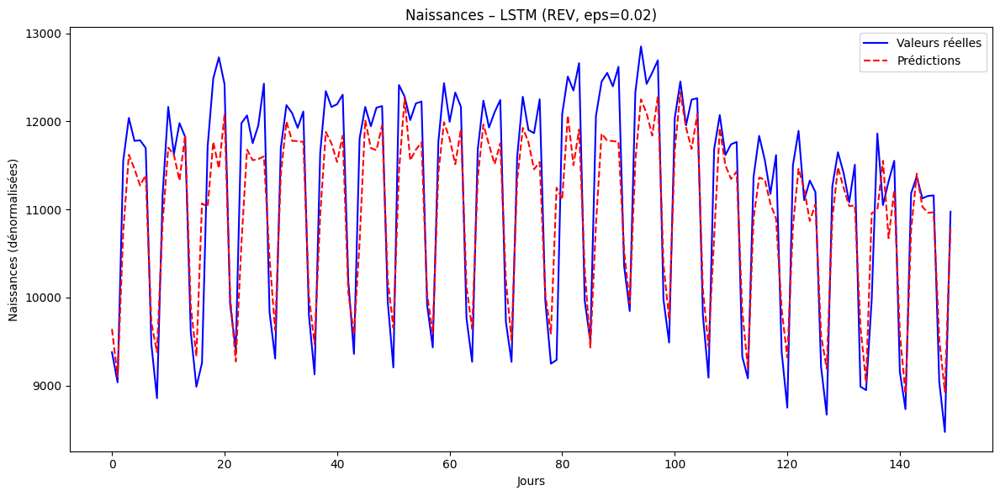

LSTM | REV – Epsilon 0.03 – MAE: 433.6675 | SIM: 0.9990 | RMSE: 537.4898


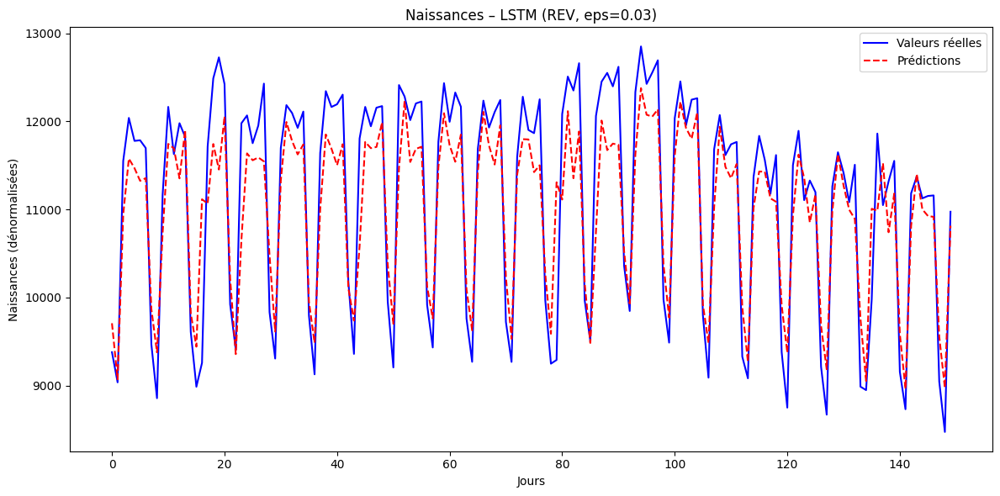

LSTM | REV – Epsilon 0.04 – MAE: 450.7326 | SIM: 0.9989 | RMSE: 552.6522


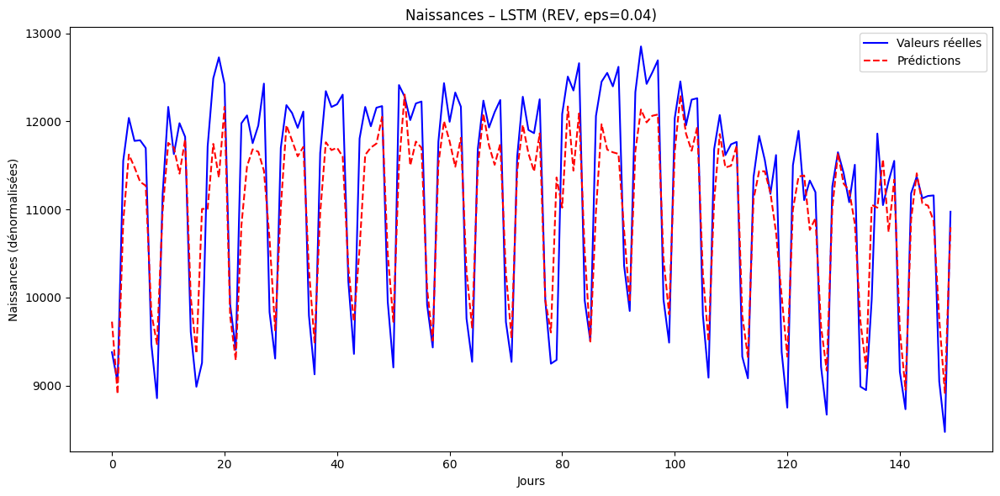

LSTM | REV – Epsilon 0.05 – MAE: 433.2659 | SIM: 0.9989 | RMSE: 547.6805


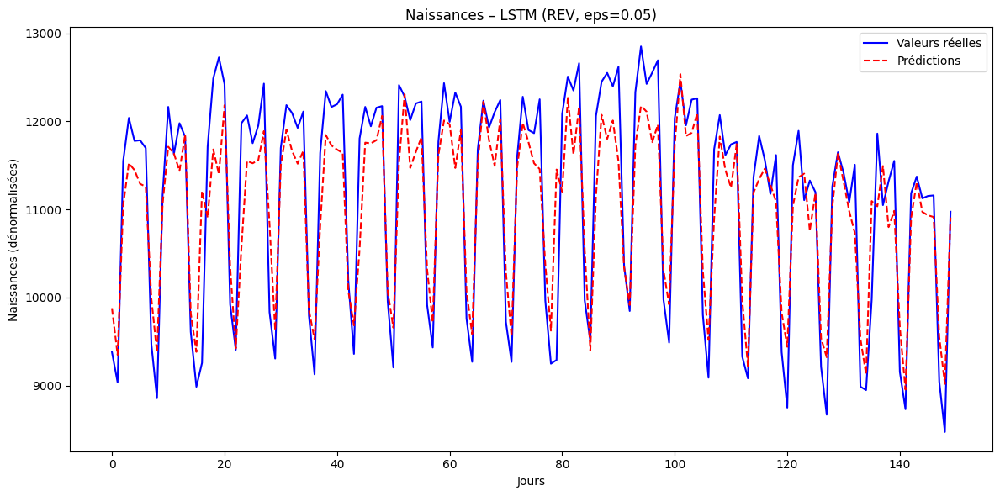

LSTM | REV – Epsilon 0.07 – MAE: 495.2115 | SIM: 0.9986 | RMSE: 607.8246


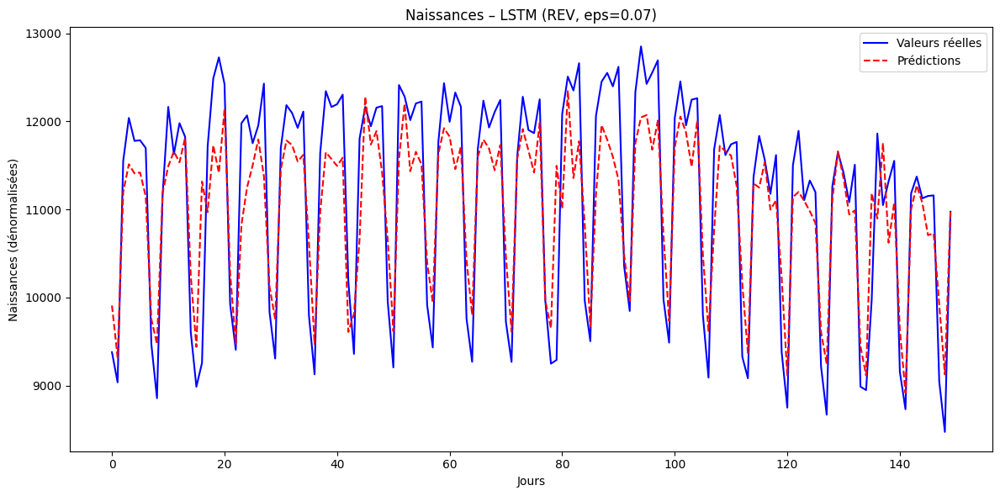

LSTM | REV – Epsilon 0.10 – MAE: 502.1406 | SIM: 0.9985 | RMSE: 631.8163


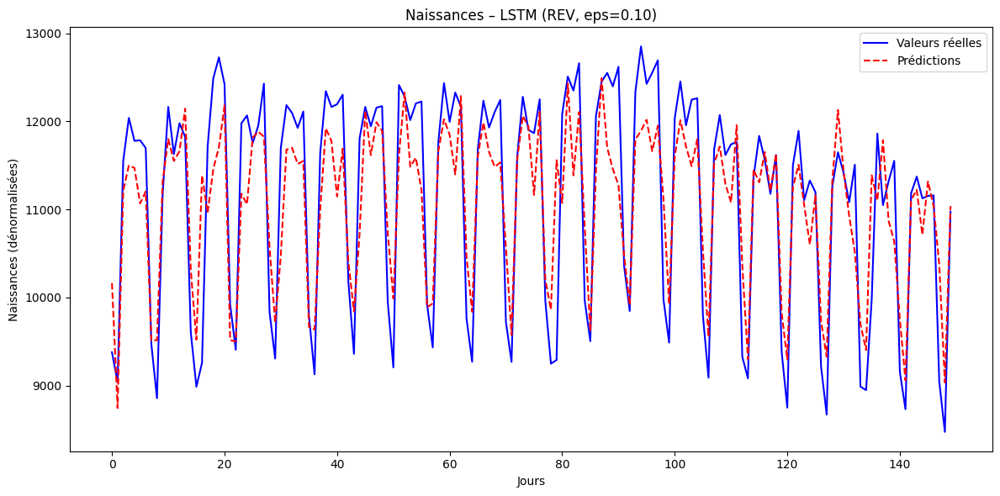

LSTM | REV – Epsilon 0.20 – MAE: 753.4302 | SIM: 0.9963 | RMSE: 962.4193


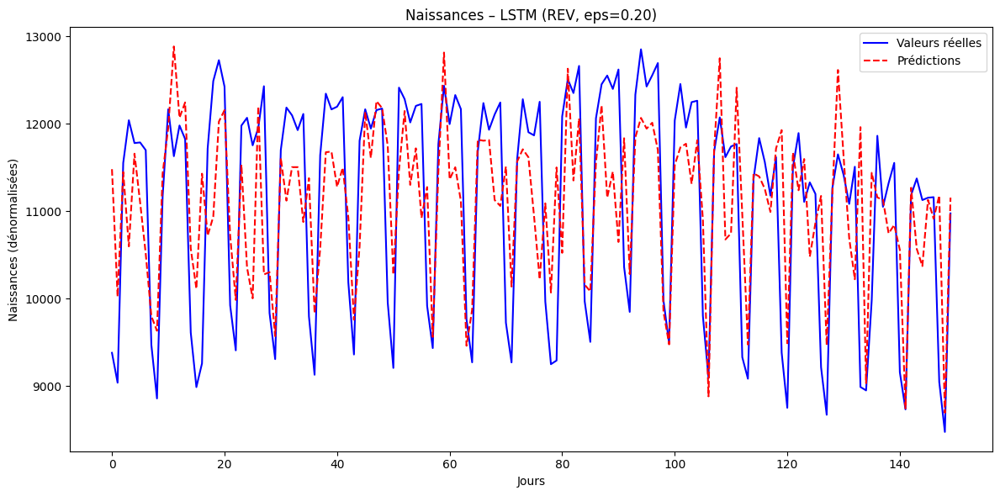

In [ ]:
from attack.rev import reverse_forecast_attack

epsilons = [0.01, 0.02, 0.03, 0.04, 0.05, 0.075, 0.1, 0.2]
results = reverse_forecast_attack(
    model_rev, model,
    test_loader_rev, test_loader,
    epsilons,
    serie_min_rev, serie_max_rev
)

for esp, (true_vals, preds) in results.items():
  log_and_plot_births(
      true_values=true_vals[-days_plot:],
      predictions=preds[-days_plot:],
      model_name='LSTM',
      attack_name='REV',
      epsilon=esp,
      res_tab=res_tab,
      similarity_fn=scalar_similarity,
      save_path=f"results/birth/SEED_{seed}/plots/REV/{esp}",
      save_png=True
  )

In [ ]:
display(res_tab)

Attack                NA        PAST         REV                          \
ε                   0.00        0.00        0.01        0.02        0.03   
Model Metric                                                               
LSTM  MAE     427.817316  328.922987  428.967296  429.811878  433.667491   
      RMSE    529.717237  439.150283  530.587851  533.960743  537.489750   
      SIM       0.999057    0.999335    0.999044    0.999028    0.998981   
RNN   MAE            NaN         NaN         NaN         NaN         NaN   
      RMSE           NaN         NaN         NaN         NaN         NaN   
      SIM            NaN         NaN         NaN         NaN         NaN   
GRU   MAE            NaN         NaN         NaN         NaN         NaN   
      RMSE           NaN         NaN         NaN         NaN         NaN   
      SIM            NaN         NaN         NaN         NaN         NaN   

Attack                                                                    
ε                   0.04        0.05        0.07        0.10        0.20  
Model Metric                                                              
LSTM  MAE     450.732569  433.265869  495.211502  502.140627  753.430234  
      RMSE    552.652235  547.680498  607.824639  631.816271  962.419282  
      SIM       0.998902    0.998901    0.998638    0.998463    0.996317  
RNN   MAE            NaN         NaN         NaN         NaN         NaN  
      RMSE           NaN         NaN         NaN         NaN         NaN  
      SIM            NaN         NaN         NaN         NaN         NaN  
GRU   MAE            NaN         NaN         NaN         NaN         NaN  
      RMSE           NaN         NaN         NaN         NaN         NaN  
      SIM            NaN         NaN         NaN         NaN         NaN

In [ ]:
from models.rnn import SimpleRNN
model_rnn = SimpleRNN(input_size=1, hidden_size=64, output_size=1, num_layers=2)
model_rnn.to(device)
optimizer = torch.optim.Adam(model_rnn.parameters(), lr=0.001)
train_models_elec(model_rnn, loss_fn, optimizer, num_epochs, train_loader,device)

Epoch [1/50], Train Loss: 0.0256
Epoch [2/50], Train Loss: 0.0039
Epoch [3/50], Train Loss: 0.0036
Epoch [4/50], Train Loss: 0.0036
Epoch [5/50], Train Loss: 0.0034
Epoch [6/50], Train Loss: 0.0035
Epoch [7/50], Train Loss: 0.0034
Epoch [8/50], Train Loss: 0.0029
Epoch [9/50], Train Loss: 0.0031
Epoch [10/50], Train Loss: 0.0029
Epoch [11/50], Train Loss: 0.0028
Epoch [12/50], Train Loss: 0.0028
Epoch [13/50], Train Loss: 0.0028
Epoch [14/50], Train Loss: 0.0029
Epoch [15/50], Train Loss: 0.0027
Epoch [16/50], Train Loss: 0.0028
Epoch [17/50], Train Loss: 0.0026
Epoch [18/50], Train Loss: 0.0027
Epoch [19/50], Train Loss: 0.0027
Epoch [20/50], Train Loss: 0.0027
Epoch [21/50], Train Loss: 0.0027
Epoch [22/50], Train Loss: 0.0027
Epoch [23/50], Train Loss: 0.0026
Epoch [24/50], Train Loss: 0.0027
Epoch [25/50], Train Loss: 0.0027
Epoch [26/50], Train Loss: 0.0026
Epoch [27/50], Train Loss: 0.0026
Epoch [28/50], Train Loss: 0.0027
Epoch [29/50], Train Loss: 0.0026
Epoch [30/50], Train Lo

RNN | NA – Epsilon 0.00 – MAE: 453.1777 | SIM: 0.9993 | RMSE: 567.4803


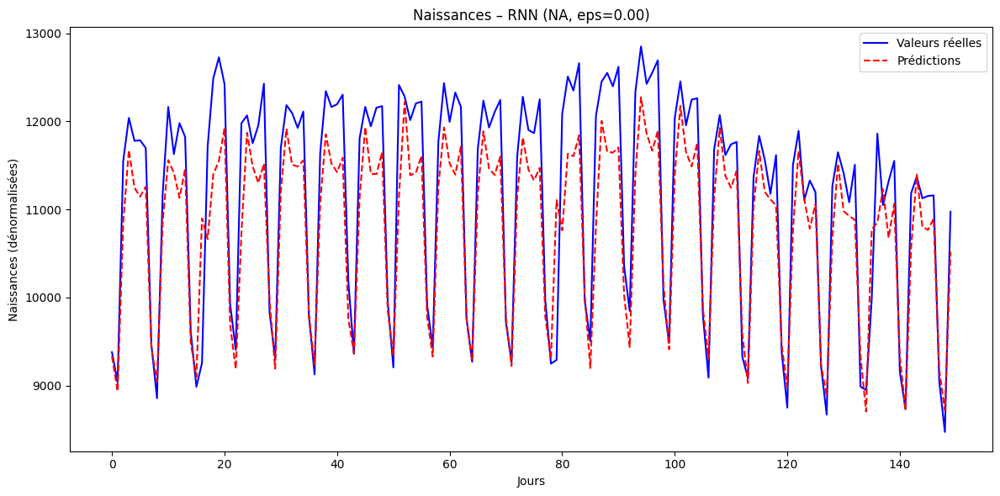

In [ ]:
results_rnn = evaluate_model_births(model_rnn, test_loader, dates, train_size)

real_values_rnn = results_rnn['real_values']
predicted_values_rnn = results_rnn['predicted_values']
test_dates_rnn = results_rnn['test_dates']

true_values_denorm_rnn = real_values_rnn * (serie_max - serie_min) + serie_min
predictions_denorm_rnn = predicted_values_rnn * (serie_max - serie_min) + serie_min

log_and_plot_births(
    true_values=true_values_denorm_rnn[-days_plot:],
    predictions=predictions_denorm_rnn[-days_plot:],
    model_name='RNN',
    attack_name='NA',
    epsilon=0.00,
    res_tab=res_tab,
    similarity_fn=scalar_similarity,
    save_path=f"results/birth/SEED_{seed}/plots/PAST/0",
    save_png=True
)

In [ ]:
model_rnn_rev = SimpleRNN(input_size=1, hidden_size=64, output_size=1, num_layers=2)
model_rnn_rev.to(device)
optimizer = torch.optim.Adam(model_rnn_rev.parameters(), lr=0.001)
train_models_elec(model_rnn_rev, loss_fn, optimizer, num_epochs, train_loader_rev,device)

Epoch [1/50], Train Loss: 0.0258
Epoch [2/50], Train Loss: 0.0071
Epoch [3/50], Train Loss: 0.0037
Epoch [4/50], Train Loss: 0.0035
Epoch [5/50], Train Loss: 0.0033
Epoch [6/50], Train Loss: 0.0034
Epoch [7/50], Train Loss: 0.0032
Epoch [8/50], Train Loss: 0.0033
Epoch [9/50], Train Loss: 0.0033
Epoch [10/50], Train Loss: 0.0031
Epoch [11/50], Train Loss: 0.0030
Epoch [12/50], Train Loss: 0.0029
Epoch [13/50], Train Loss: 0.0029
Epoch [14/50], Train Loss: 0.0029
Epoch [15/50], Train Loss: 0.0027
Epoch [16/50], Train Loss: 0.0027
Epoch [17/50], Train Loss: 0.0028
Epoch [18/50], Train Loss: 0.0028
Epoch [19/50], Train Loss: 0.0027
Epoch [20/50], Train Loss: 0.0028
Epoch [21/50], Train Loss: 0.0025
Epoch [22/50], Train Loss: 0.0027
Epoch [23/50], Train Loss: 0.0026
Epoch [24/50], Train Loss: 0.0027
Epoch [25/50], Train Loss: 0.0026
Epoch [26/50], Train Loss: 0.0026
Epoch [27/50], Train Loss: 0.0026
Epoch [28/50], Train Loss: 0.0026
Epoch [29/50], Train Loss: 0.0027
Epoch [30/50], Train Lo

RNN | PAST – Epsilon 0.00 – MAE: 317.2469 | SIM: 0.9992 | RMSE: 450.2184


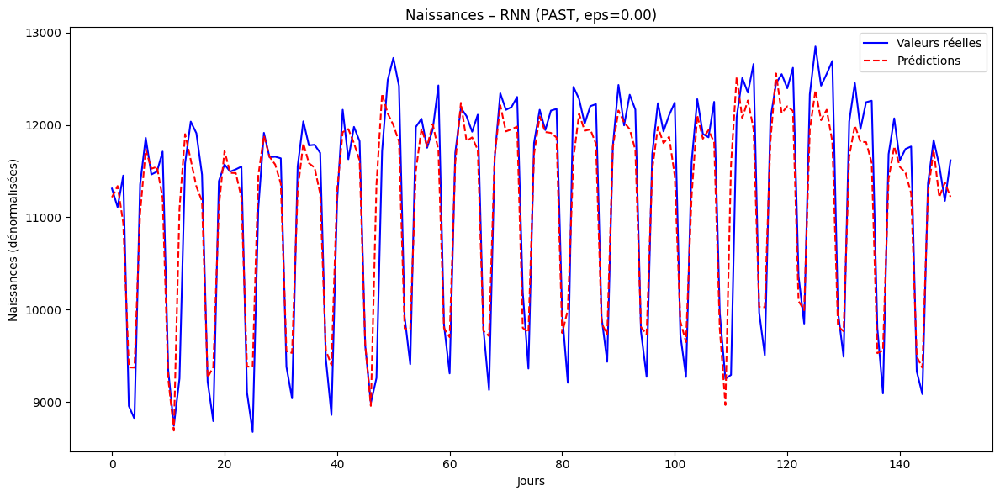

In [ ]:
results_rev_rnn = evaluate_model_births(model_rnn_rev, test_loader_rev, dates_rev, train_size_rev)

real_values_rev_rnn = results_rev_rnn['real_values']
predicted_values_rev_rnn = results_rev_rnn['predicted_values']
test_dates_rev_rnn = results_rev_rnn['test_dates']

true_values_denorm_rev_rnn = real_values_rev_rnn * (serie_max_rev - serie_min_rev) + serie_min_rev
predictions_denorm_rev_rnn = predicted_values_rev_rnn * (serie_max_rev - serie_min_rev) + serie_min_rev

log_and_plot_births(
    true_values=true_values_denorm_rev_rnn[-days_plot:],
    predictions=predictions_denorm_rev_rnn[-days_plot:],
    model_name='RNN',
    attack_name='PAST',
    epsilon=0.00,
    res_tab=res_tab,
    similarity_fn=scalar_similarity,
    save_path=f"results/birth/SEED_{seed}/plots/PAST/0",
    save_png=True
)

RNN | REV – Epsilon 0.01 – MAE: 455.1220 | SIM: 0.9993 | RMSE: 570.4099


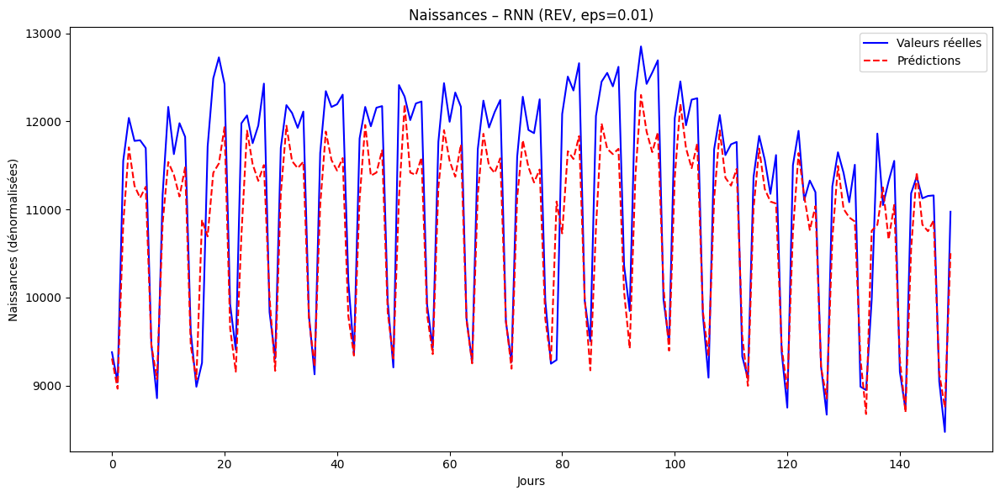

RNN | REV – Epsilon 0.02 – MAE: 458.4795 | SIM: 0.9993 | RMSE: 574.5665


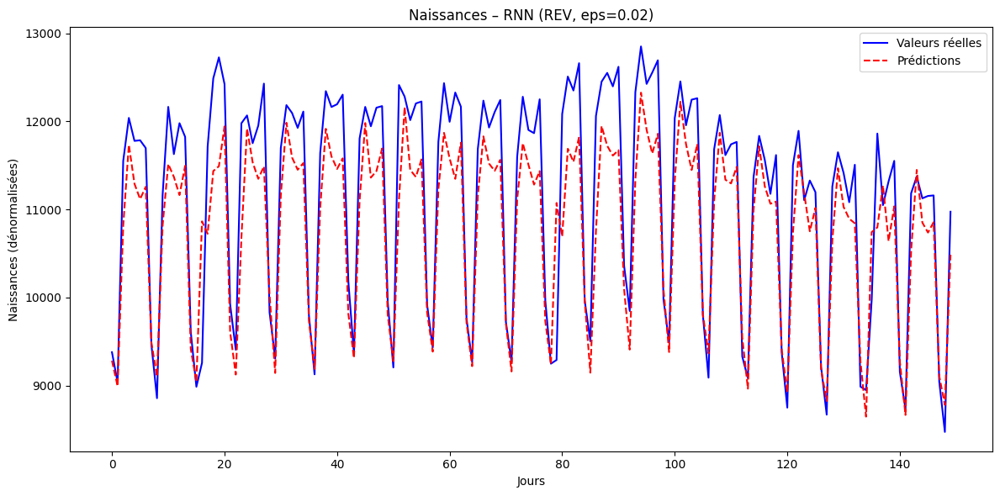

RNN | REV – Epsilon 0.03 – MAE: 463.5901 | SIM: 0.9993 | RMSE: 580.2492


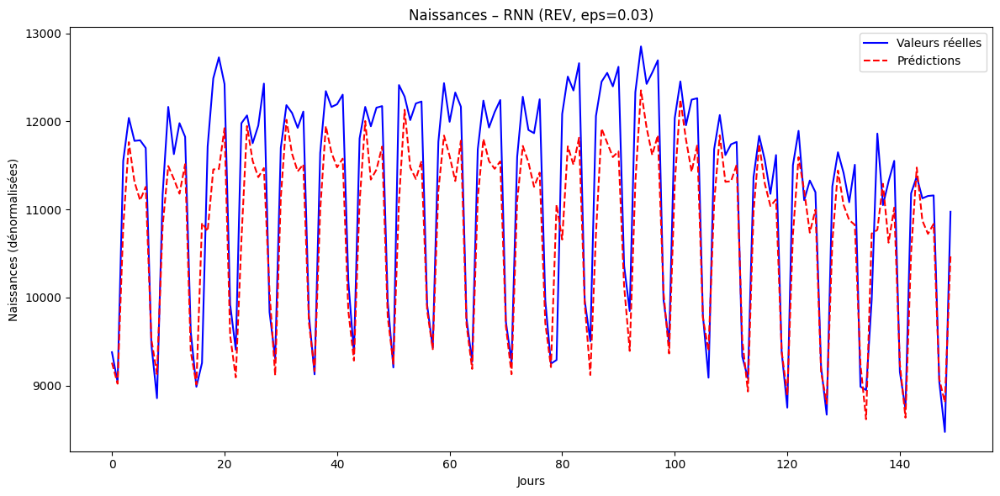

RNN | REV – Epsilon 0.04 – MAE: 469.4622 | SIM: 0.9992 | RMSE: 587.2069


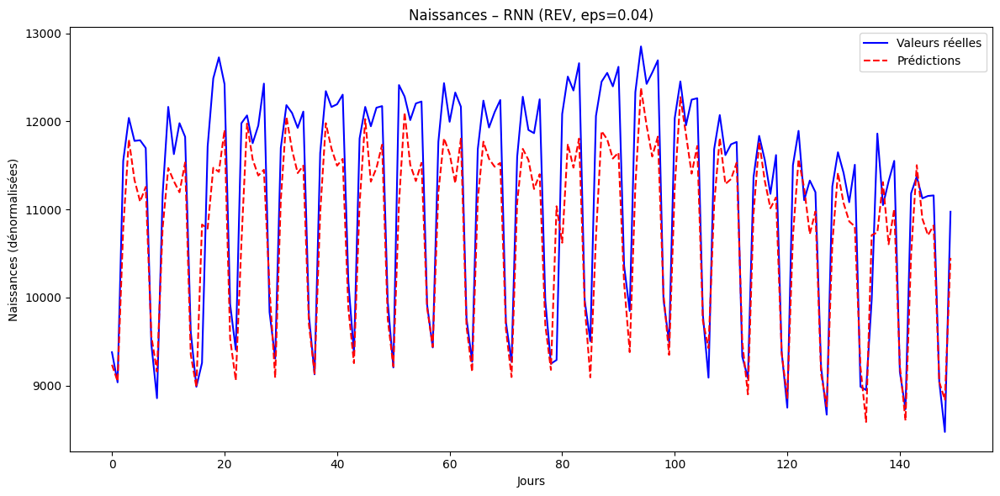

RNN | REV – Epsilon 0.05 – MAE: 477.2981 | SIM: 0.9992 | RMSE: 595.4949


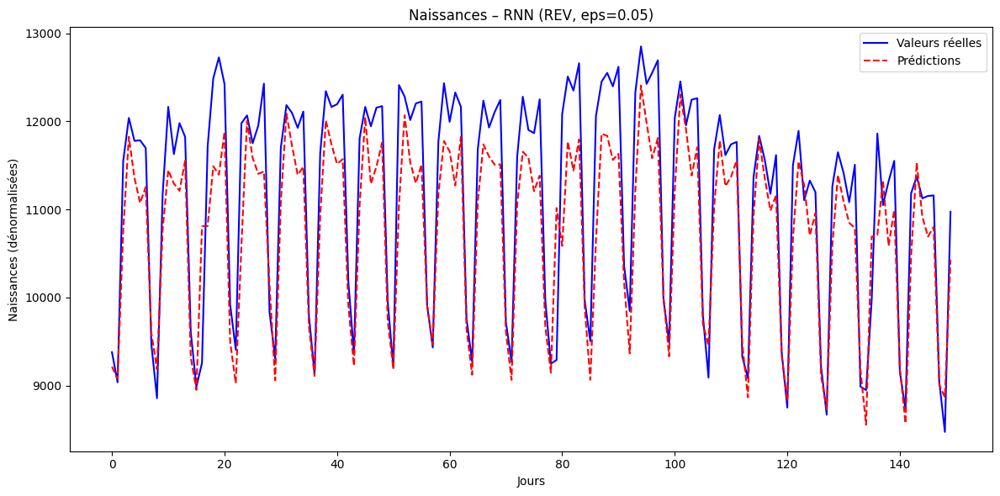

RNN | REV – Epsilon 0.07 – MAE: 502.6775 | SIM: 0.9992 | RMSE: 623.0501


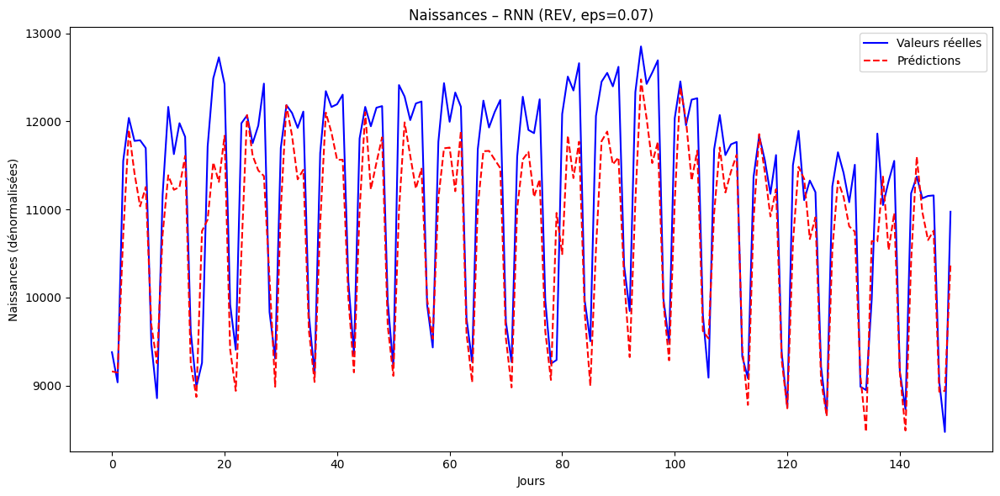

RNN | REV – Epsilon 0.10 – MAE: 538.2687 | SIM: 0.9990 | RMSE: 660.7166


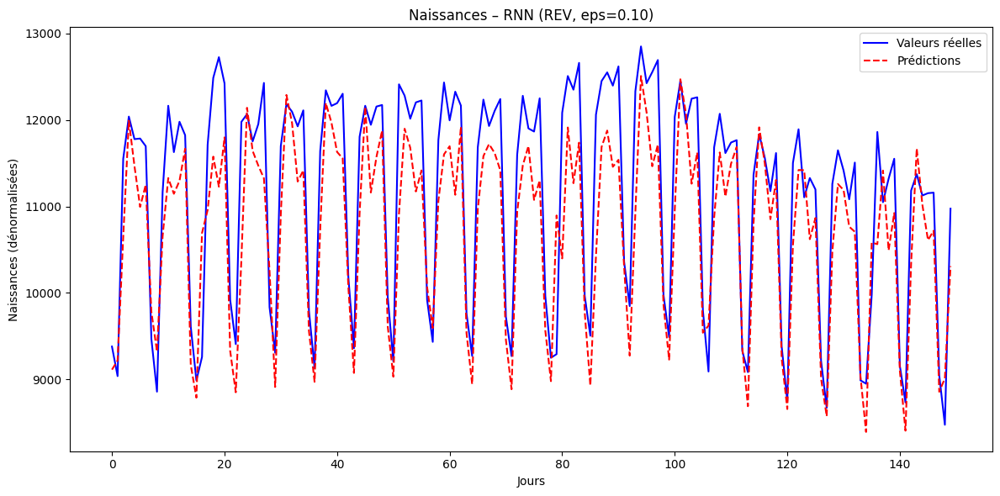

RNN | REV – Epsilon 0.20 – MAE: 770.1766 | SIM: 0.9980 | RMSE: 915.7481


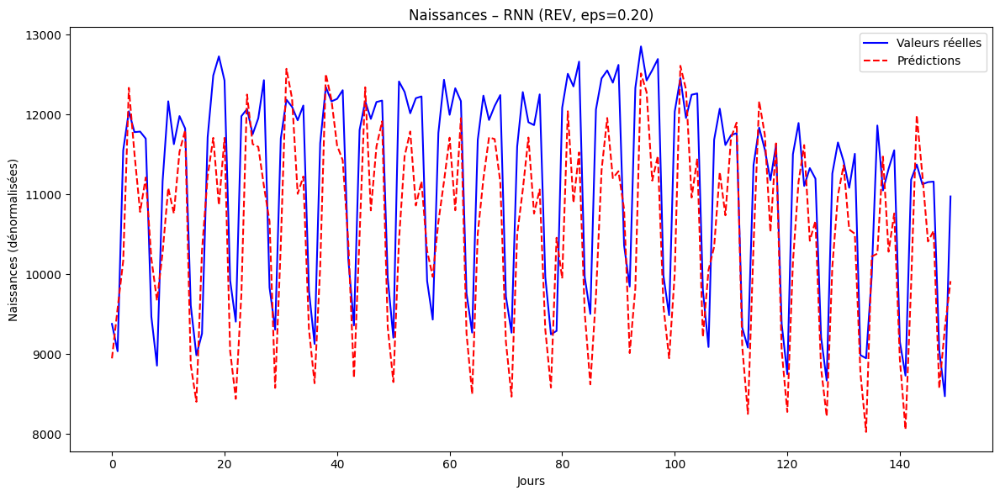

In [ ]:
results = reverse_forecast_attack(
    model_rnn_rev, model_rnn,
    test_loader_rev, test_loader,
    epsilons,
    serie_min_rev, serie_max_rev
)

for esp, (true_vals, preds) in results.items():
  log_and_plot_births(
      true_values=true_vals[-days_plot:],
      predictions=preds[-days_plot:],
      model_name='RNN',
      attack_name='REV',
      epsilon=esp,
      res_tab=res_tab,
      similarity_fn=scalar_similarity,
      save_path=f"results/birth/SEED_{seed}/plots/REV/{esp}",
      save_png=True
  )

In [ ]:
from models.gru import SimpleGRU
model_gru = SimpleGRU(input_size=1, hidden_size=64, output_size=1, num_layers=2)
model_gru.to(device)
optimizer = torch.optim.Adam(model_gru.parameters(), lr=0.001)
train_models_elec(model_gru, loss_fn, optimizer, num_epochs, train_loader,device)

Epoch [1/50], Train Loss: 0.0348
Epoch [2/50], Train Loss: 0.0167
Epoch [3/50], Train Loss: 0.0143
Epoch [4/50], Train Loss: 0.0108
Epoch [5/50], Train Loss: 0.0097
Epoch [6/50], Train Loss: 0.0077
Epoch [7/50], Train Loss: 0.0044
Epoch [8/50], Train Loss: 0.0035
Epoch [9/50], Train Loss: 0.0034
Epoch [10/50], Train Loss: 0.0032
Epoch [11/50], Train Loss: 0.0031
Epoch [12/50], Train Loss: 0.0030
Epoch [13/50], Train Loss: 0.0029
Epoch [14/50], Train Loss: 0.0028
Epoch [15/50], Train Loss: 0.0028
Epoch [16/50], Train Loss: 0.0026
Epoch [17/50], Train Loss: 0.0026
Epoch [18/50], Train Loss: 0.0026
Epoch [19/50], Train Loss: 0.0026
Epoch [20/50], Train Loss: 0.0026
Epoch [21/50], Train Loss: 0.0025
Epoch [22/50], Train Loss: 0.0025
Epoch [23/50], Train Loss: 0.0025
Epoch [24/50], Train Loss: 0.0025
Epoch [25/50], Train Loss: 0.0025
Epoch [26/50], Train Loss: 0.0025
Epoch [27/50], Train Loss: 0.0025
Epoch [28/50], Train Loss: 0.0025
Epoch [29/50], Train Loss: 0.0025
Epoch [30/50], Train Lo

GRU | NA – Epsilon 0.00 – MAE: 268.1705 | SIM: 0.9994 | RMSE: 397.7447


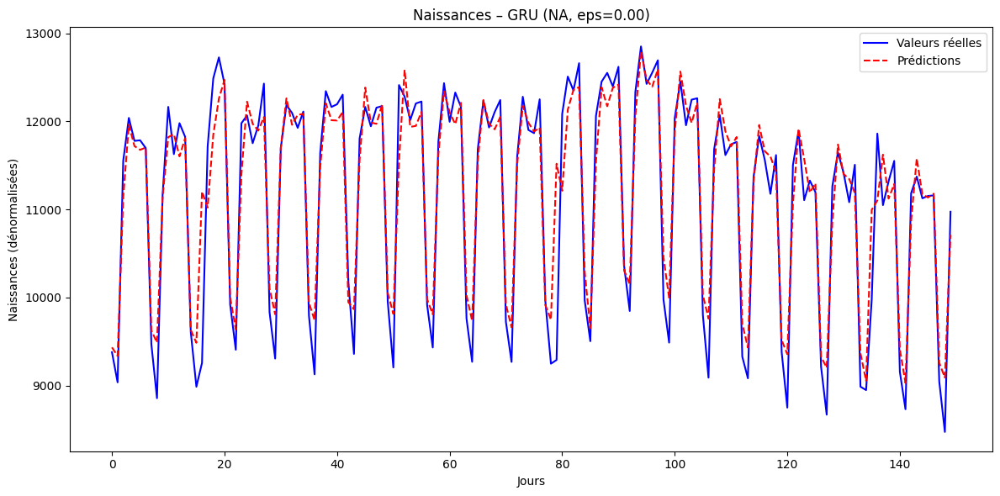

In [ ]:
results_gru = evaluate_model_births(model_gru, test_loader, dates, train_size)

real_values_gru = results_gru['real_values']
predicted_values_gru = results_gru['predicted_values']
test_dates_gru = results_gru['test_dates']

true_values_denorm_gru = real_values_gru * (serie_max - serie_min) + serie_min
predictions_denorm_gru = predicted_values_gru * (serie_max - serie_min) + serie_min

log_and_plot_births(
    true_values=true_values_denorm_gru[-days_plot:],
    predictions=predictions_denorm_gru[-days_plot:],
    model_name='GRU',
    attack_name='NA',
    epsilon=0.00,
    res_tab=res_tab,
    similarity_fn=scalar_similarity,
    save_path=f"results/birth/SEED_{seed}/plots/PAST/0",
    save_png=True
)

In [ ]:
model_gru_rev = SimpleGRU(input_size=1, hidden_size=64, output_size=1, num_layers=2)
model_gru_rev.to(device)
optimizer = torch.optim.Adam(model_gru_rev.parameters(), lr=0.001)
train_models_elec(model_gru_rev, loss_fn, optimizer, num_epochs, train_loader_rev,device)

Epoch [1/50], Train Loss: 0.0373
Epoch [2/50], Train Loss: 0.0161
Epoch [3/50], Train Loss: 0.0137
Epoch [4/50], Train Loss: 0.0110
Epoch [5/50], Train Loss: 0.0090
Epoch [6/50], Train Loss: 0.0066
Epoch [7/50], Train Loss: 0.0039
Epoch [8/50], Train Loss: 0.0034
Epoch [9/50], Train Loss: 0.0032
Epoch [10/50], Train Loss: 0.0032
Epoch [11/50], Train Loss: 0.0032
Epoch [12/50], Train Loss: 0.0031
Epoch [13/50], Train Loss: 0.0031
Epoch [14/50], Train Loss: 0.0032
Epoch [15/50], Train Loss: 0.0031
Epoch [16/50], Train Loss: 0.0031
Epoch [17/50], Train Loss: 0.0033
Epoch [18/50], Train Loss: 0.0030
Epoch [19/50], Train Loss: 0.0030
Epoch [20/50], Train Loss: 0.0030
Epoch [21/50], Train Loss: 0.0030
Epoch [22/50], Train Loss: 0.0031
Epoch [23/50], Train Loss: 0.0030
Epoch [24/50], Train Loss: 0.0031
Epoch [25/50], Train Loss: 0.0029
Epoch [26/50], Train Loss: 0.0028
Epoch [27/50], Train Loss: 0.0029
Epoch [28/50], Train Loss: 0.0029
Epoch [29/50], Train Loss: 0.0028
Epoch [30/50], Train Lo

GRU | PAST – Epsilon 0.00 – MAE: 333.2415 | SIM: 0.9993 | RMSE: 456.6416


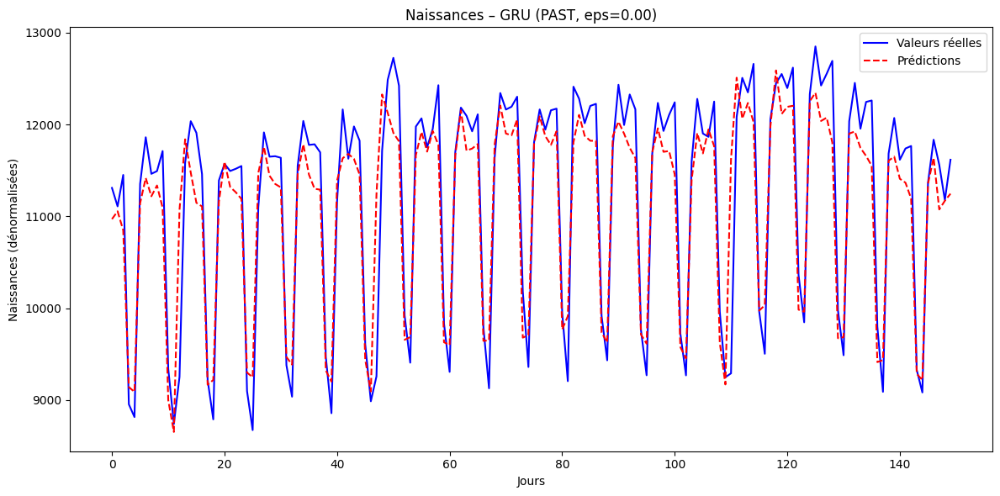

In [ ]:
results_rev_gru = evaluate_model_births(model_gru_rev, test_loader_rev, dates_rev, train_size_rev)

real_values_rev_gru = results_rev_gru['real_values']
predicted_values_rev_gru = results_rev_gru['predicted_values']
test_dates_rev_gru = results_rev_gru['test_dates']

true_values_denorm_rev_gru = real_values_rev_gru * (serie_max_rev - serie_min_rev) + serie_min_rev
predictions_denorm_rev_gru = predicted_values_rev_gru * (serie_max_rev - serie_min_rev) + serie_min_rev

log_and_plot_births(
    true_values=true_values_denorm_rev_gru[-days_plot:],
    predictions=predictions_denorm_rev_gru[-days_plot:],
    model_name='GRU',
    attack_name='PAST',
    epsilon=0.00,
    res_tab=res_tab,
    similarity_fn=scalar_similarity,
    save_path=f"results/birth/SEED_{seed}/plots/PAST/0",
    save_png=True
)

GRU | REV – Epsilon 0.01 – MAE: 451.4738 | SIM: 0.9993 | RMSE: 566.5635


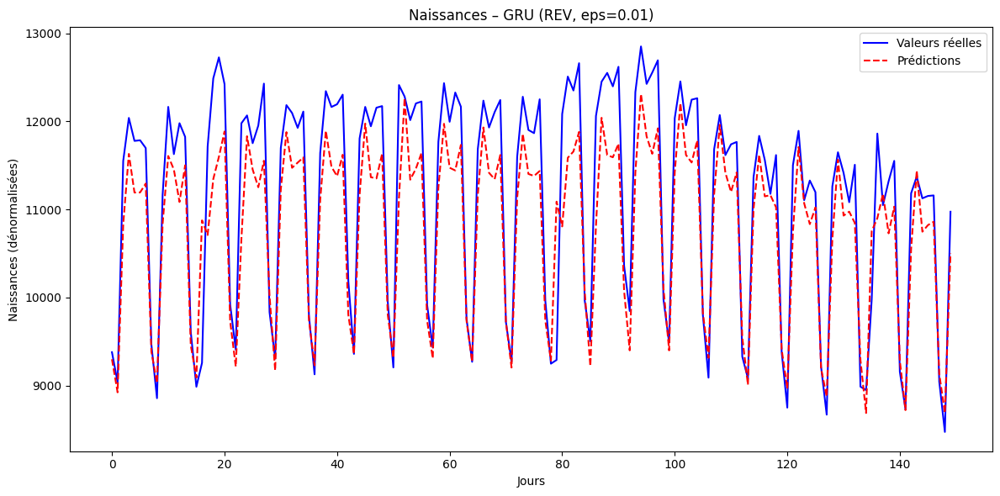

GRU | REV – Epsilon 0.02 – MAE: 452.6663 | SIM: 0.9993 | RMSE: 568.5173


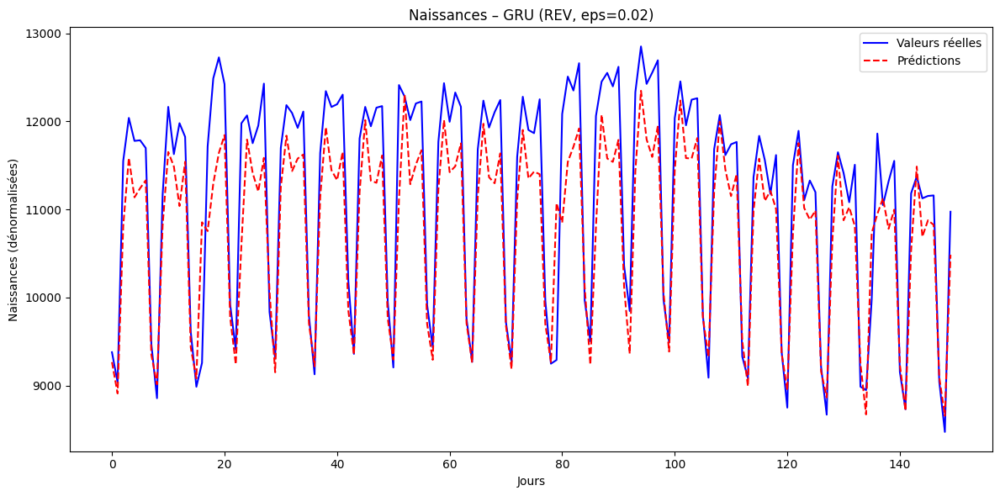

GRU | REV – Epsilon 0.03 – MAE: 455.5256 | SIM: 0.9993 | RMSE: 573.4742


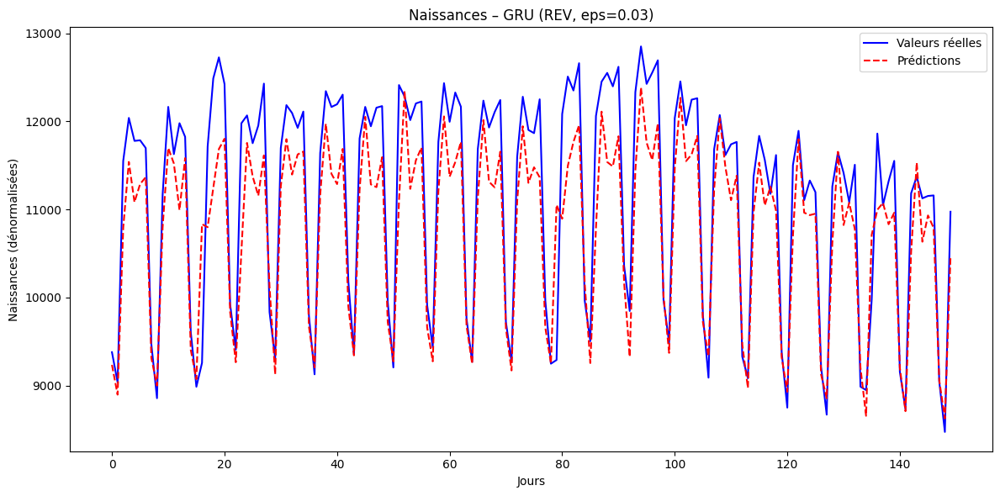

GRU | REV – Epsilon 0.04 – MAE: 460.6080 | SIM: 0.9993 | RMSE: 581.2872


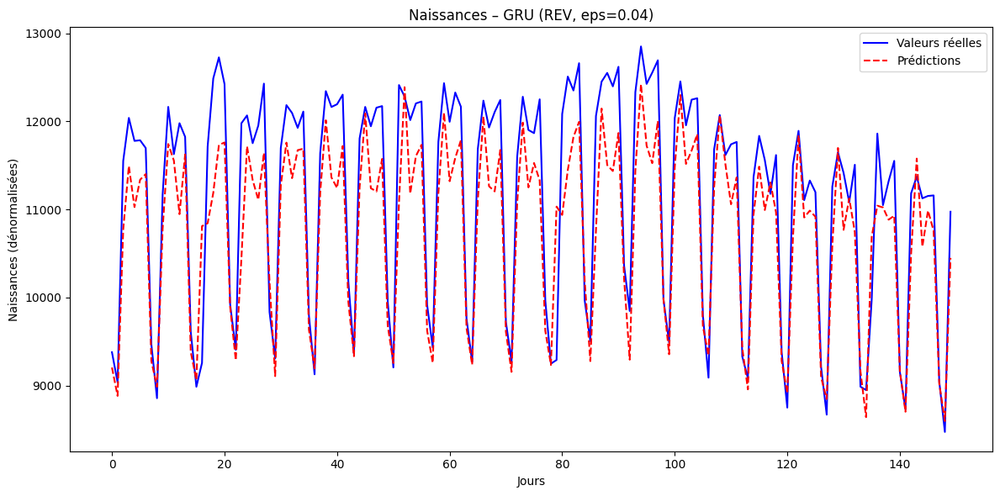

GRU | REV – Epsilon 0.05 – MAE: 468.5681 | SIM: 0.9992 | RMSE: 591.9752


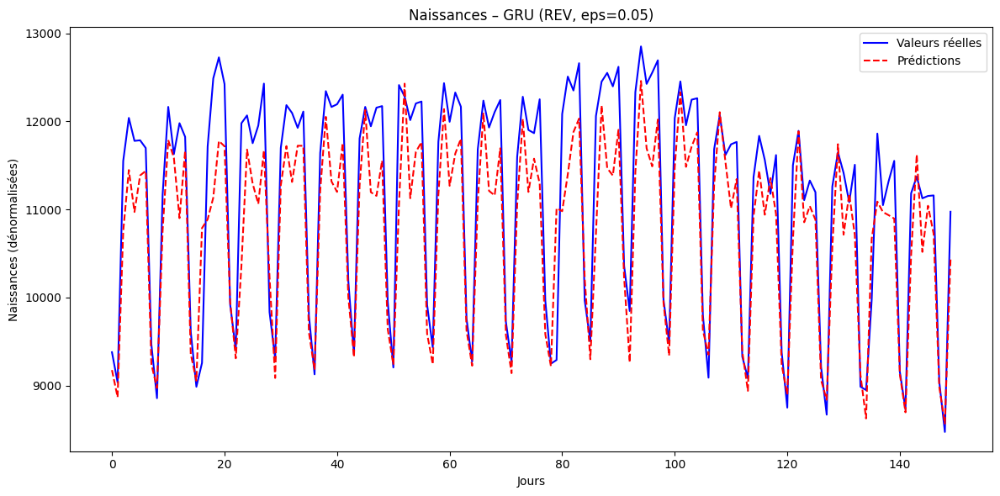

GRU | REV – Epsilon 0.07 – MAE: 496.7431 | SIM: 0.9991 | RMSE: 630.8218


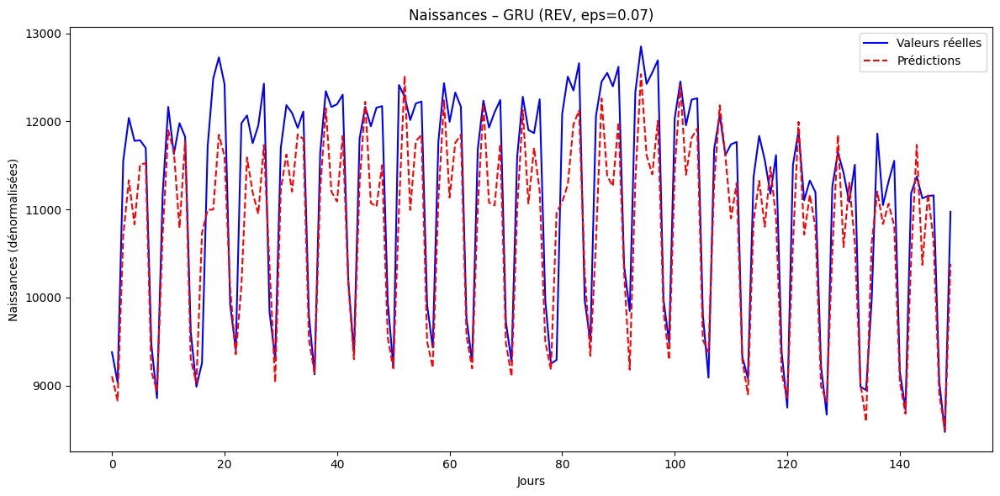

GRU | REV – Epsilon 0.10 – MAE: 540.2027 | SIM: 0.9989 | RMSE: 685.5136


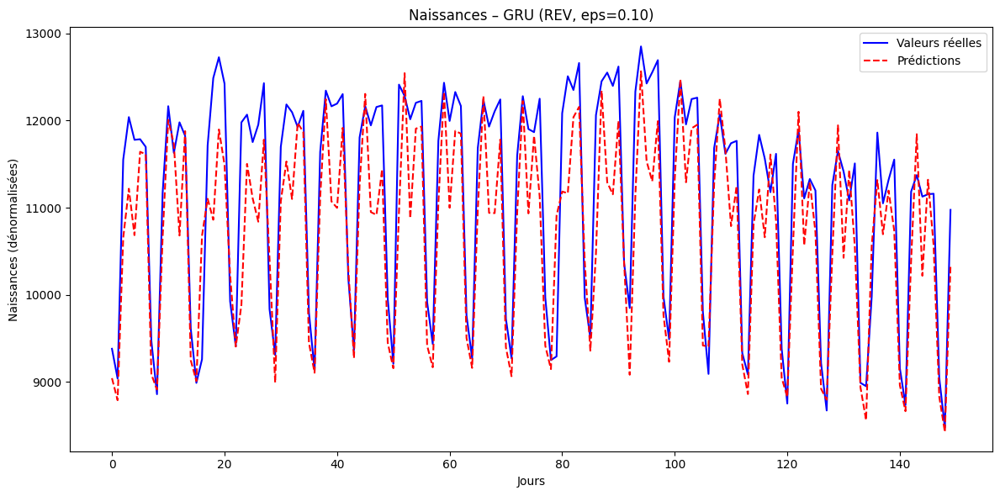

GRU | REV – Epsilon 0.20 – MAE: 816.3768 | SIM: 0.9974 | RMSE: 993.1549


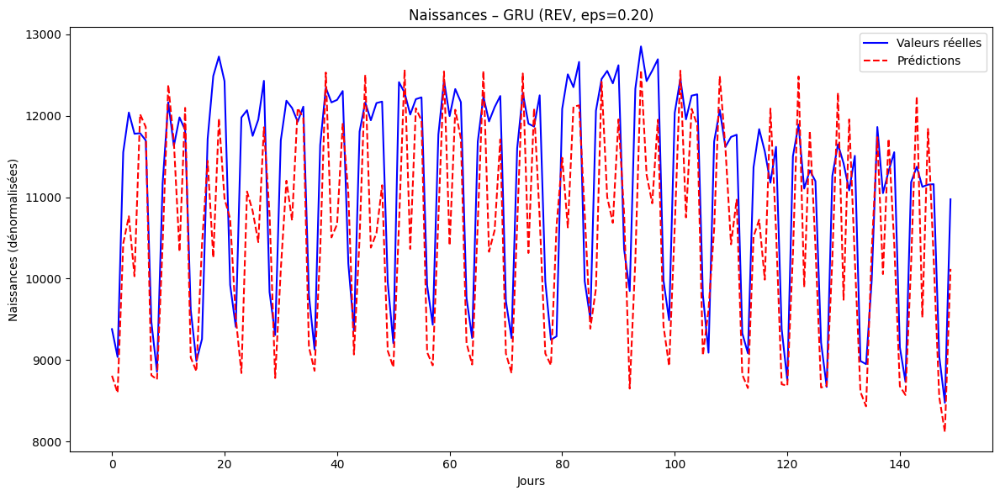

In [ ]:
results = reverse_forecast_attack(
    model_gru_rev, model_rnn,
    test_loader_rev, test_loader,
    epsilons,
    serie_min_rev, serie_max_rev
)

for esp, (true_vals, preds) in results.items():
  log_and_plot_births(
      true_values=true_vals[-days_plot:],
      predictions=preds[-days_plot:],
      model_name='GRU',
      attack_name='REV',
      epsilon=esp,
      res_tab=res_tab,
      similarity_fn=scalar_similarity,
      save_path=f"results/birth/SEED_{seed}/plots/REV/{esp}",
      save_png=True
  )

In [ ]:
display(res_tab)

Attack                NA        PAST         REV                          \
ε                   0.00        0.00        0.01        0.02        0.03   
Model Metric                                                               
LSTM  MAE     427.817316  328.922987  428.967296  429.811878  433.667491   
      RMSE    529.717237  439.150283  530.587851  533.960743  537.489750   
      SIM       0.999057    0.999335    0.999044    0.999028    0.998981   
RNN   MAE     453.177722  317.246896  455.122041  458.479528  463.590075   
      RMSE    567.480292  450.218435  570.409911  574.566491  580.249171   
      SIM       0.999266    0.999224    0.999270    0.999268    0.999261   
GRU   MAE     268.170518  333.241523  451.473848  452.666331  455.525579   
      RMSE    397.744667  456.641566  566.563518  568.517340  573.474159   
      SIM       0.999376    0.999255    0.999283    0.999287    0.999277   

Attack                                                                    
ε                   0.04        0.05        0.07        0.10        0.20  
Model Metric                                                              
LSTM  MAE     450.732569  433.265869  495.211502  502.140627  753.430234  
      RMSE    552.652235  547.680498  607.824639  631.816271  962.419282  
      SIM       0.998902    0.998901    0.998638    0.998463    0.996317  
RNN   MAE     469.462190  477.298076  502.677460  538.268650  770.176554  
      RMSE    587.206857  595.494915  623.050059  660.716555  915.748121  
      SIM       0.999247    0.999228    0.999151    0.999032    0.997999  
GRU   MAE     460.607980  468.568124  496.743084  540.202739  816.376805  
      RMSE    581.287198  591.975200  630.821837  685.513595  993.154934  
      SIM       0.999255    0.999220    0.999077    0.998860    0.997355

In [ ]:
from attack.fgsm import fgsm_attack

In [ ]:
# Creation of the tab result for plotting adversial attack result
models = ['LSTM','RNN','GRU']
metrics = ['MAE', "RMSE", 'SIM']

row_index = pd.MultiIndex.from_product([models, metrics], names=['Model', 'Metric'])

attacks = ['FGSM']
epsilons_attack = {
    'FGSM':[0.01, 0.02, 0.03, 0.04, 0.05, 0.075, 0.1, 0.2],
}

col_tuples = []
for atk, eps_list in epsilons_attack.items():
    for eps in eps_list:
        col_tuples.append((atk, f"{eps:.2f}"))

col_index = pd.MultiIndex.from_tuples(col_tuples, names=['Attack', 'ε'])

res_tab_fgsm = pd.DataFrame(index=row_index, columns=col_index, dtype=float)

print(res_tab_fgsm)

Attack       FGSM                                   
ε            0.01 0.02 0.03 0.04 0.05 0.07 0.10 0.20
Model Metric                                        
LSTM  MAE     NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      RMSE    NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      SIM     NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
RNN   MAE     NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      RMSE    NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      SIM     NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
GRU   MAE     NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      RMSE    NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      SIM     NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN


GRU | FGSM – Epsilon 0.01 – MAE: 351.4855 | SIM: 0.9992 | RMSE: 457.5300


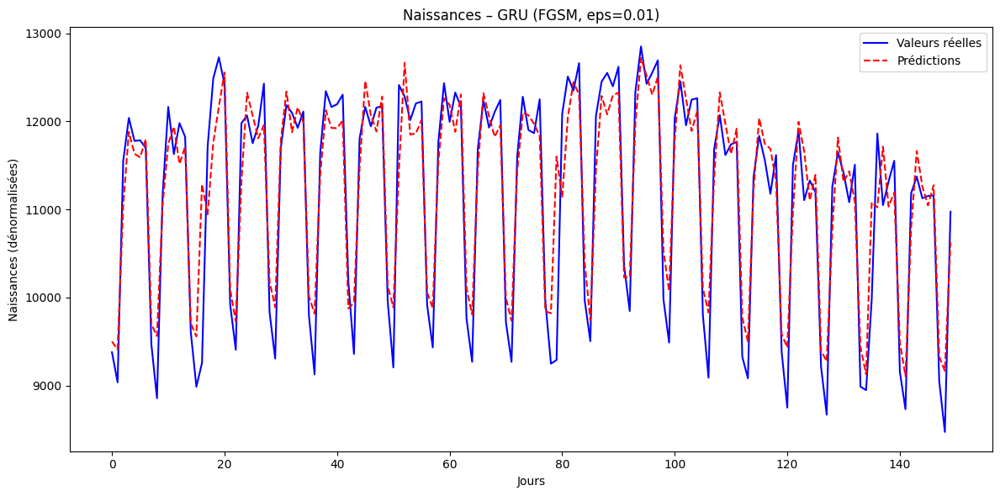

LSTM | FGSM – Epsilon 0.01 – MAE: 532.6108 | SIM: 0.9987 | RMSE: 625.2204


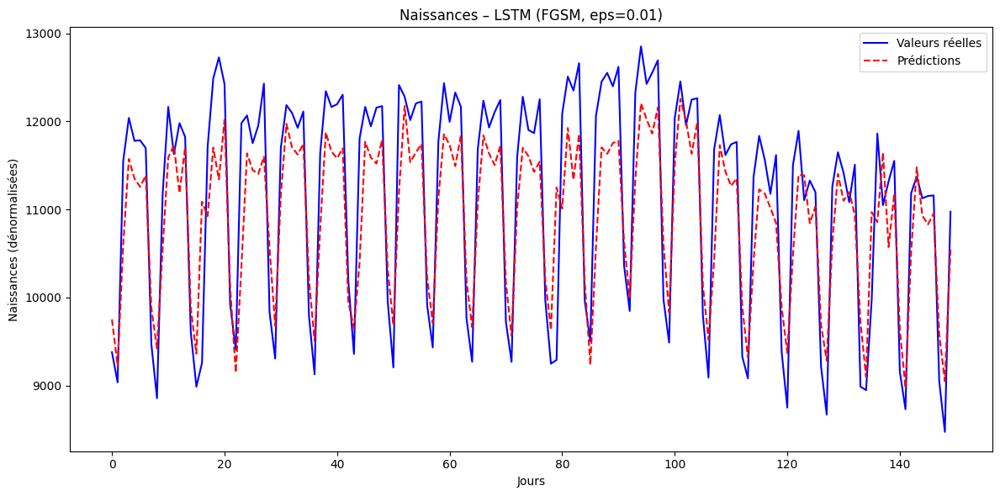

RNN | FGSM – Epsilon 0.01 – MAE: 525.0131 | SIM: 0.9991 | RMSE: 625.8254


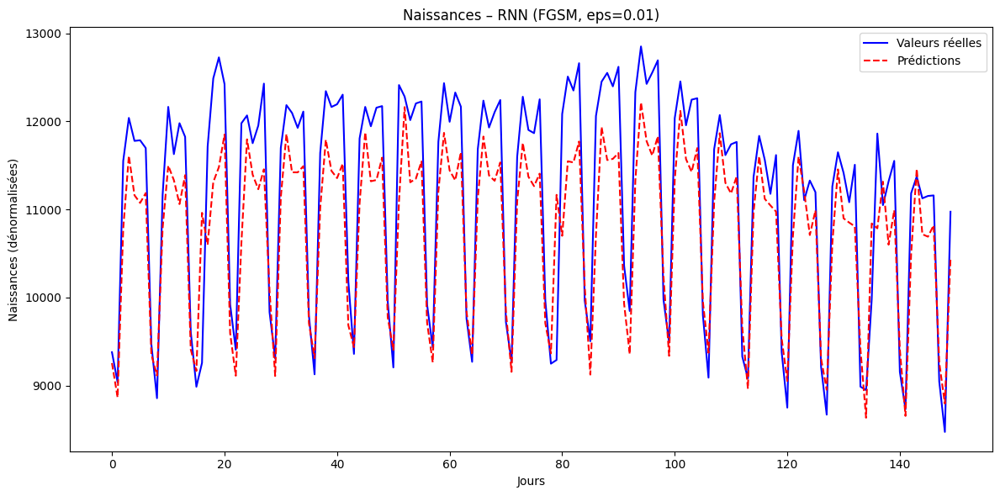

GRU | FGSM – Epsilon 0.02 – MAE: 435.5518 | SIM: 0.9989 | RMSE: 524.5519


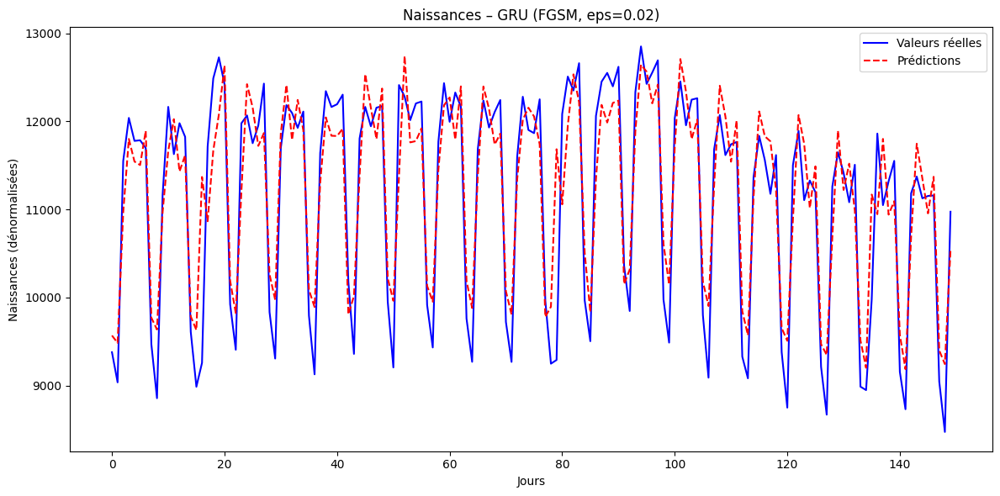

LSTM | FGSM – Epsilon 0.02 – MAE: 640.5256 | SIM: 0.9982 | RMSE: 730.1852


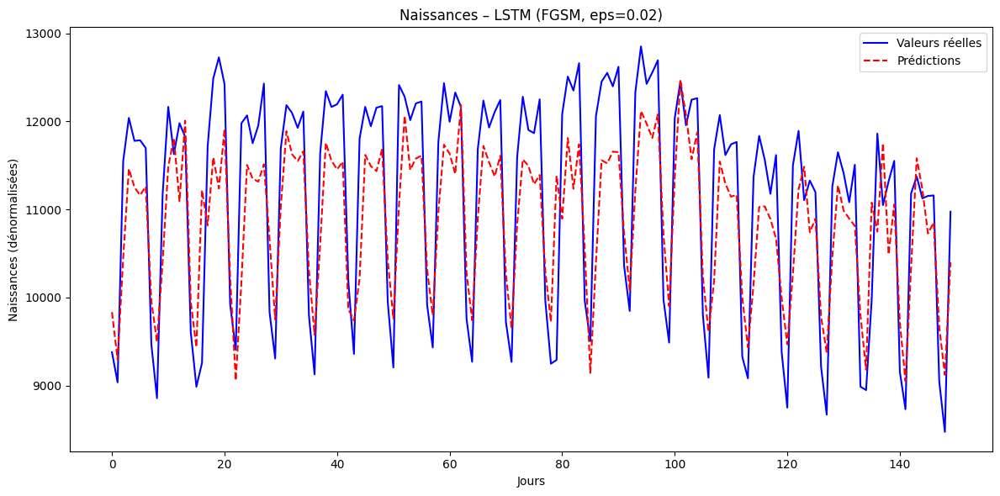

RNN | FGSM – Epsilon 0.02 – MAE: 597.6508 | SIM: 0.9989 | RMSE: 687.7416


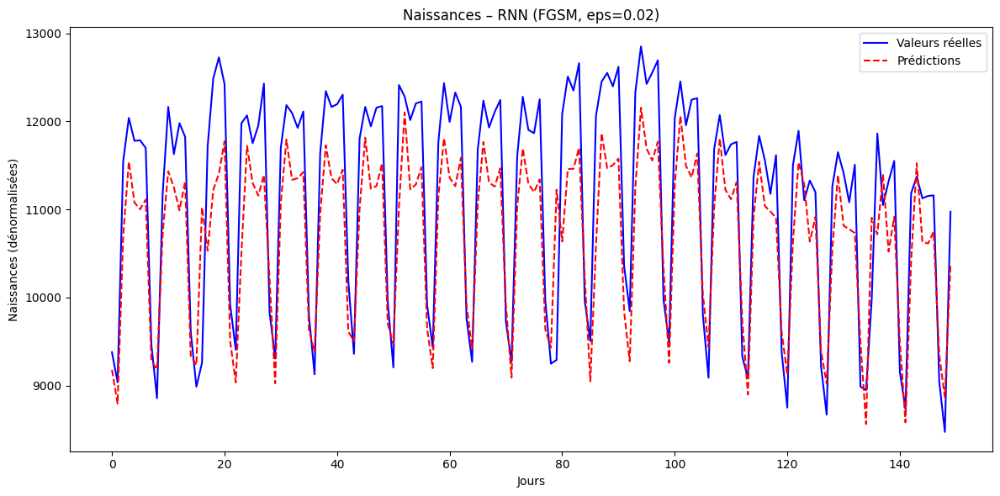

GRU | FGSM – Epsilon 0.03 – MAE: 519.9574 | SIM: 0.9986 | RMSE: 596.4227


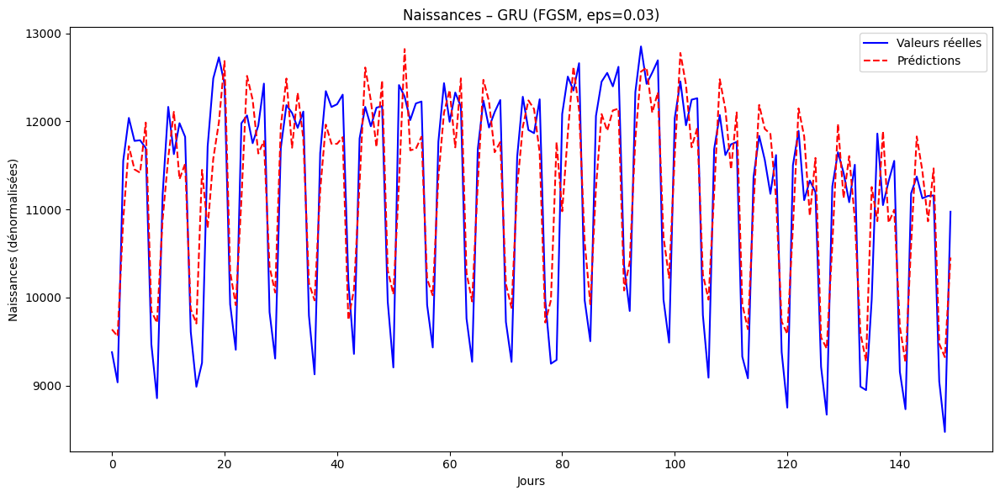

LSTM | FGSM – Epsilon 0.03 – MAE: 762.1850 | SIM: 0.9977 | RMSE: 844.5778


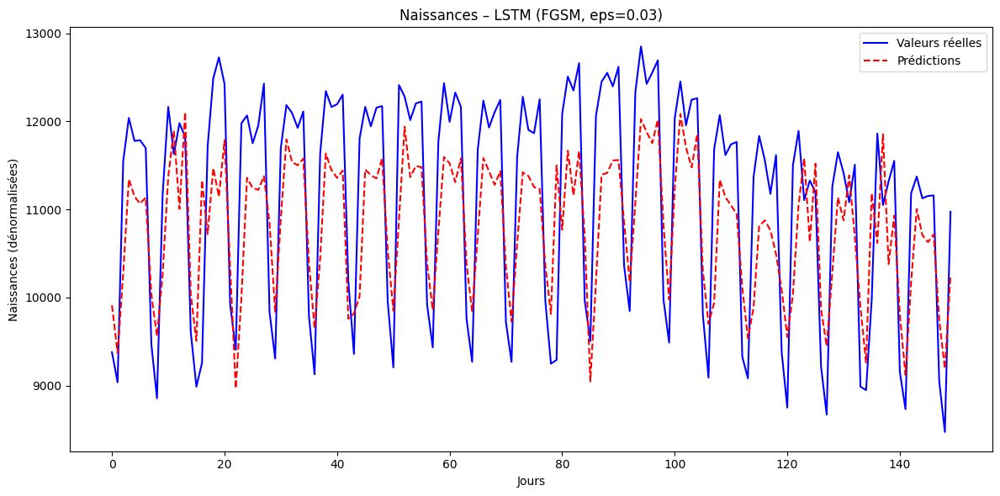

RNN | FGSM – Epsilon 0.03 – MAE: 670.9636 | SIM: 0.9987 | RMSE: 752.5689


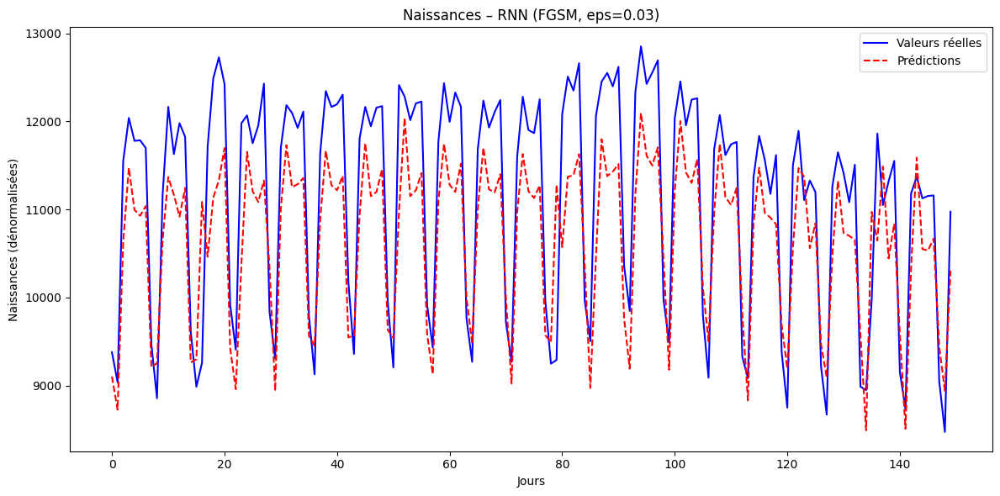

GRU | FGSM – Epsilon 0.04 – MAE: 604.7859 | SIM: 0.9982 | RMSE: 671.7306


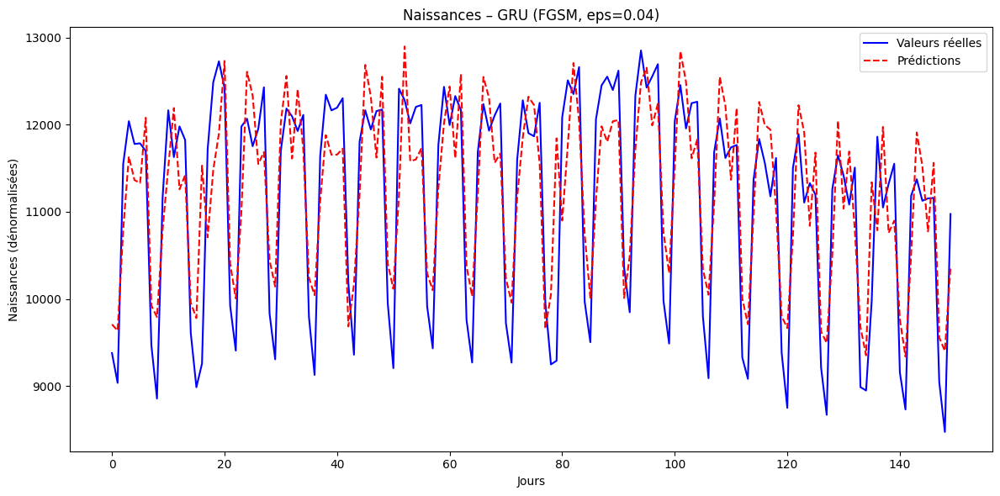

LSTM | FGSM – Epsilon 0.04 – MAE: 877.1385 | SIM: 0.9970 | RMSE: 961.7492


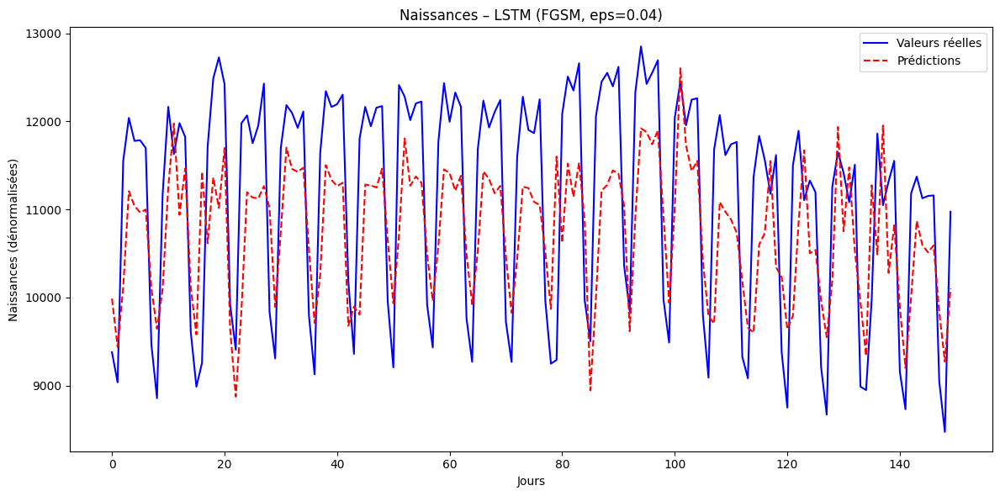

RNN | FGSM – Epsilon 0.04 – MAE: 744.8649 | SIM: 0.9985 | RMSE: 819.7821


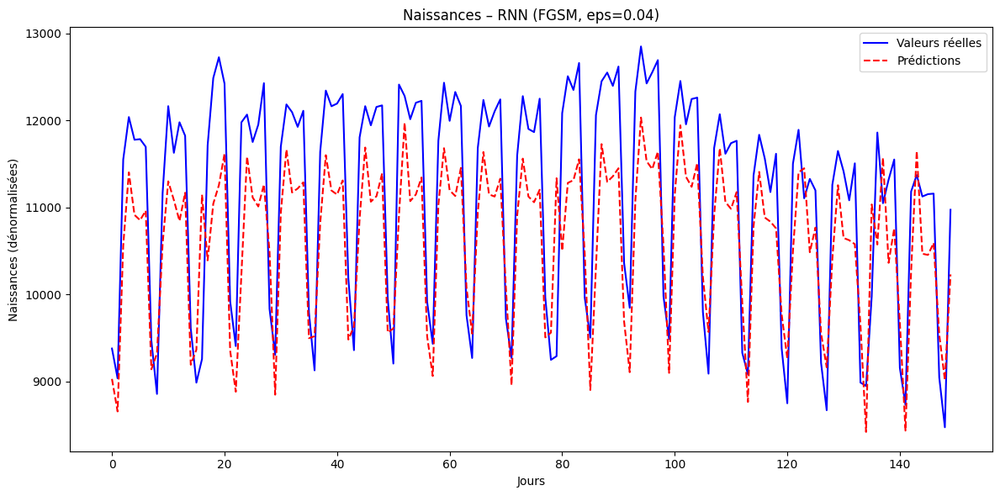

GRU | FGSM – Epsilon 0.05 – MAE: 690.2368 | SIM: 0.9978 | RMSE: 749.8299


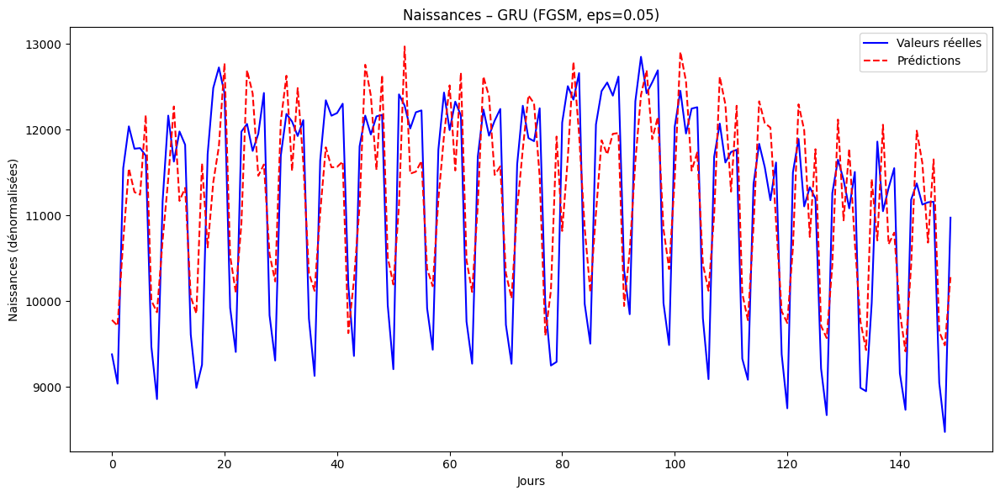

LSTM | FGSM – Epsilon 0.05 – MAE: 1003.0560 | SIM: 0.9960 | RMSE: 1089.5173


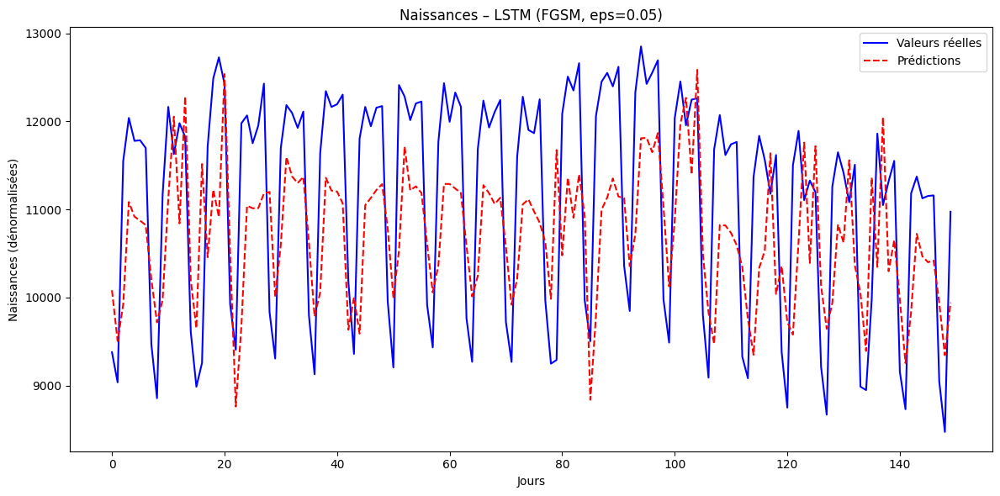

RNN | FGSM – Epsilon 0.05 – MAE: 819.7747 | SIM: 0.9982 | RMSE: 889.3716


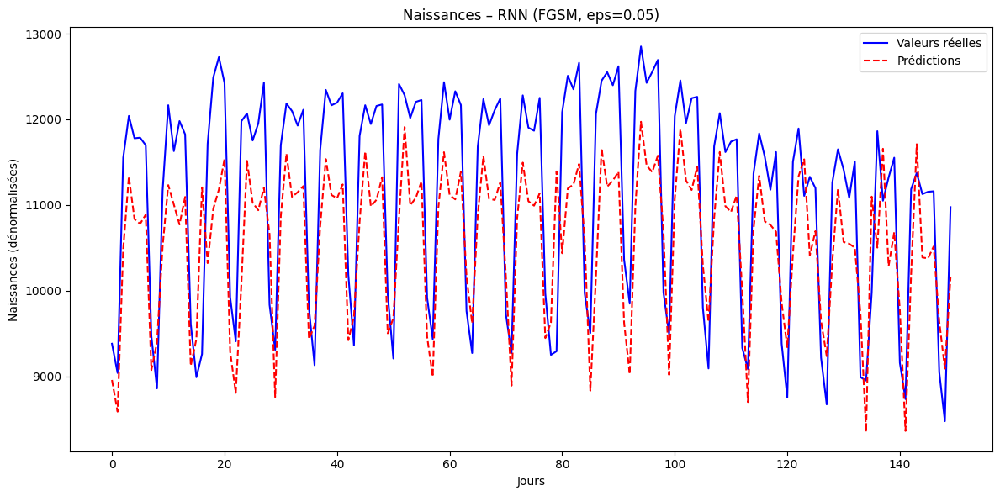

GRU | FGSM – Epsilon 0.07 – MAE: 903.7350 | SIM: 0.9964 | RMSE: 951.7322


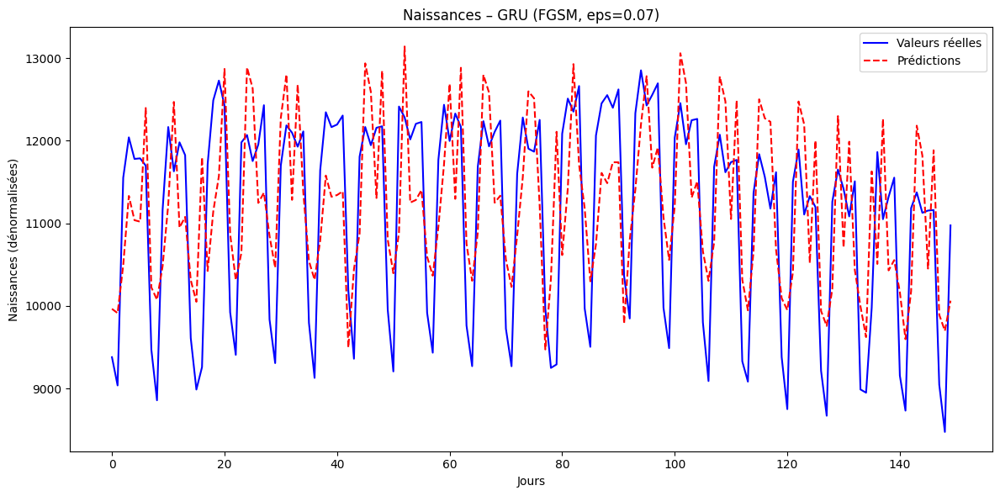

LSTM | FGSM – Epsilon 0.07 – MAE: 1350.4355 | SIM: 0.9932 | RMSE: 1440.1740


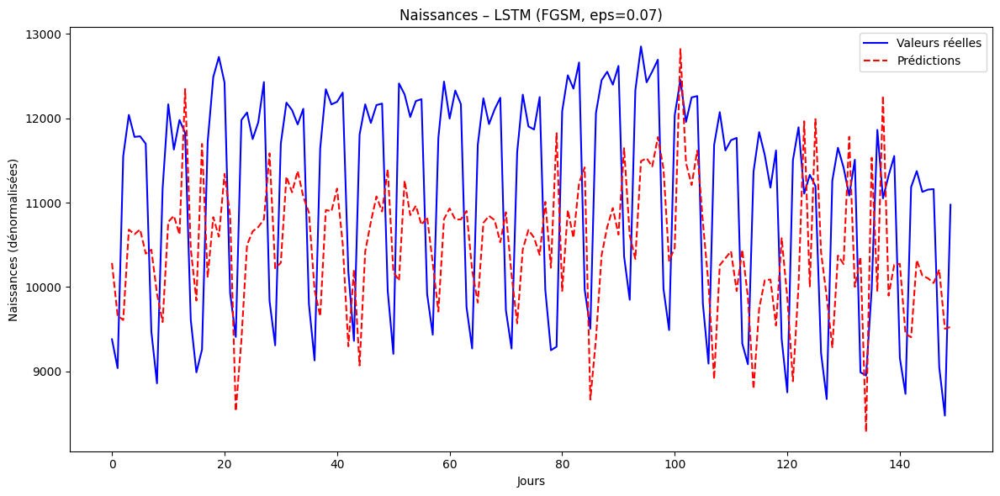

RNN | FGSM – Epsilon 0.07 – MAE: 1010.2834 | SIM: 0.9973 | RMSE: 1070.9350


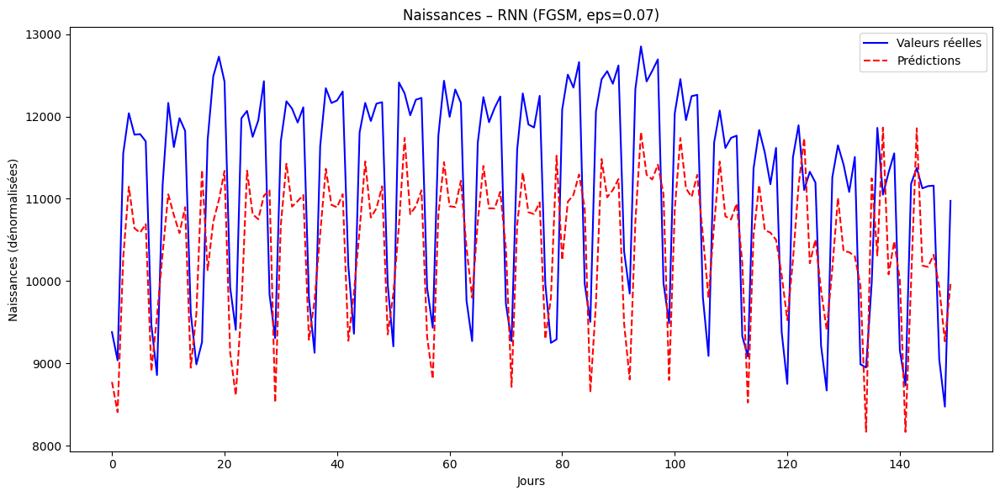

GRU | FGSM – Epsilon 0.10 – MAE: 1116.4824 | SIM: 0.9947 | RMSE: 1159.4340


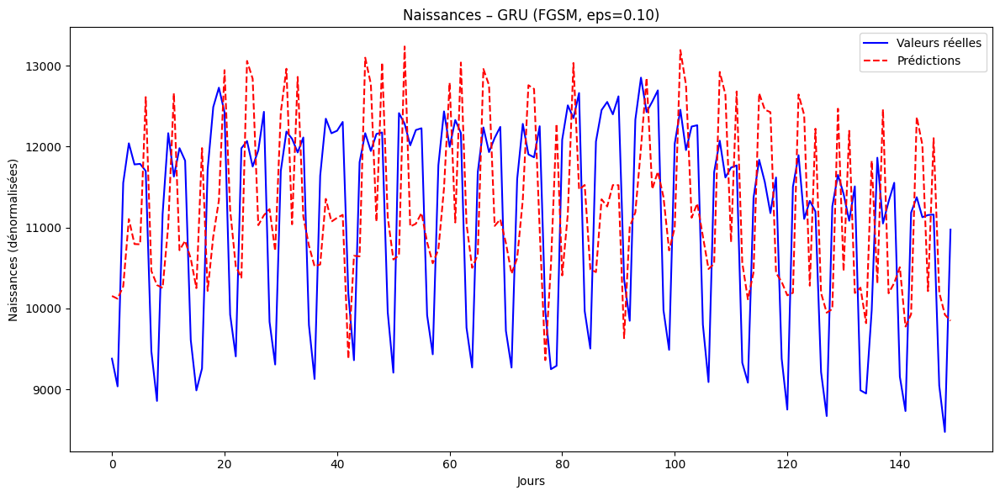

LSTM | FGSM – Epsilon 0.10 – MAE: 1683.8554 | SIM: 0.9892 | RMSE: 1793.0930


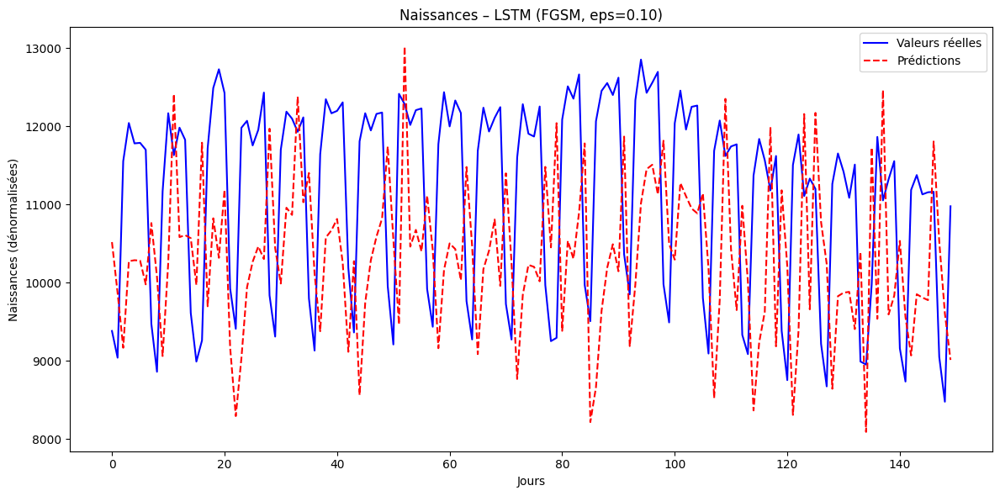

RNN | FGSM – Epsilon 0.10 – MAE: 1203.8379 | SIM: 0.9961 | RMSE: 1260.0588


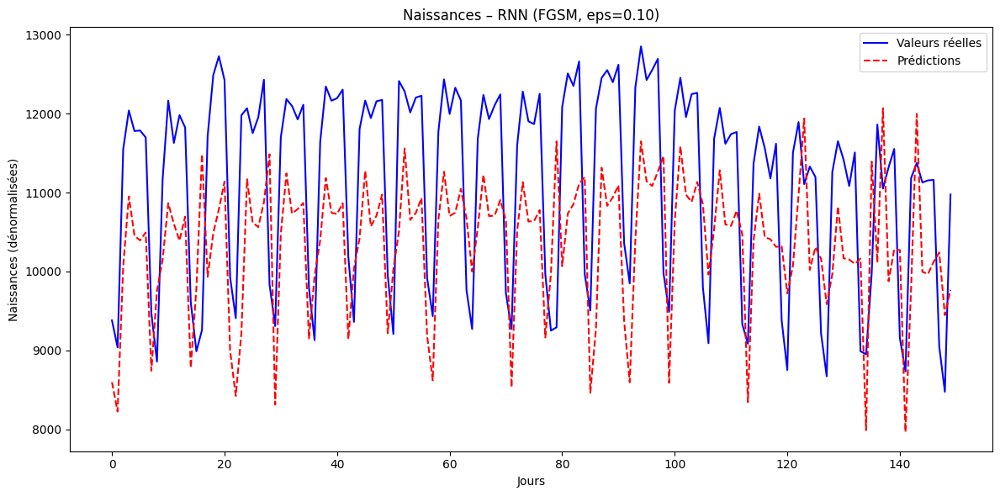

GRU | FGSM – Epsilon 0.20 – MAE: 1883.5526 | SIM: 0.9852 | RMSE: 1940.7946


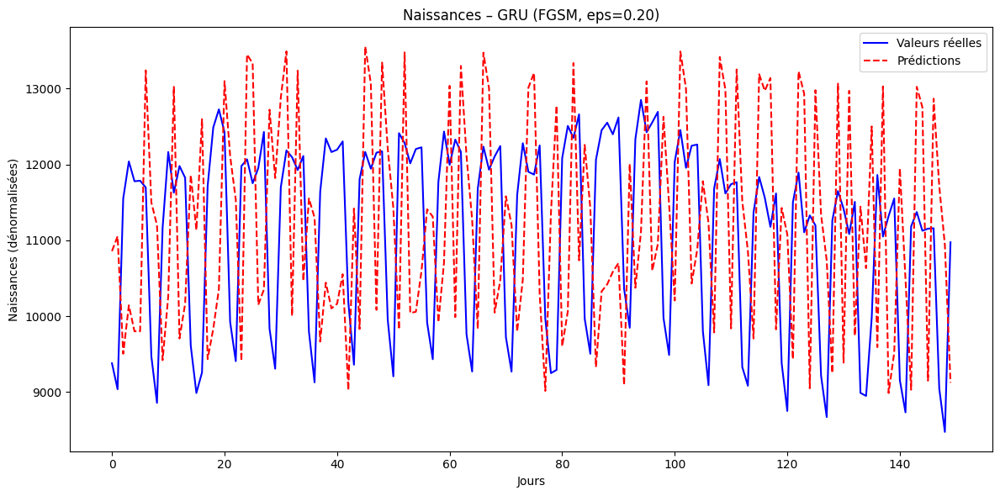

LSTM | FGSM – Epsilon 0.20 – MAE: 2949.0413 | SIM: 0.9661 | RMSE: 3084.4942


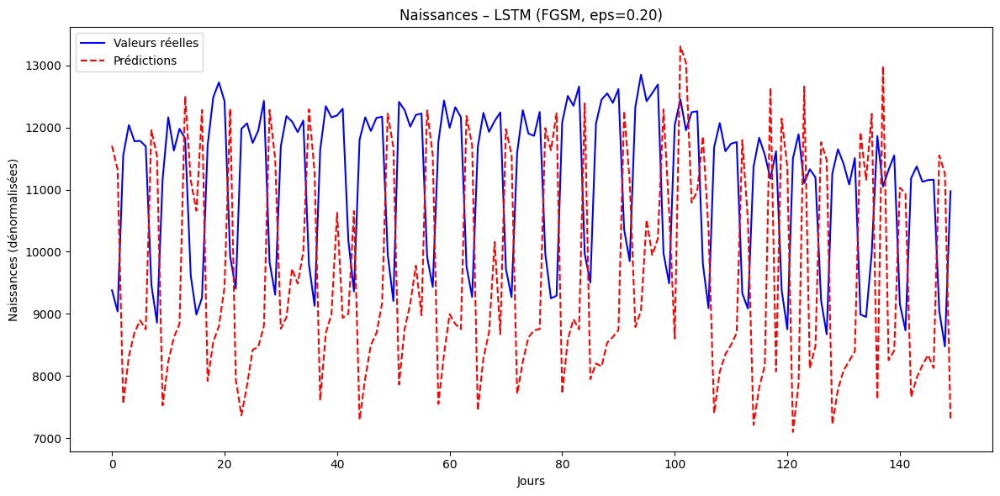

RNN | FGSM – Epsilon 0.20 – MAE: 1965.9220 | SIM: 0.9885 | RMSE: 2011.1246


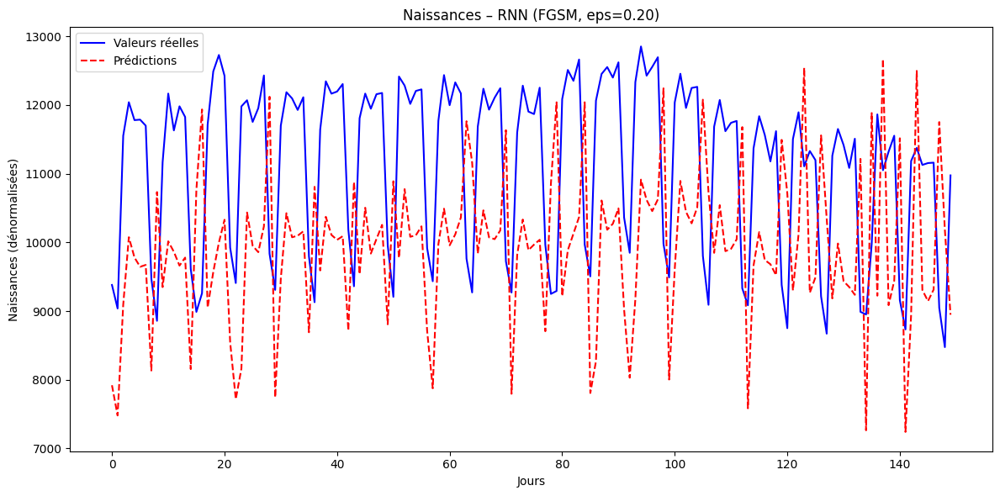

In [ ]:
epsilons_fgsm = [0.01, 0.02, 0.03, 0.04, 0.05, 0.075, 0.1, 0.2]

for eps in epsilons_fgsm:
    true_vals_fgsm, preds_fgsm = fgsm_attack(
        model_gru, test_loader, loss_fn, eps, serie_min_rev, serie_max_rev
    )

    log_and_plot_births(
        true_values=true_vals_fgsm[-days_plot:],
        predictions=preds_fgsm[-days_plot:],
        model_name='GRU',
        attack_name='FGSM',
        epsilon=eps,
        res_tab=res_tab_fgsm,
        similarity_fn=scalar_similarity,
        save_path=f"results/birth/SEED_{seed}/plots/FGSM/{eps}",
        save_png=True
    )

    true_vals_fgsm, preds_fgsm = fgsm_attack(
        model, test_loader, loss_fn, eps, serie_min_rev, serie_max_rev
    )

    log_and_plot_births(
        true_values=true_vals_fgsm[-days_plot:],
        predictions=preds_fgsm[-days_plot:],
        model_name='LSTM',
        attack_name='FGSM',
        epsilon=eps,
        res_tab=res_tab_fgsm,
        similarity_fn=scalar_similarity,
        save_path=f"results/birth/SEED_{seed}/plots/FGSM/{eps}",
        save_png=True
    )

    true_vals_fgsm, preds_fgsm = fgsm_attack(
        model_rnn, test_loader, loss_fn, eps, serie_min_rev, serie_max_rev
    )

    log_and_plot_births(
        true_values=true_vals_fgsm[-days_plot:],
        predictions=preds_fgsm[-days_plot:],
        model_name='RNN',
        attack_name='FGSM',
        epsilon=eps,
        res_tab=res_tab_fgsm,
        similarity_fn=scalar_similarity,
        save_path=f"results/birth/SEED_{seed}/plots/FGSM/{eps}",
        save_png=True
    )


In [ ]:
display(res_tab_fgsm)

Attack              FGSM                                                   \
ε                   0.01        0.02        0.03        0.04         0.05   
Model Metric                                                                
LSTM  MAE     532.610831  640.525642  762.184971  877.138494  1003.055976   
      RMSE    625.220392  730.185213  844.577829  961.749222  1089.517299   
      SIM       0.998705    0.998225    0.997660    0.996992     0.996026   
RNN   MAE     525.013059  597.650826  670.963645  744.864909   819.774675   
      RMSE    625.825370  687.741622  752.568873  819.782140   889.371647   
      SIM       0.999124    0.998949    0.998738    0.998491     0.998202   
GRU   MAE     351.485476  435.551837  519.957423  604.785941   690.236834   
      RMSE    457.530020  524.551873  596.422724  671.730647   749.829852   
      SIM       0.999173    0.998912    0.998593    0.998214     0.997775   

Attack                                               
ε                    0.07         0.10         0.20  
Model Metric                                         
LSTM  MAE     1350.435494  1683.855415  2949.041294  
      RMSE    1440.174026  1793.092954  3084.494190  
      SIM        0.993230     0.989210     0.966124  
RNN   MAE     1010.283380  1203.837872  1965.922007  
      RMSE    1070.935046  1260.058838  2011.124590  
      SIM        0.997283     0.996065     0.988472  
GRU   MAE      903.735042  1116.482362  1883.552561  
      RMSE     951.732172  1159.433993  1940.794624  
      SIM        0.996416     0.994685     0.985167

In [ ]:
from attack.rev_bim import reverse_forecast_attack_bim

In [ ]:
# Creation of the tab result for plotting adversial attack result
models = ['LSTM','RNN','GRU']
metrics = ['MAE', "RMSE", 'SIM']

row_index = pd.MultiIndex.from_product([models, metrics], names=['Model', 'Metric'])

attacks = ['REV_BIM']
epsilons = {
    'REV_BIM':[0.01,0.02,0.03,0.04, 0.05, 0.075, 0.1, 0.2],
}

col_tuples = []
for atk, eps_list in epsilons.items():
    for eps in eps_list:
        col_tuples.append((atk, f"{eps:.2f}"))

col_index = pd.MultiIndex.from_tuples(col_tuples, names=['Attack', 'ε'])

res_tab_bim = pd.DataFrame(index=row_index, columns=col_index, dtype=float)

print(res_tab_bim)

Attack       REV_BIM                                   
ε               0.01 0.02 0.03 0.04 0.05 0.07 0.10 0.20
Model Metric                                           
LSTM  MAE        NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      RMSE       NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      SIM        NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
RNN   MAE        NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      RMSE       NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      SIM        NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
GRU   MAE        NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      RMSE       NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      SIM        NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN


GRU | REV_BIM – Epsilon 0.01 – MAE: 265.0263 | SIM: 0.9994 | RMSE: 392.8150


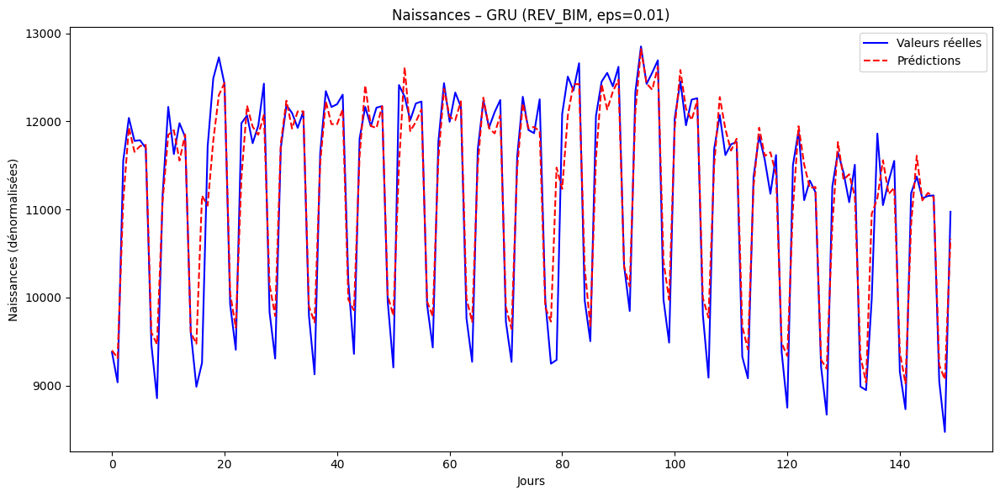

GRU | REV_BIM – Epsilon 0.02 – MAE: 267.6264 | SIM: 0.9994 | RMSE: 391.3476


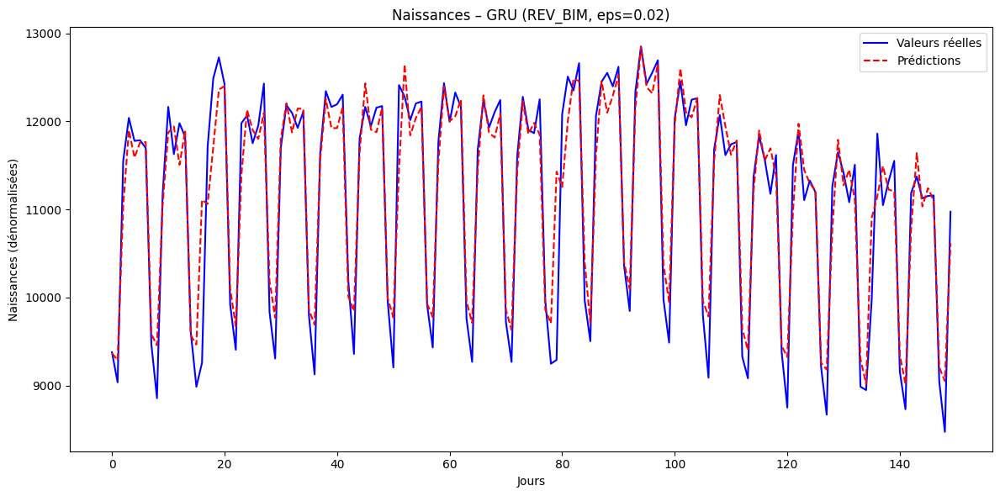

GRU | REV_BIM – Epsilon 0.03 – MAE: 274.9364 | SIM: 0.9994 | RMSE: 393.7597


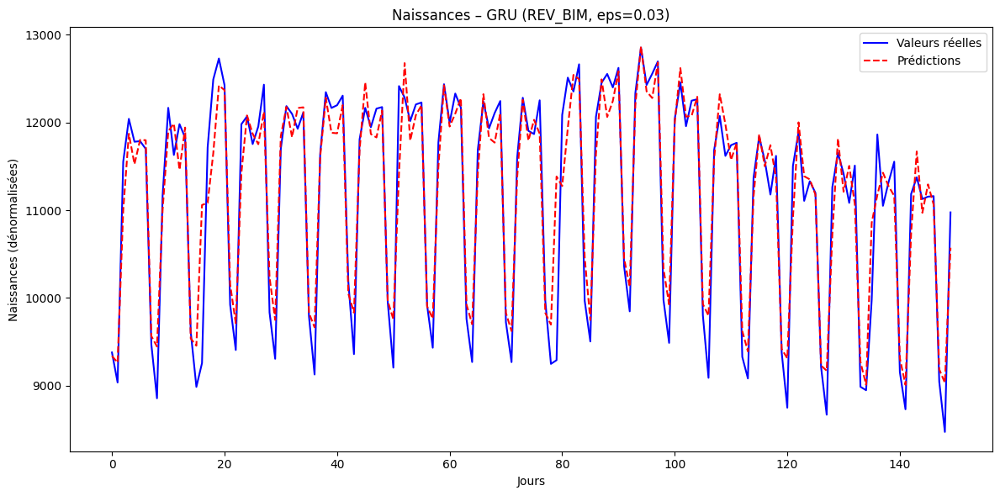

GRU | REV_BIM – Epsilon 0.04 – MAE: 285.4727 | SIM: 0.9994 | RMSE: 399.5571


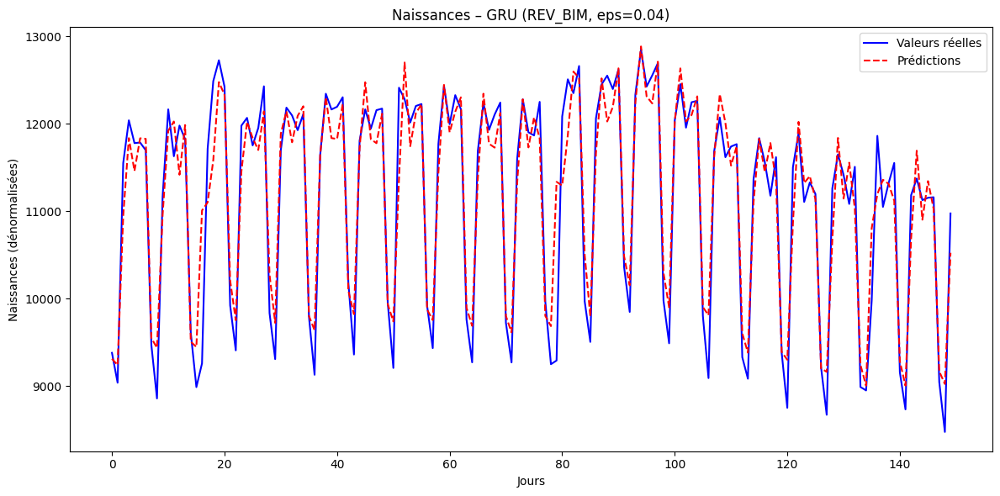

GRU | REV_BIM – Epsilon 0.05 – MAE: 300.1547 | SIM: 0.9993 | RMSE: 409.0645


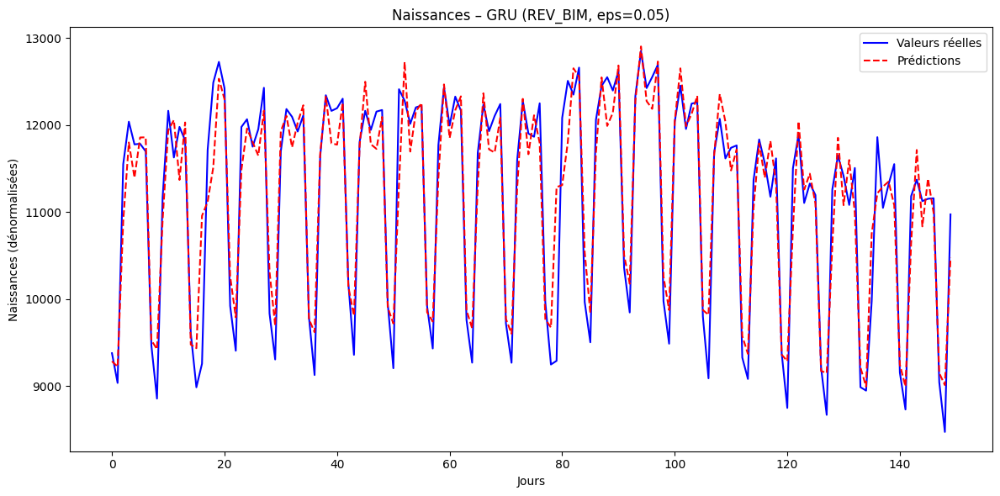

GRU | REV_BIM – Epsilon 0.07 – MAE: 331.6181 | SIM: 0.9993 | RMSE: 433.3120


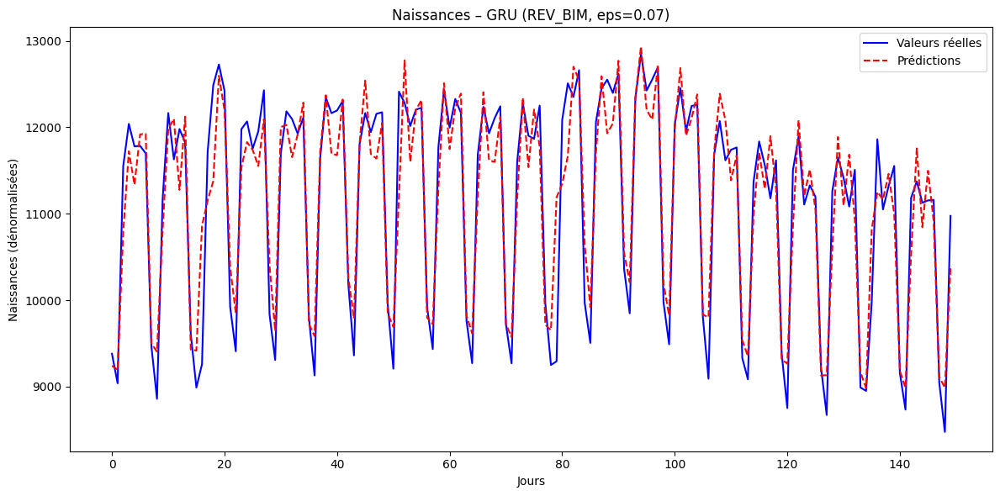

GRU | REV_BIM – Epsilon 0.10 – MAE: 380.6652 | SIM: 0.9991 | RMSE: 474.2517


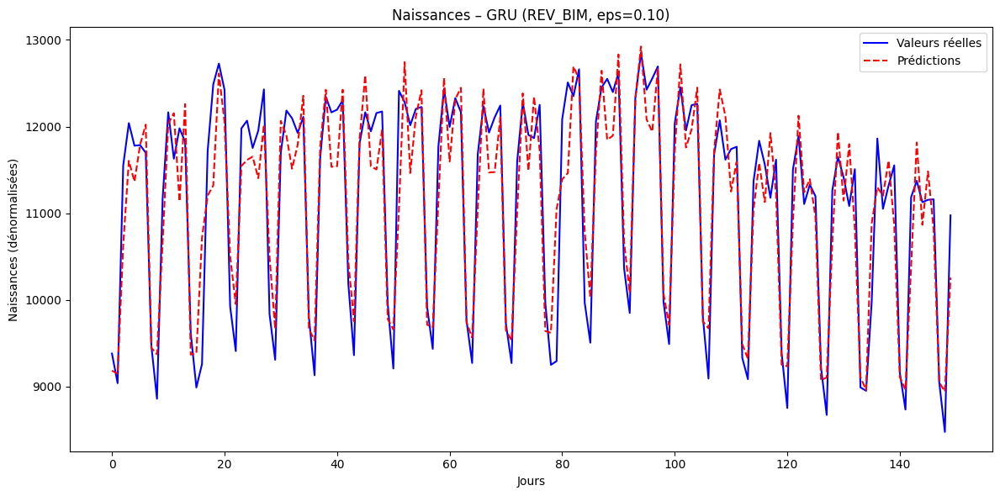

GRU | REV_BIM – Epsilon 0.20 – MAE: 513.4864 | SIM: 0.9984 | RMSE: 660.5391


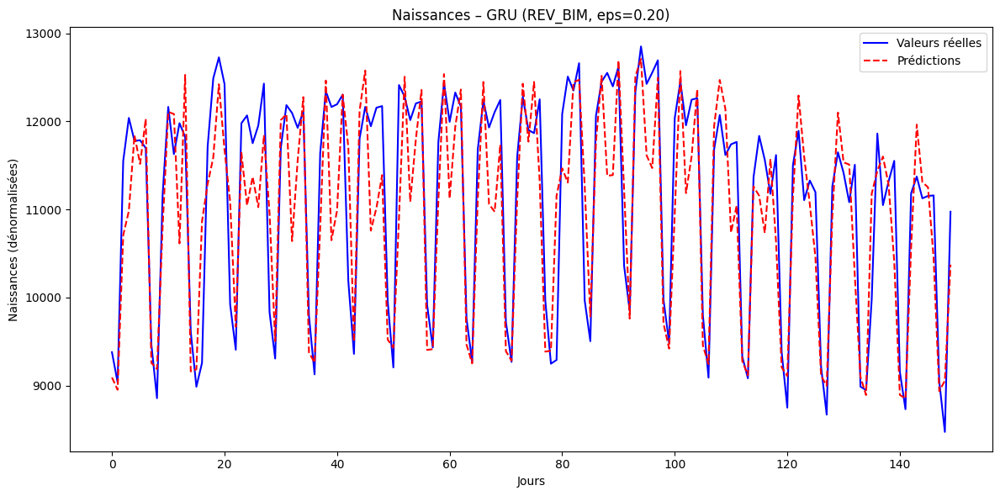

LSTM | REV_BIM – Epsilon 0.01 – MAE: 427.0172 | SIM: 0.9990 | RMSE: 526.9598


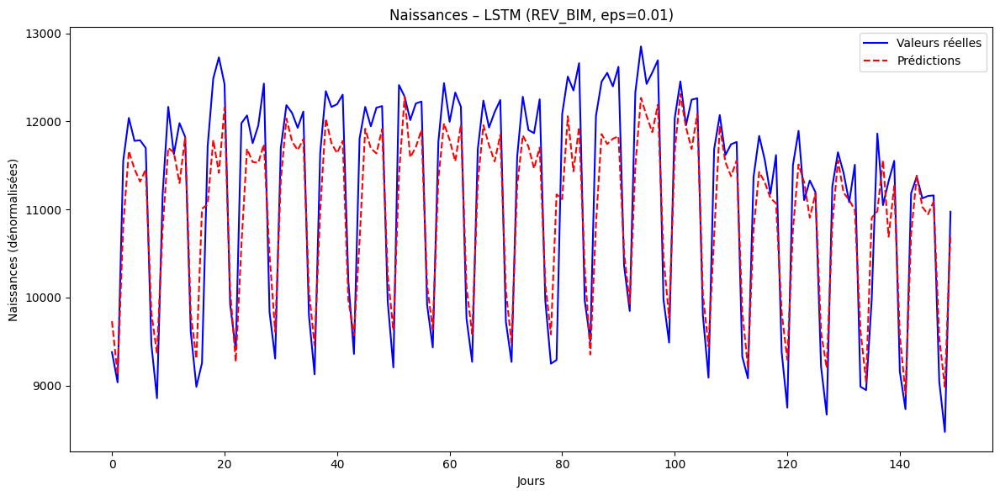

LSTM | REV_BIM – Epsilon 0.02 – MAE: 431.0528 | SIM: 0.9990 | RMSE: 533.3012


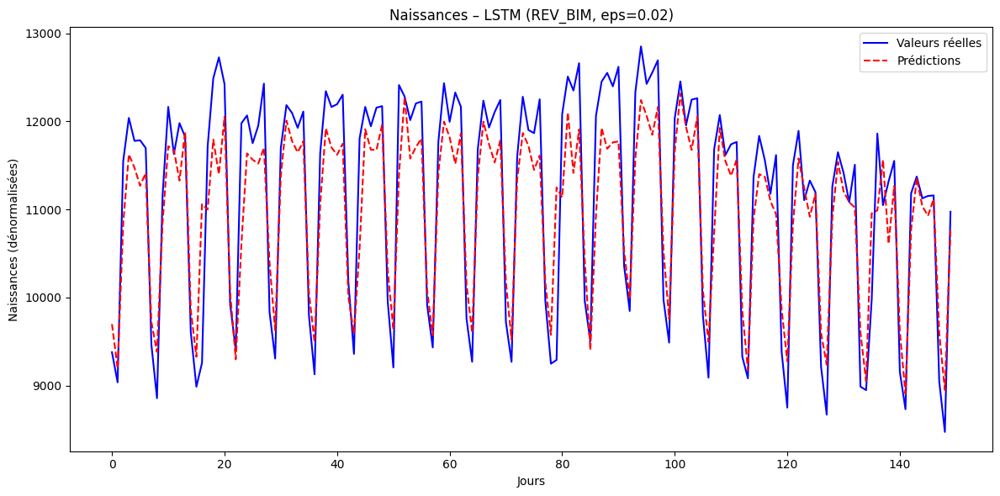

LSTM | REV_BIM – Epsilon 0.03 – MAE: 434.3462 | SIM: 0.9990 | RMSE: 535.7193


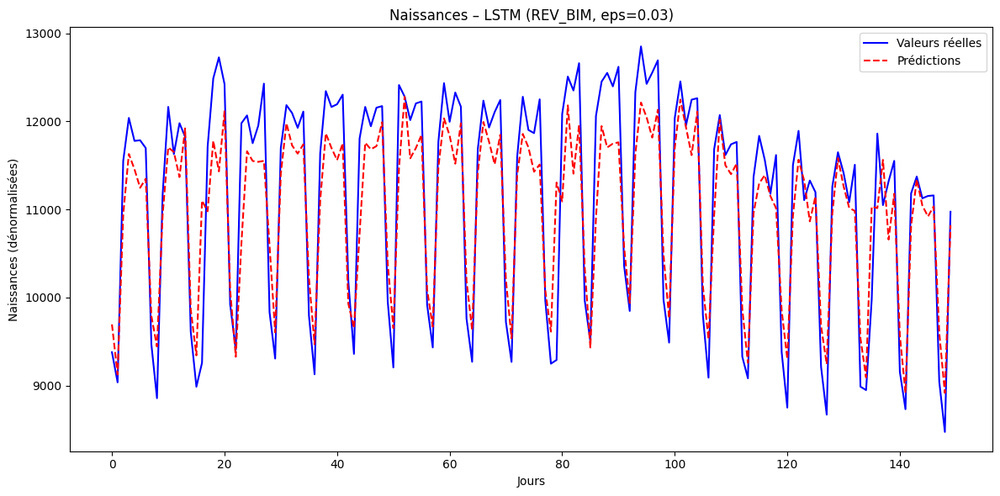

LSTM | REV_BIM – Epsilon 0.04 – MAE: 433.9853 | SIM: 0.9990 | RMSE: 537.1842


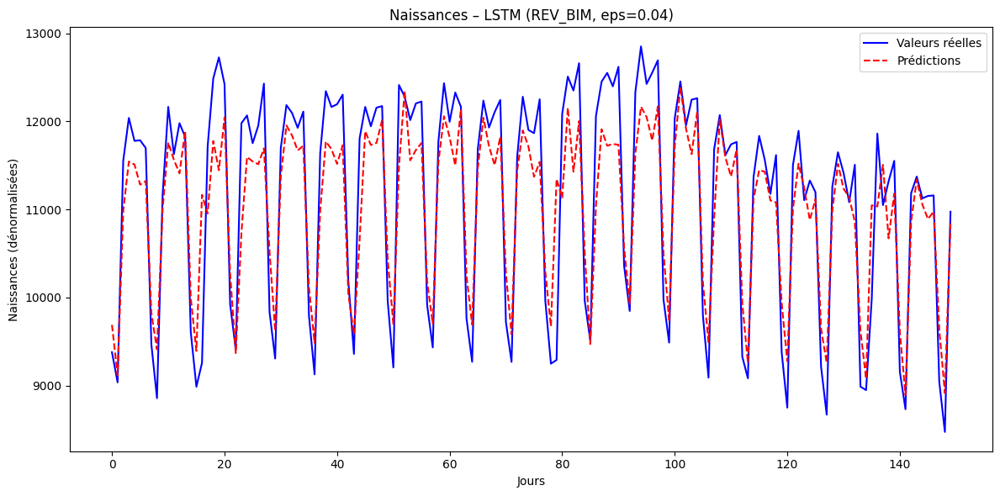

LSTM | REV_BIM – Epsilon 0.05 – MAE: 435.8388 | SIM: 0.9989 | RMSE: 541.7189


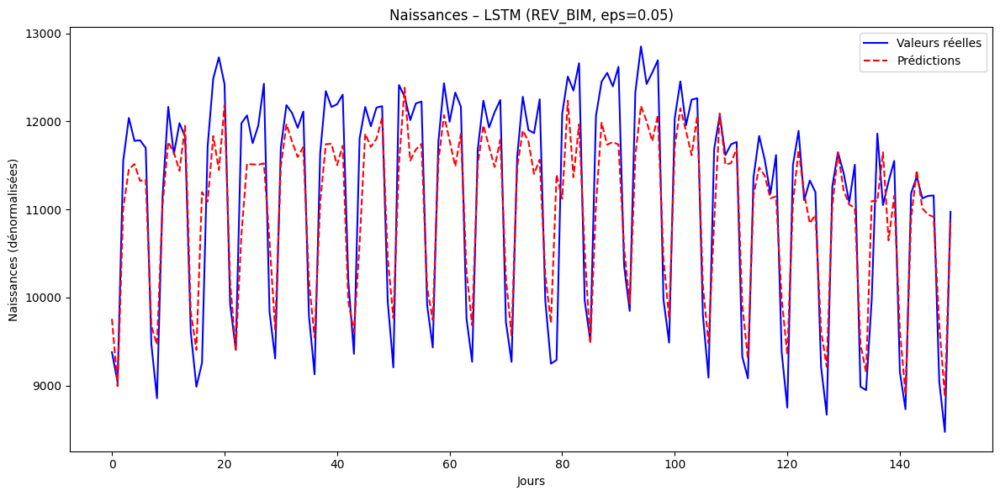

LSTM | REV_BIM – Epsilon 0.07 – MAE: 445.5943 | SIM: 0.9988 | RMSE: 559.1732


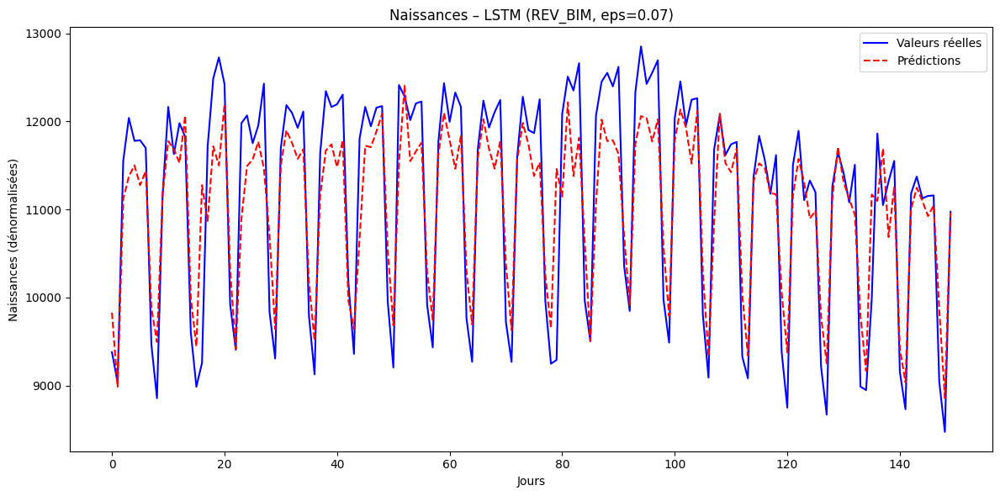

LSTM | REV_BIM – Epsilon 0.10 – MAE: 463.0849 | SIM: 0.9987 | RMSE: 578.8271


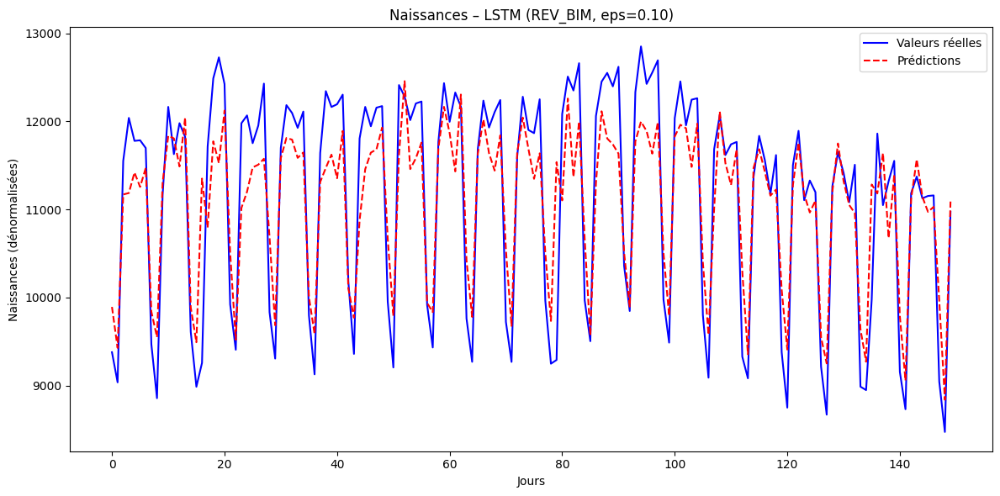

LSTM | REV_BIM – Epsilon 0.20 – MAE: 615.3373 | SIM: 0.9977 | RMSE: 765.2948


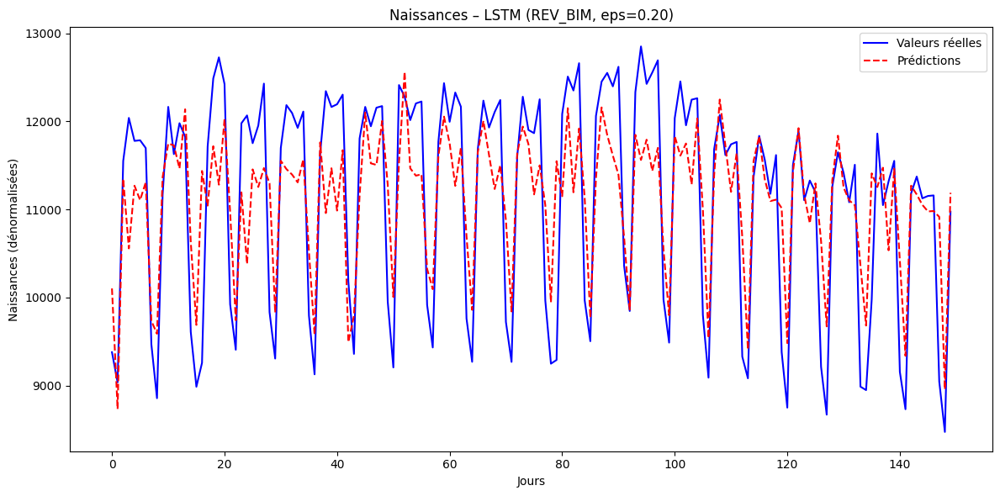

RNN | REV_BIM – Epsilon 0.01 – MAE: 455.1220 | SIM: 0.9993 | RMSE: 570.4099


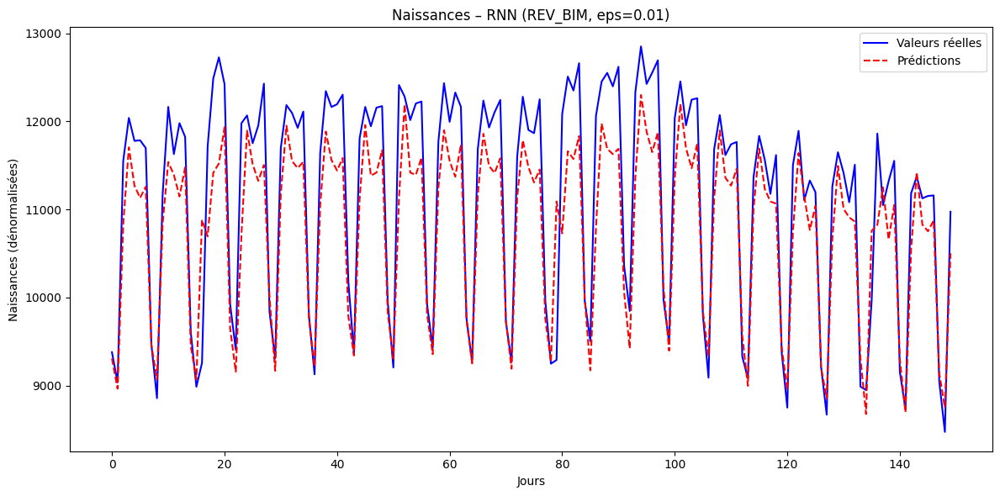

RNN | REV_BIM – Epsilon 0.02 – MAE: 457.9810 | SIM: 0.9993 | RMSE: 574.3223


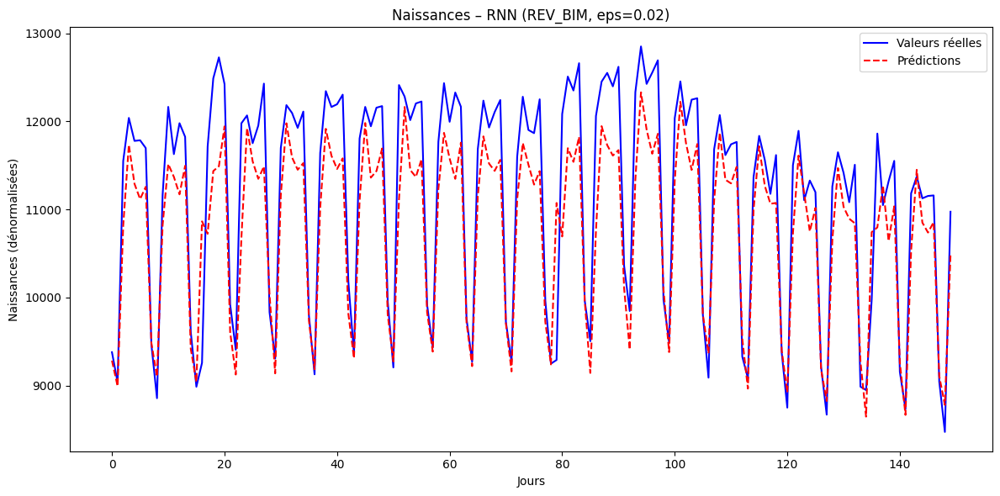

RNN | REV_BIM – Epsilon 0.03 – MAE: 462.3678 | SIM: 0.9993 | RMSE: 579.4802


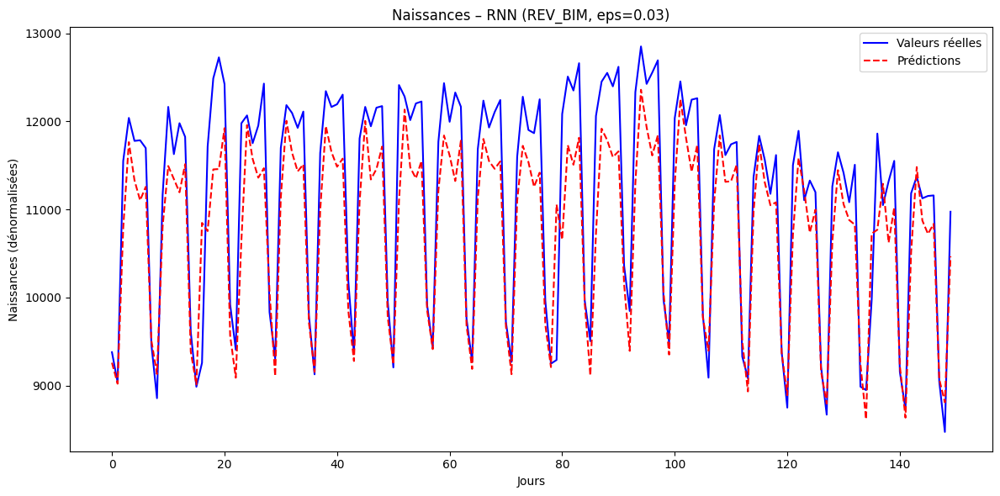

RNN | REV_BIM – Epsilon 0.04 – MAE: 467.4928 | SIM: 0.9992 | RMSE: 585.8102


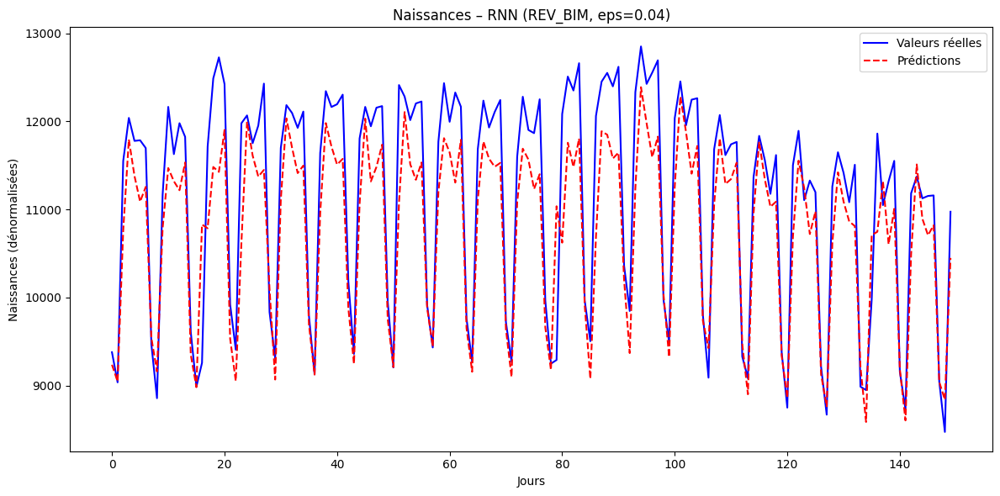

RNN | REV_BIM – Epsilon 0.05 – MAE: 474.7310 | SIM: 0.9992 | RMSE: 593.8869


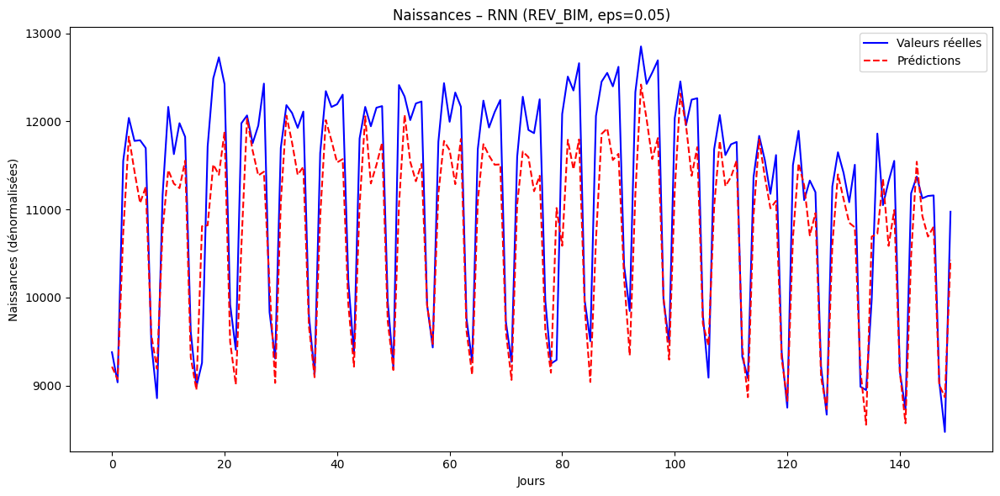

RNN | REV_BIM – Epsilon 0.07 – MAE: 494.9169 | SIM: 0.9992 | RMSE: 615.9689


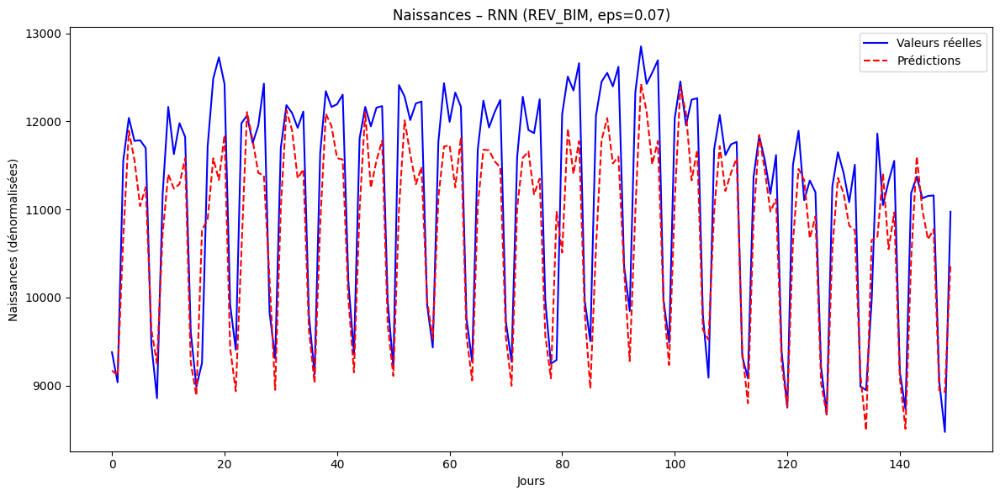

RNN | REV_BIM – Epsilon 0.10 – MAE: 542.4060 | SIM: 0.9990 | RMSE: 669.7391


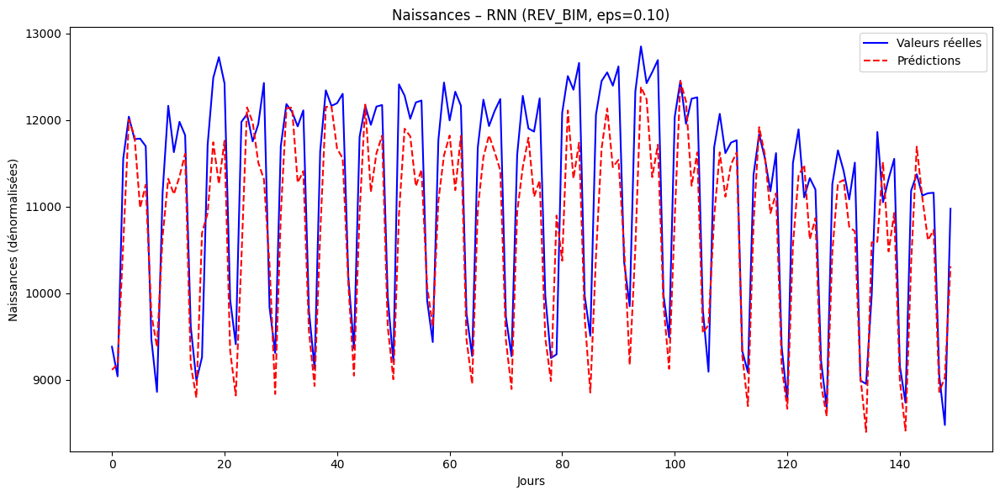

RNN | REV_BIM – Epsilon 0.20 – MAE: 850.9933 | SIM: 0.9973 | RMSE: 1004.9428


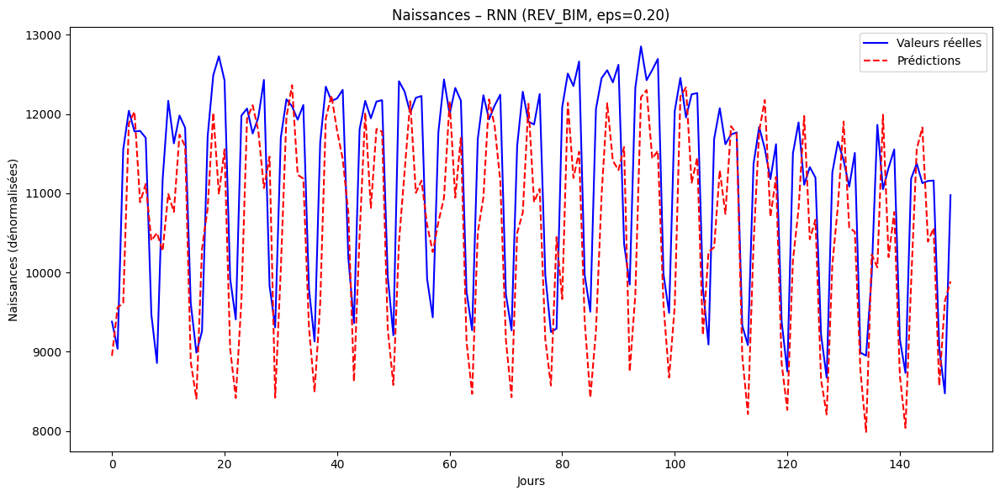

In [ ]:
alpha = 0.01
epsilons = [0.01, 0.02, 0.03, 0.04, 0.05, 0.075, 0.1, 0.2]

bim_attacks = [
    {
        "model_rev": model_gru_rev,
        "model_target": model_gru,
        "model_name": "GRU"
    },
    {
        "model_rev": model_rev,
        "model_target": model,
        "model_name": "LSTM"
    },
    {
        "model_rev": model_rnn_rev,
        "model_target": model_rnn,
        "model_name": "RNN"
    }
]

for attack in bim_attacks:
    for eps in epsilons:
        num_iter = int(eps / alpha)

        results_bim = reverse_forecast_attack_bim(
            model_rev=attack["model_rev"],
            model_normal=attack["model_target"],
            test_loader_rev=test_loader_rev,
            test_loader=test_loader,
            epsilons=[eps],
            price_min=serie_min_rev,
            price_max=serie_max_rev,
            alpha=alpha,
            num_iter=num_iter
        )

        for eps_val, (true_vals, preds) in results_bim.items():
            log_and_plot_births(
              true_values=true_vals[-days_plot:],
              predictions=preds[-days_plot:],
              model_name=attack["model_name"],
              attack_name="REV_BIM",
              epsilon=eps_val,
              res_tab=res_tab_bim,
              similarity_fn=scalar_similarity,
              save_path=f"results/birth/SEED_{seed}/plots/REV_BIM/{eps_val}",
              save_png=True
            )


In [ ]:
display(res_tab_bim)

Attack           REV_BIM                                                  \
ε                   0.01        0.02        0.03        0.04        0.05   
Model Metric                                                               
LSTM  MAE     427.017236  431.052850  434.346246  433.985333  435.838843   
      RMSE    526.959787  533.301176  535.719274  537.184157  541.718911   
      SIM       0.999048    0.999015    0.998989    0.998959    0.998936   
RNN   MAE     455.122041  457.980990  462.367772  467.492827  474.731010   
      RMSE    570.409911  574.322300  579.480243  585.810234  593.886908   
      SIM       0.999270    0.999269    0.999263    0.999250    0.999228   
GRU   MAE     265.026310  267.626442  274.936351  285.472699  300.154716   
      RMSE    392.815013  391.347577  393.759656  399.557073  409.064535   
      SIM       0.999389    0.999392    0.999384    0.999365    0.999334   

Attack                                             
ε                   0.07        0.10         0.20  
Model Metric                                       
LSTM  MAE     445.594345  463.084862   615.337266  
      RMSE    559.173221  578.827133   765.294773  
      SIM       0.998825    0.998712     0.997685  
RNN   MAE     494.916905  542.406020   850.993293  
      RMSE    615.968876  669.739054  1004.942774  
      SIM       0.999156    0.998950     0.997266  
GRU   MAE     331.618130  380.665248   513.486375  
      RMSE    433.312030  474.251686   660.539141  
      SIM       0.999254    0.999116     0.998395

In [ ]:
display(res_tab)

Attack                NA        PAST         REV                          \
ε                   0.00        0.00        0.01        0.02        0.03   
Model Metric                                                               
LSTM  MAE     427.817316  328.922987  428.967296  429.811878  433.667491   
      RMSE    529.717237  439.150283  530.587851  533.960743  537.489750   
      SIM       0.999057    0.999335    0.999044    0.999028    0.998981   
RNN   MAE     453.177722  317.246896  455.122041  458.479528  463.590075   
      RMSE    567.480292  450.218435  570.409911  574.566491  580.249171   
      SIM       0.999266    0.999224    0.999270    0.999268    0.999261   
GRU   MAE     268.170518  333.241523  451.473848  452.666331  455.525579   
      RMSE    397.744667  456.641566  566.563518  568.517340  573.474159   
      SIM       0.999376    0.999255    0.999283    0.999287    0.999277   

Attack                                                                    
ε                   0.04        0.05        0.07        0.10        0.20  
Model Metric                                                              
LSTM  MAE     450.732569  433.265869  495.211502  502.140627  753.430234  
      RMSE    552.652235  547.680498  607.824639  631.816271  962.419282  
      SIM       0.998902    0.998901    0.998638    0.998463    0.996317  
RNN   MAE     469.462190  477.298076  502.677460  538.268650  770.176554  
      RMSE    587.206857  595.494915  623.050059  660.716555  915.748121  
      SIM       0.999247    0.999228    0.999151    0.999032    0.997999  
GRU   MAE     460.607980  468.568124  496.743084  540.202739  816.376805  
      RMSE    581.287198  591.975200  630.821837  685.513595  993.154934  
      SIM       0.999255    0.999220    0.999077    0.998860    0.997355

In [ ]:
model_surrogate = SimpleLSTM(input_size=1, hidden_size=64, output_size=1, num_layers=2)
optimizer_rev = torch.optim.Adam(model_surrogate.parameters(), lr=0.001)
model_surrogate.to(device)
train_models_elec(model_surrogate, loss_fn, optimizer_rev, num_epochs, train_loader,device)

Epoch [1/50], Train Loss: 0.0375
Epoch [2/50], Train Loss: 0.0176
Epoch [3/50], Train Loss: 0.0167
Epoch [4/50], Train Loss: 0.0163
Epoch [5/50], Train Loss: 0.0162
Epoch [6/50], Train Loss: 0.0158
Epoch [7/50], Train Loss: 0.0156
Epoch [8/50], Train Loss: 0.0103
Epoch [9/50], Train Loss: 0.0061
Epoch [10/50], Train Loss: 0.0054
Epoch [11/50], Train Loss: 0.0050
Epoch [12/50], Train Loss: 0.0048
Epoch [13/50], Train Loss: 0.0046
Epoch [14/50], Train Loss: 0.0046
Epoch [15/50], Train Loss: 0.0044
Epoch [16/50], Train Loss: 0.0044
Epoch [17/50], Train Loss: 0.0041
Epoch [18/50], Train Loss: 0.0039
Epoch [19/50], Train Loss: 0.0040
Epoch [20/50], Train Loss: 0.0042
Epoch [21/50], Train Loss: 0.0040
Epoch [22/50], Train Loss: 0.0038
Epoch [23/50], Train Loss: 0.0039
Epoch [24/50], Train Loss: 0.0037
Epoch [25/50], Train Loss: 0.0035
Epoch [26/50], Train Loss: 0.0035
Epoch [27/50], Train Loss: 0.0036
Epoch [28/50], Train Loss: 0.0035
Epoch [29/50], Train Loss: 0.0035
Epoch [30/50], Train Lo

In [ ]:
model_rnn_surrogate = SimpleRNN(input_size=1, hidden_size=64, output_size=1, num_layers=2)
optimizer_rev = torch.optim.Adam(model_rnn_surrogate.parameters(), lr=0.001)
model_rnn_surrogate.to(device)
train_models_elec(model_rnn_surrogate, loss_fn, optimizer_rev, num_epochs, train_loader,device)

Epoch [1/50], Train Loss: 0.0212
Epoch [2/50], Train Loss: 0.0048
Epoch [3/50], Train Loss: 0.0037
Epoch [4/50], Train Loss: 0.0038
Epoch [5/50], Train Loss: 0.0034
Epoch [6/50], Train Loss: 0.0034
Epoch [7/50], Train Loss: 0.0033
Epoch [8/50], Train Loss: 0.0034
Epoch [9/50], Train Loss: 0.0030
Epoch [10/50], Train Loss: 0.0030
Epoch [11/50], Train Loss: 0.0030
Epoch [12/50], Train Loss: 0.0029
Epoch [13/50], Train Loss: 0.0029
Epoch [14/50], Train Loss: 0.0030
Epoch [15/50], Train Loss: 0.0028
Epoch [16/50], Train Loss: 0.0028
Epoch [17/50], Train Loss: 0.0028
Epoch [18/50], Train Loss: 0.0028
Epoch [19/50], Train Loss: 0.0028
Epoch [20/50], Train Loss: 0.0028
Epoch [21/50], Train Loss: 0.0027
Epoch [22/50], Train Loss: 0.0027
Epoch [23/50], Train Loss: 0.0026
Epoch [24/50], Train Loss: 0.0027
Epoch [25/50], Train Loss: 0.0027
Epoch [26/50], Train Loss: 0.0027
Epoch [27/50], Train Loss: 0.0027
Epoch [28/50], Train Loss: 0.0027
Epoch [29/50], Train Loss: 0.0026
Epoch [30/50], Train Lo

In [ ]:
model_gru_surrogate = SimpleGRU(input_size=1, hidden_size=64, output_size=1, num_layers=2)
optimizer_rev = torch.optim.Adam(model_gru_surrogate.parameters(), lr=0.001)
model_gru_surrogate.to(device)
train_models_elec(model_gru_surrogate, loss_fn, optimizer_rev, num_epochs, train_loader,device)

Epoch [1/50], Train Loss: 0.0454
Epoch [2/50], Train Loss: 0.0184
Epoch [3/50], Train Loss: 0.0146
Epoch [4/50], Train Loss: 0.0120
Epoch [5/50], Train Loss: 0.0102
Epoch [6/50], Train Loss: 0.0094
Epoch [7/50], Train Loss: 0.0084
Epoch [8/50], Train Loss: 0.0050
Epoch [9/50], Train Loss: 0.0031
Epoch [10/50], Train Loss: 0.0028
Epoch [11/50], Train Loss: 0.0027
Epoch [12/50], Train Loss: 0.0026
Epoch [13/50], Train Loss: 0.0026
Epoch [14/50], Train Loss: 0.0026
Epoch [15/50], Train Loss: 0.0026
Epoch [16/50], Train Loss: 0.0026
Epoch [17/50], Train Loss: 0.0026
Epoch [18/50], Train Loss: 0.0026
Epoch [19/50], Train Loss: 0.0025
Epoch [20/50], Train Loss: 0.0026
Epoch [21/50], Train Loss: 0.0026
Epoch [22/50], Train Loss: 0.0025
Epoch [23/50], Train Loss: 0.0026
Epoch [24/50], Train Loss: 0.0025
Epoch [25/50], Train Loss: 0.0024
Epoch [26/50], Train Loss: 0.0025
Epoch [27/50], Train Loss: 0.0026
Epoch [28/50], Train Loss: 0.0025
Epoch [29/50], Train Loss: 0.0025
Epoch [30/50], Train Lo

In [ ]:
from attack.fgsm_surrogate import fgsm_surrogate_attack

GRU | FGSM_SURRO – Epsilon 0.01 – MAE: 327.2516 | SIM: 0.9992 | RMSE: 446.7460


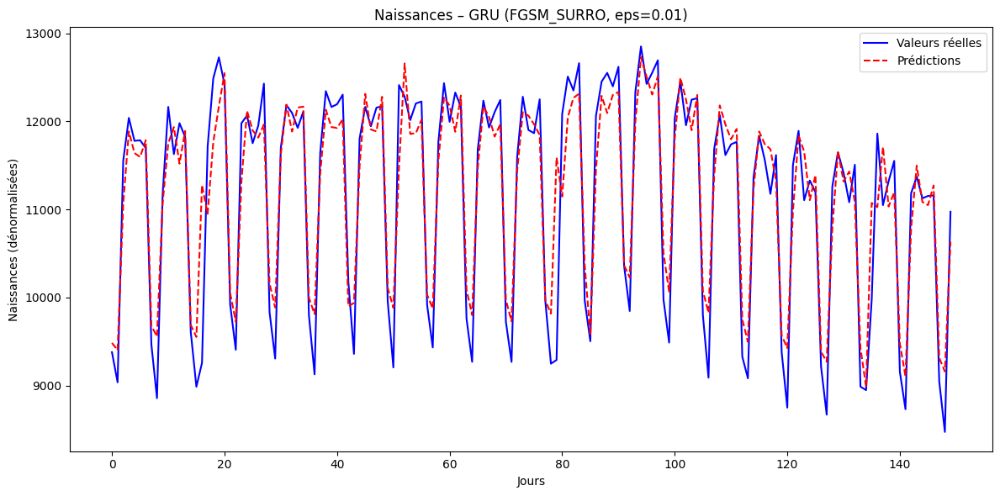

RNN | FGSM_SURRO – Epsilon 0.01 – MAE: 511.3854 | SIM: 0.9991 | RMSE: 619.1906


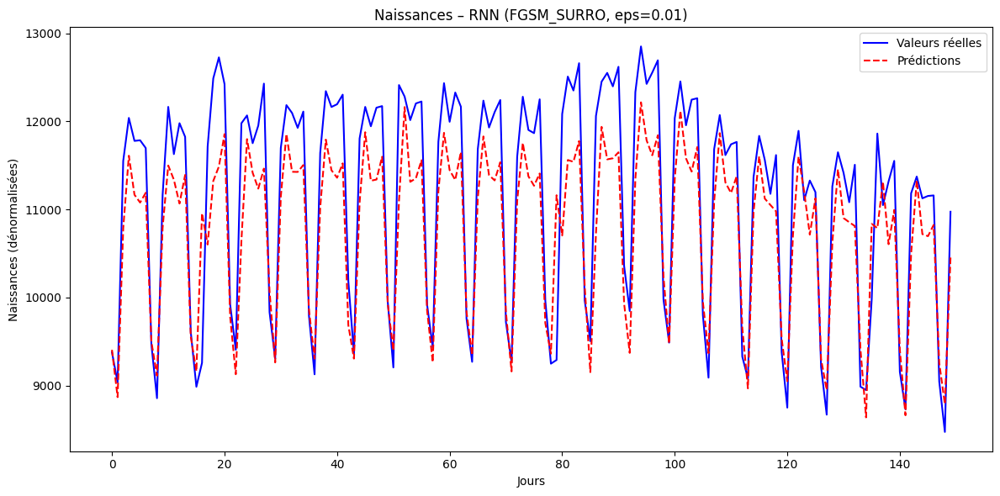

LSTM | FGSM_SURRO – Epsilon 0.01 – MAE: 516.9427 | SIM: 0.9988 | RMSE: 612.1778


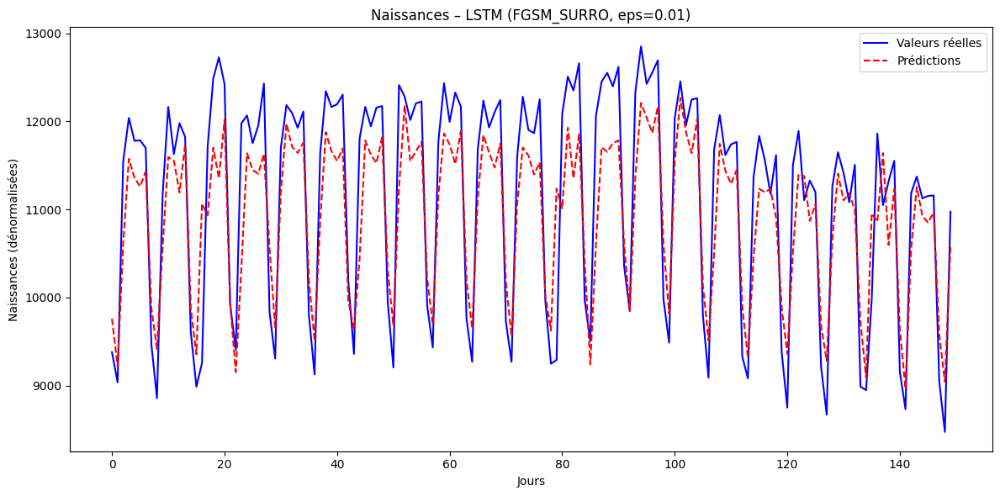

GRU | FGSM_SURRO – Epsilon 0.02 – MAE: 395.6293 | SIM: 0.9990 | RMSE: 503.2697


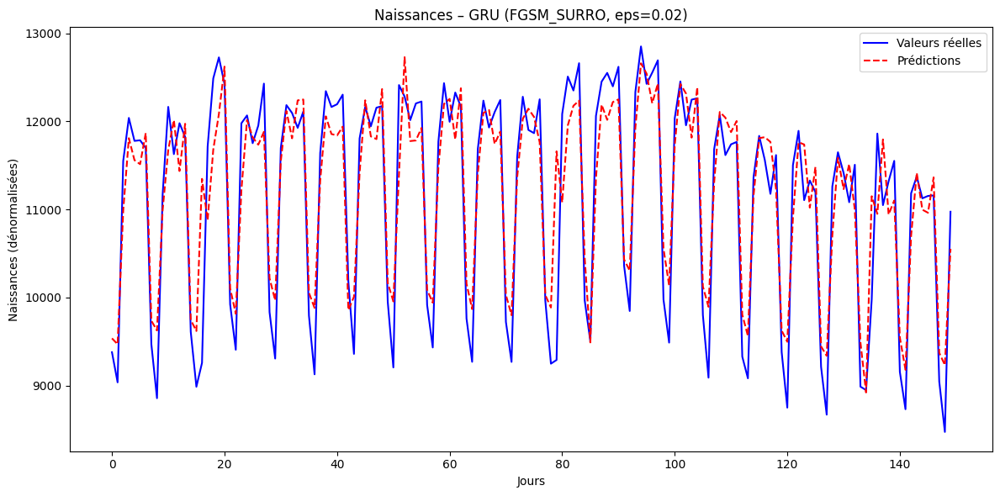

RNN | FGSM_SURRO – Epsilon 0.02 – MAE: 574.1020 | SIM: 0.9989 | RMSE: 674.2437


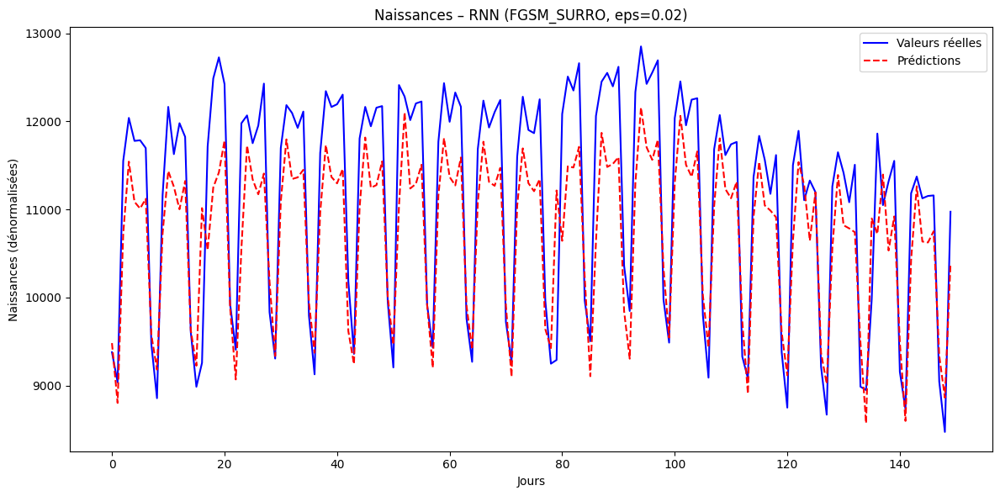

LSTM | FGSM_SURRO – Epsilon 0.02 – MAE: 608.6217 | SIM: 0.9984 | RMSE: 699.7696


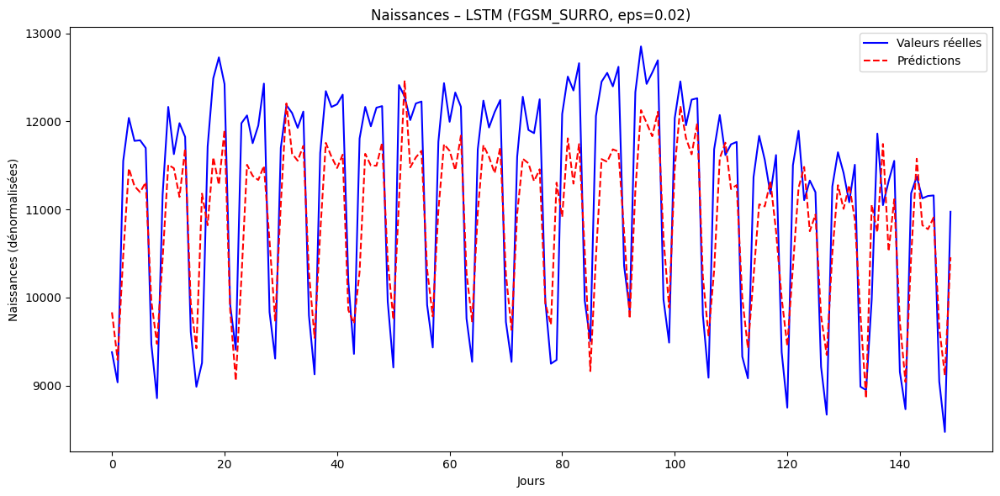

GRU | FGSM_SURRO – Epsilon 0.03 – MAE: 469.5911 | SIM: 0.9987 | RMSE: 565.3365


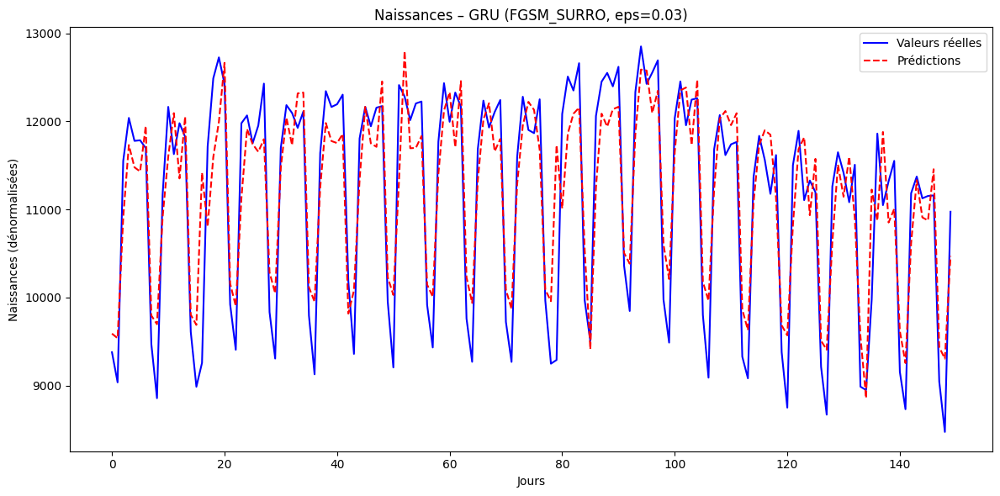

RNN | FGSM_SURRO – Epsilon 0.03 – MAE: 641.7592 | SIM: 0.9987 | RMSE: 732.1041


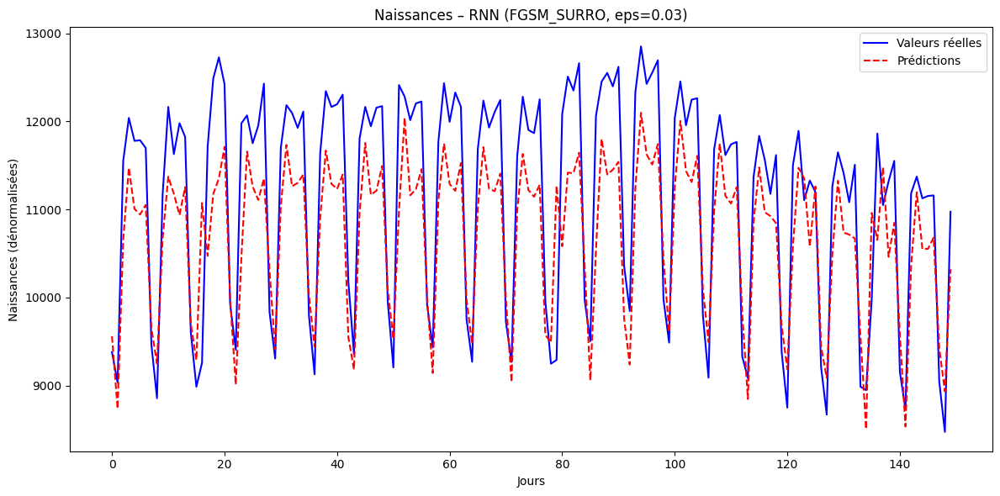

LSTM | FGSM_SURRO – Epsilon 0.03 – MAE: 711.3124 | SIM: 0.9979 | RMSE: 793.4285


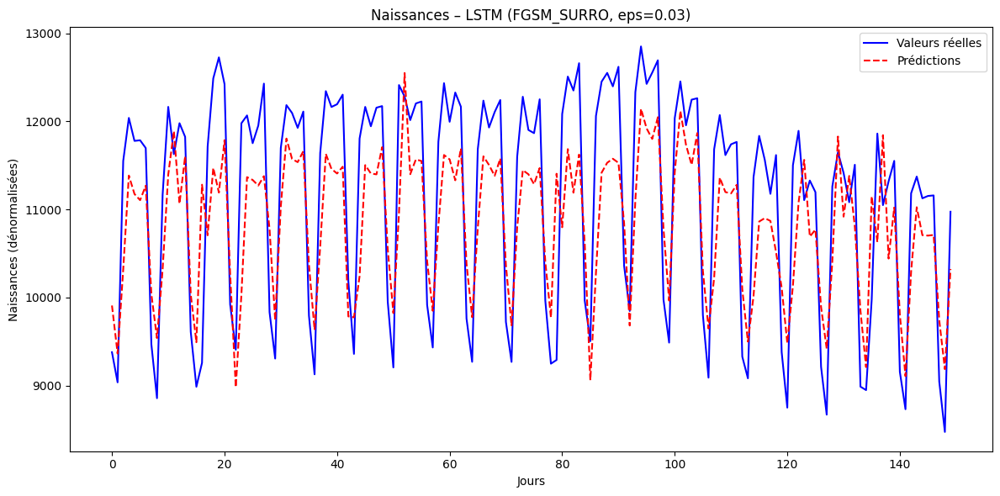

GRU | FGSM_SURRO – Epsilon 0.04 – MAE: 547.3727 | SIM: 0.9984 | RMSE: 631.6301


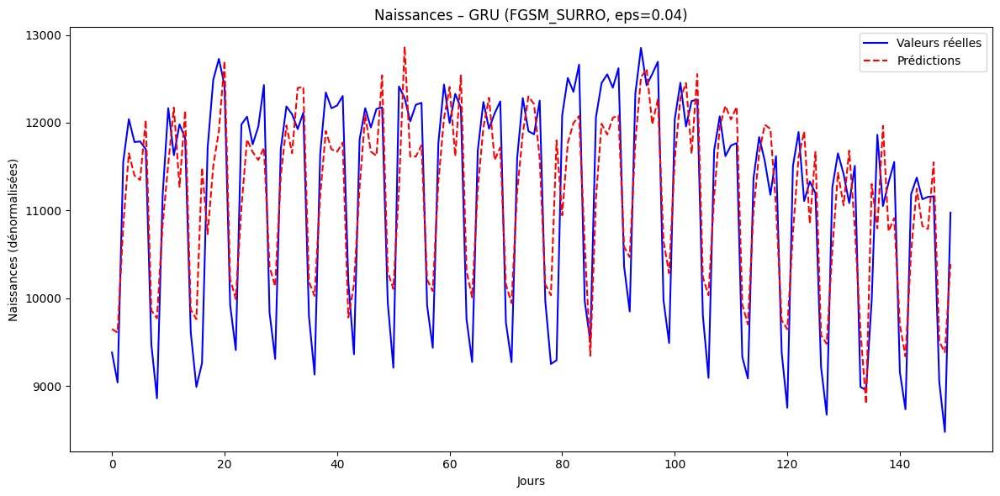

RNN | FGSM_SURRO – Epsilon 0.04 – MAE: 710.4863 | SIM: 0.9985 | RMSE: 792.1591


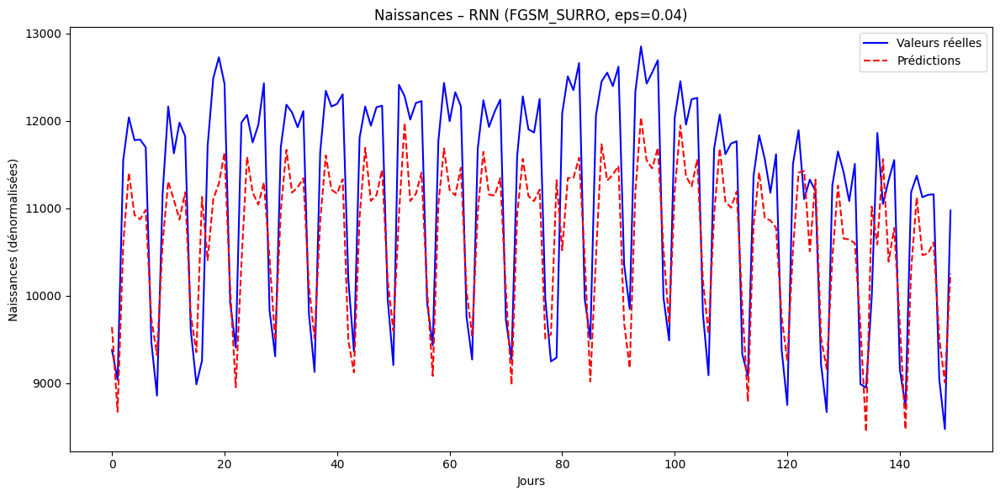

LSTM | FGSM_SURRO – Epsilon 0.04 – MAE: 811.3000 | SIM: 0.9974 | RMSE: 893.0689


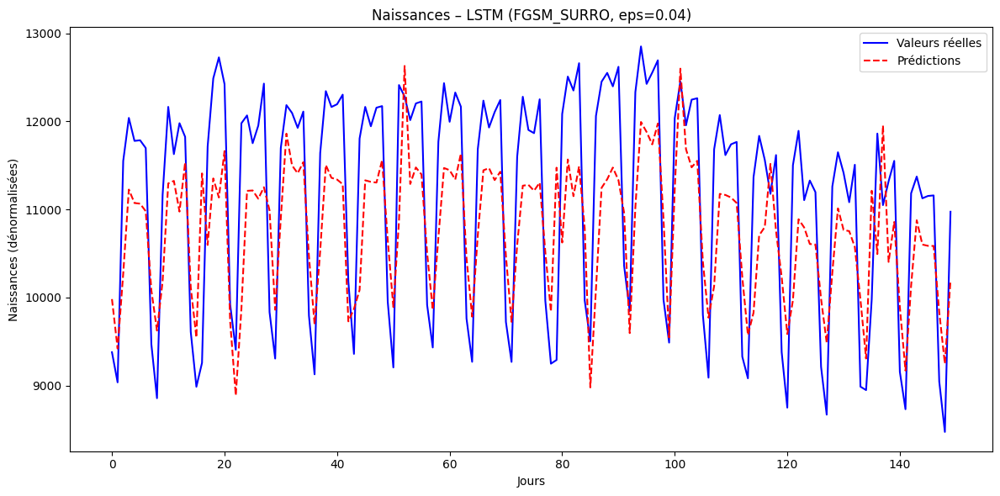

GRU | FGSM_SURRO – Epsilon 0.05 – MAE: 626.4173 | SIM: 0.9980 | RMSE: 701.5774


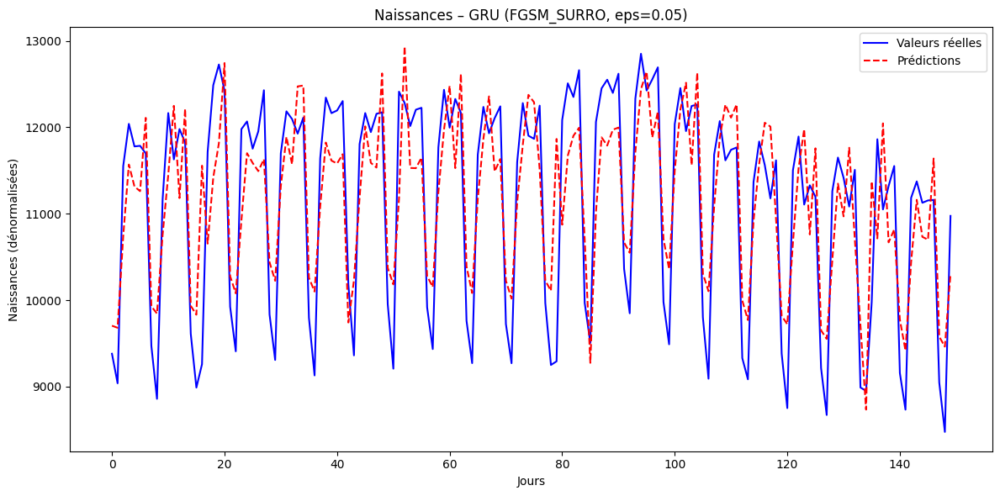

RNN | FGSM_SURRO – Epsilon 0.05 – MAE: 780.0201 | SIM: 0.9982 | RMSE: 854.3027


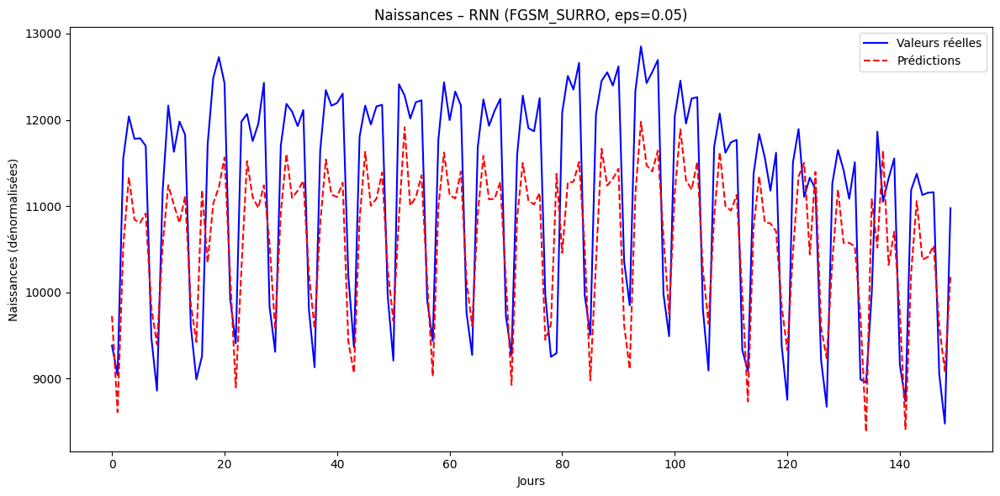

LSTM | FGSM_SURRO – Epsilon 0.05 – MAE: 916.7221 | SIM: 0.9969 | RMSE: 996.3957


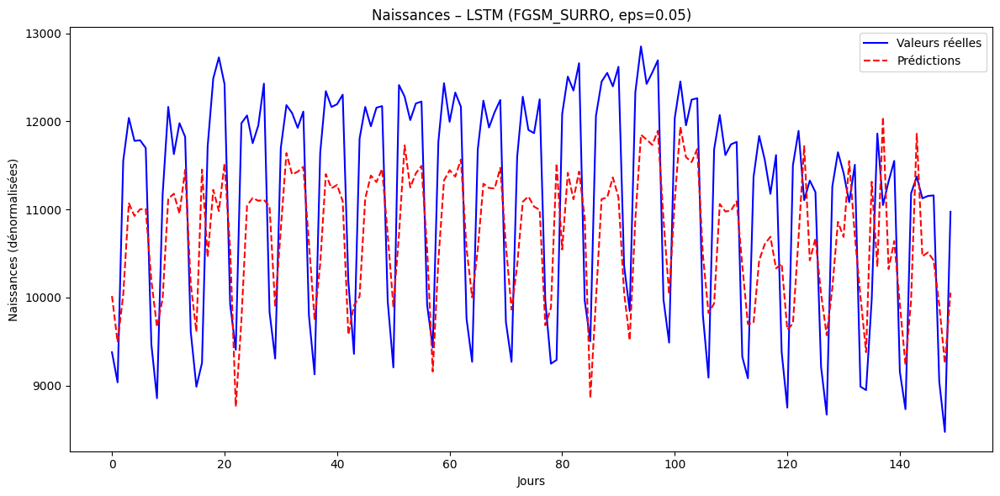

GRU | FGSM_SURRO – Epsilon 0.07 – MAE: 832.0934 | SIM: 0.9968 | RMSE: 891.3869


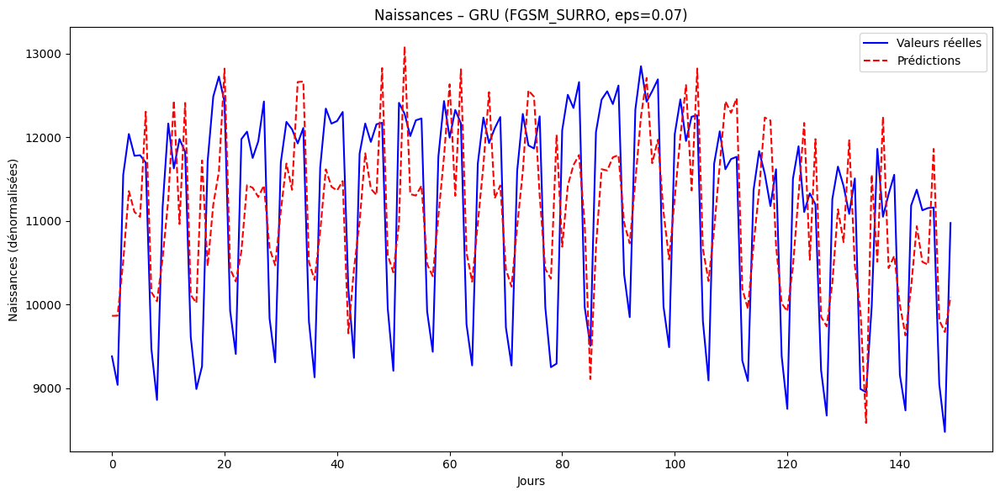

RNN | FGSM_SURRO – Epsilon 0.07 – MAE: 956.6673 | SIM: 0.9973 | RMSE: 1016.5471


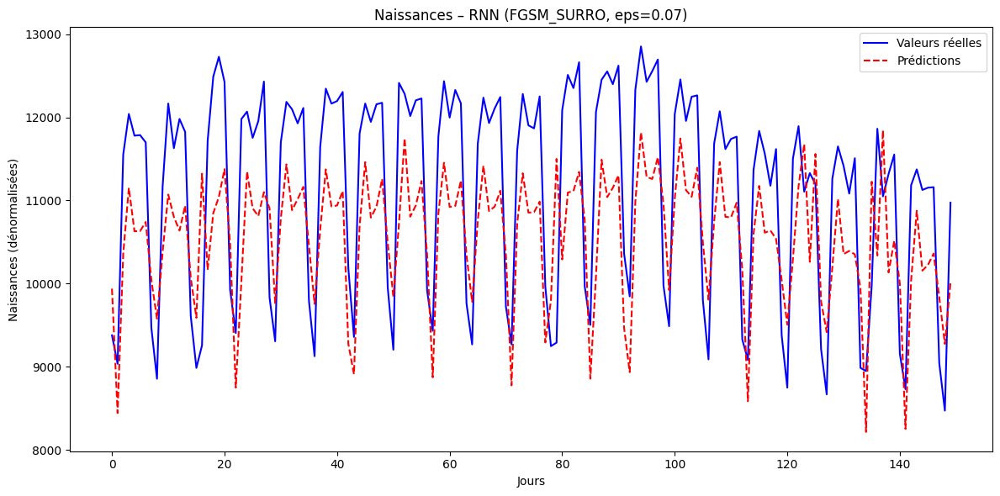

LSTM | FGSM_SURRO – Epsilon 0.07 – MAE: 1206.0457 | SIM: 0.9947 | RMSE: 1291.7598


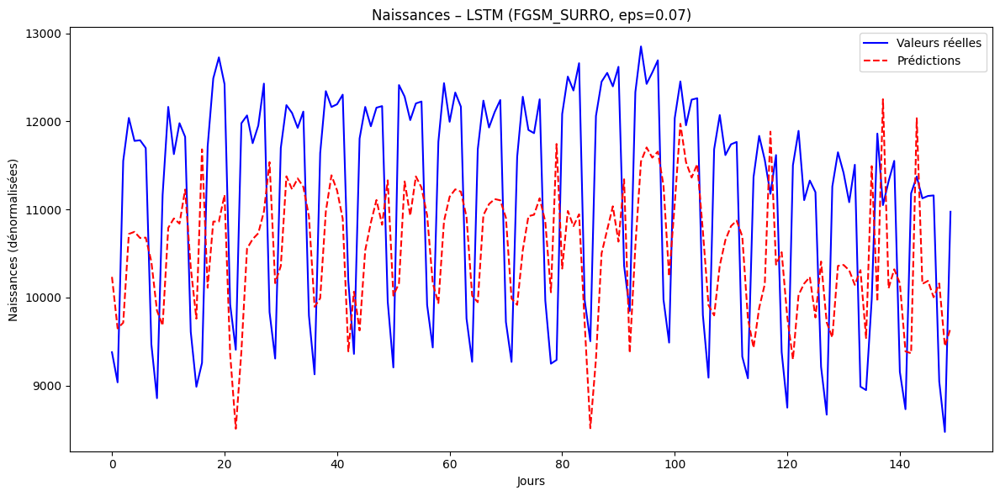

GRU | FGSM_SURRO – Epsilon 0.10 – MAE: 1061.8624 | SIM: 0.9950 | RMSE: 1117.8626


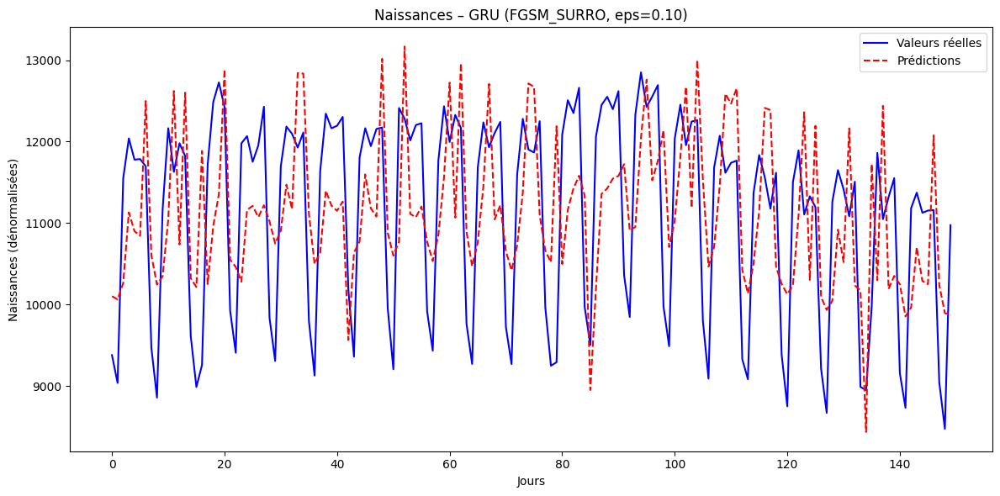

RNN | FGSM_SURRO – Epsilon 0.10 – MAE: 1136.1483 | SIM: 0.9961 | RMSE: 1186.1693


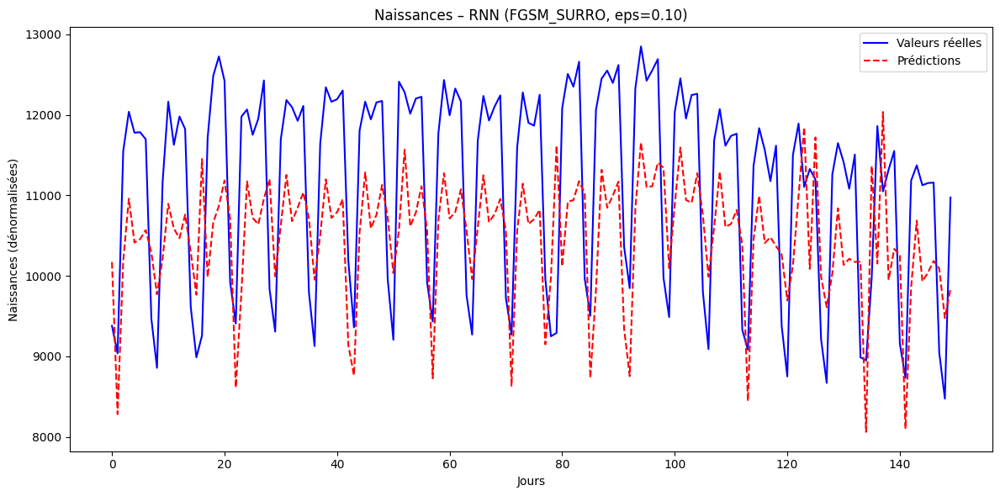

LSTM | FGSM_SURRO – Epsilon 0.10 – MAE: 1512.8641 | SIM: 0.9917 | RMSE: 1611.3583


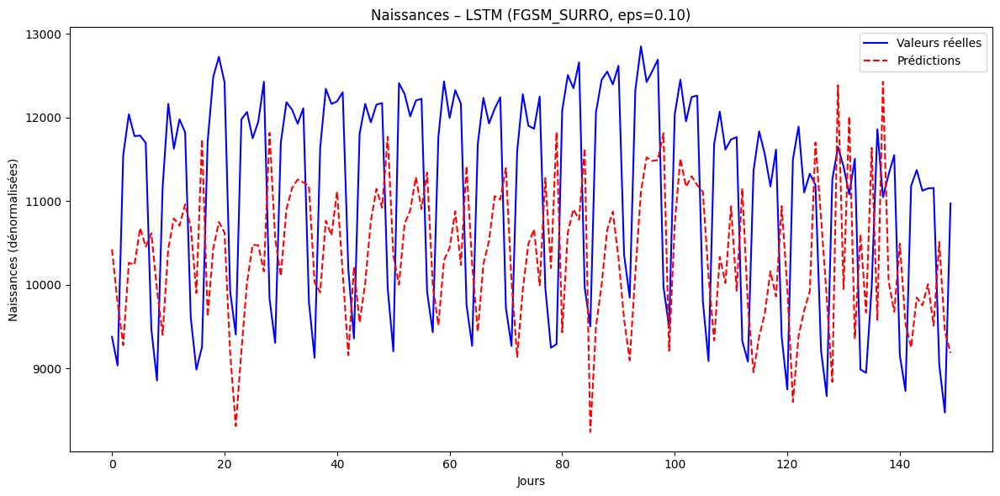

GRU | FGSM_SURRO – Epsilon 0.20 – MAE: 1919.0451 | SIM: 0.9841 | RMSE: 1995.9811


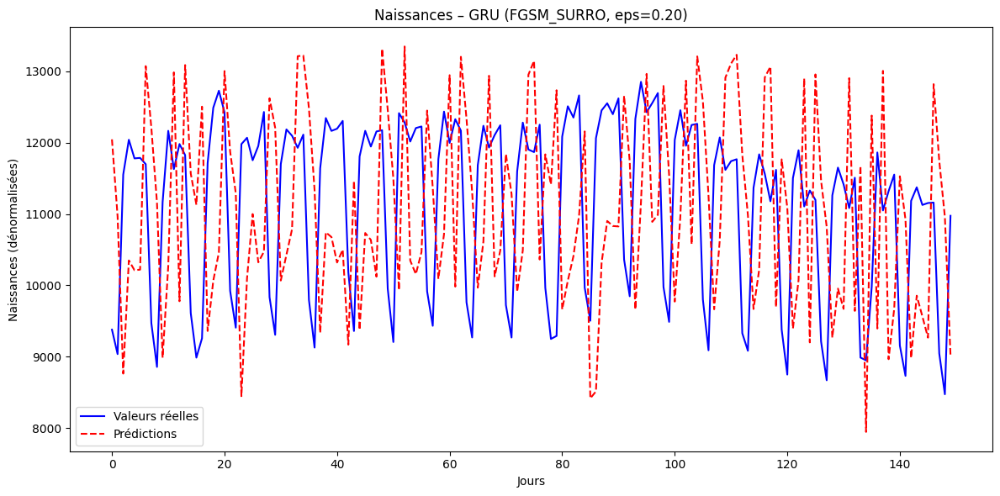

RNN | FGSM_SURRO – Epsilon 0.20 – MAE: 1864.0369 | SIM: 0.9885 | RMSE: 1897.5893


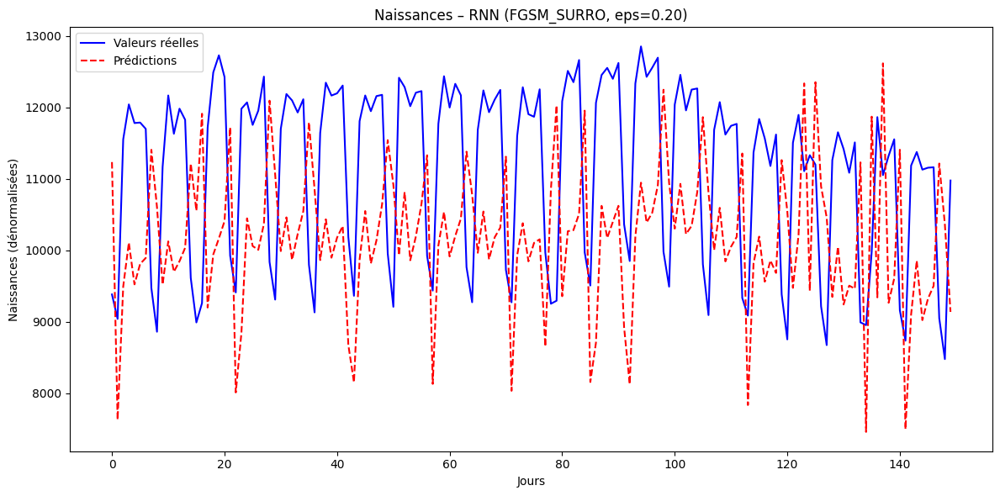

LSTM | FGSM_SURRO – Epsilon 0.20 – MAE: 2624.1048 | SIM: 0.9739 | RMSE: 2755.0359


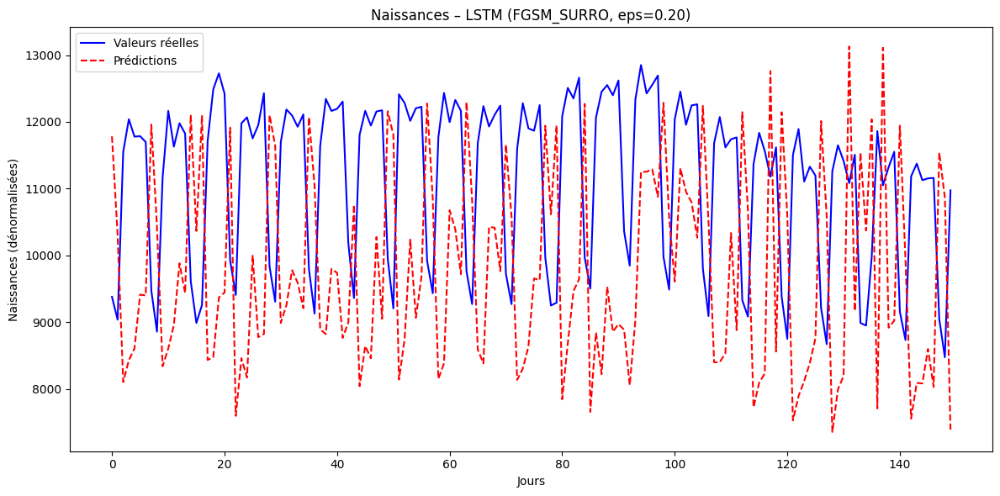

In [ ]:
for eps in epsilons:
    true_vals_surro, preds_surro = fgsm_surrogate_attack(
        model_gru_surrogate,
        model_gru,
        test_loader,
        eps,
        serie_min_rev, serie_max_rev
    )

    log_and_plot_births(
        true_values=true_vals_surro[-days_plot:],
        predictions=preds_surro[-days_plot:],
        model_name='GRU',
        attack_name='FGSM_SURRO',
        epsilon=eps,
        res_tab=res_tab_bim,
        similarity_fn=scalar_similarity,
        save_path=f"results/birth/SEED_{seed}/plots/FGSM_SURRO/{eps}",
        save_png=True
    )

    true_vals_surro, preds_surro = fgsm_surrogate_attack(
        model_rnn_surrogate,
        model_rnn,
        test_loader,
        eps,
        serie_min_rev, serie_max_rev
    )

    log_and_plot_births(
        true_values=true_vals_surro[-days_plot:],
        predictions=preds_surro[-days_plot:],
        model_name='RNN',
        attack_name='FGSM_SURRO',
        epsilon=eps,
        res_tab=res_tab_bim,
        similarity_fn=scalar_similarity,
        save_path=f"results/birth/SEED_{seed}/plots/FGSM_SURRO/{eps}",
        save_png=True
    )

    true_vals_surro, preds_surro = fgsm_surrogate_attack(
        model_surrogate,
        model,
        test_loader,
        eps,
        serie_min_rev, serie_max_rev
    )

    log_and_plot_births(
        true_values=true_vals_surro[-days_plot:],
        predictions=preds_surro[-days_plot:],
        model_name='LSTM',
        attack_name='FGSM_SURRO',
        epsilon=eps,
        res_tab=res_tab_bim,
        similarity_fn=scalar_similarity,
        save_path=f"results/birth/SEED_{seed}/plots/FGSM_SURRO/{eps}",
        save_png=True
    )

In [ ]:
display(res_tab_bim)

Attack           REV_BIM                                                  \
ε                   0.01        0.02        0.03        0.04        0.05   
Model Metric                                                               
LSTM  MAE     427.017236  431.052850  434.346246  433.985333  435.838843   
      RMSE    526.959787  533.301176  535.719274  537.184157  541.718911   
      SIM       0.999048    0.999015    0.998989    0.998959    0.998936   
RNN   MAE     455.122041  457.980990  462.367772  467.492827  474.731010   
      RMSE    570.409911  574.322300  579.480243  585.810234  593.886908   
      SIM       0.999270    0.999269    0.999263    0.999250    0.999228   
GRU   MAE     265.026310  267.626442  274.936351  285.472699  300.154716   
      RMSE    392.815013  391.347577  393.759656  399.557073  409.064535   
      SIM       0.999389    0.999392    0.999384    0.999365    0.999334   

Attack                                             FGSM_SURRO              \
ε                   0.07        0.10         0.20        0.01        0.02   
Model Metric                                                                
LSTM  MAE     445.594345  463.084862   615.337266  516.942711  608.621699   
      RMSE    559.173221  578.827133   765.294773  612.177828  699.769624   
      SIM       0.998825    0.998712     0.997685    0.998758    0.998377   
RNN   MAE     494.916905  542.406020   850.993293  511.385385  574.101958   
      RMSE    615.968876  669.739054  1004.942774  619.190601  674.243723   
      SIM       0.999156    0.998950     0.997266    0.999121    0.998943   
GRU   MAE     331.618130  380.665248   513.486375  327.251574  395.629257   
      RMSE    433.312030  474.251686   660.539141  446.746045  503.269681   
      SIM       0.999254    0.999116     0.998395    0.999208    0.998993   

Attack                                                                      \
ε                   0.03        0.04        0.05         0.07         0.10   
Model Metric                                                                 
LSTM  MAE     711.312378  811.300030  916.722106  1206.045685  1512.864121   
      RMSE    793.428533  893.068878  996.395655  1291.759822  1611.358274   
      SIM       0.997916    0.997433    0.996853     0.994719     0.991663   
RNN   MAE     641.759212  710.486326  780.020086   956.667259  1136.148328   
      RMSE    732.104067  792.159146  854.302705  1016.547105  1186.169335   
      SIM       0.998731    0.998482    0.998194     0.997292     0.996112   
GRU   MAE     469.591143  547.372665  626.417266   832.093356  1061.862394   
      RMSE    565.336541  631.630113  701.577431   891.386858  1117.862574   
      SIM       0.998728    0.998411    0.998040     0.996835     0.995015   

Attack                     
ε                    0.20  
Model Metric               
LSTM  MAE     2624.104847  
      RMSE    2755.035934  
      SIM        0.973913  
RNN   MAE     1864.036913  
      RMSE    1897.589280  
      SIM        0.988514  
GRU   MAE     1919.045065  
      RMSE    1995.981055  
      SIM        0.984055

In [ ]:
# Creation of the tab result for plotting adversial attack result
models = ['LSTM','RNN','GRU']
metrics = ['MAE', "RMSE", 'SIM']

row_index = pd.MultiIndex.from_product([models, metrics], names=['Model', 'Metric'])

attacks = ['BOUNDARY']
epsilons_attack = {
    'BOUNDARY':[0.01,0.02,0.03,0.04, 0.05, 0.075, 0.1, 0.2],
}

col_tuples = []
for atk, eps_list in epsilons_attack.items():
    for eps in eps_list:
        col_tuples.append((atk, f"{eps:.2f}"))

col_index = pd.MultiIndex.from_tuples(col_tuples, names=['Attack', 'ε'])

res_tab_boundary = pd.DataFrame(index=row_index, columns=col_index, dtype=float)

print(res_tab_boundary)

Attack       BOUNDARY                                   
ε                0.01 0.02 0.03 0.04 0.05 0.07 0.10 0.20
Model Metric                                            
LSTM  MAE         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      RMSE        NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      SIM         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
RNN   MAE         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      RMSE        NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      SIM         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
GRU   MAE         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      RMSE        NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN
      SIM         NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN


In [ ]:
from attack.boundary import boundary_attack

GRU | BOUNDARY – Epsilon 0.01 – MAE: 273.0885 | SIM: 0.9994 | RMSE: 402.3799


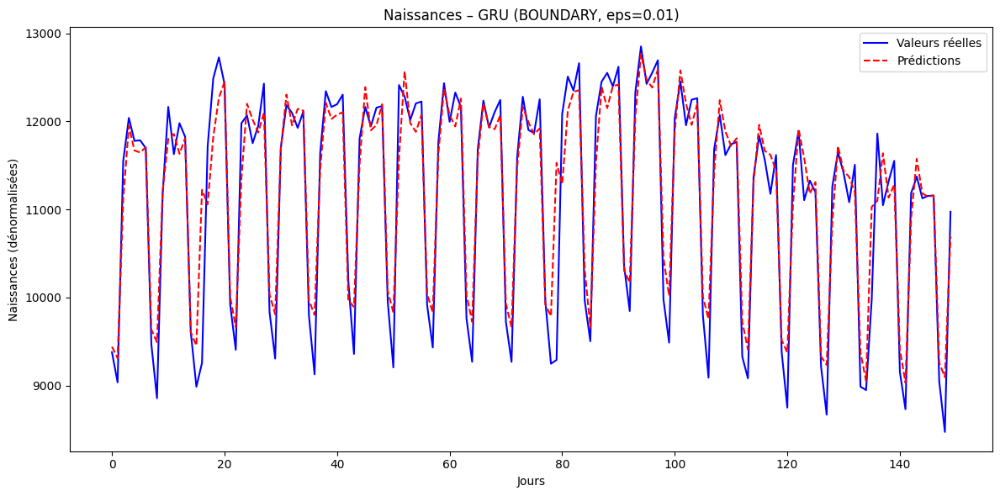

LSTM | BOUNDARY – Epsilon 0.01 – MAE: 431.0747 | SIM: 0.9991 | RMSE: 532.2269


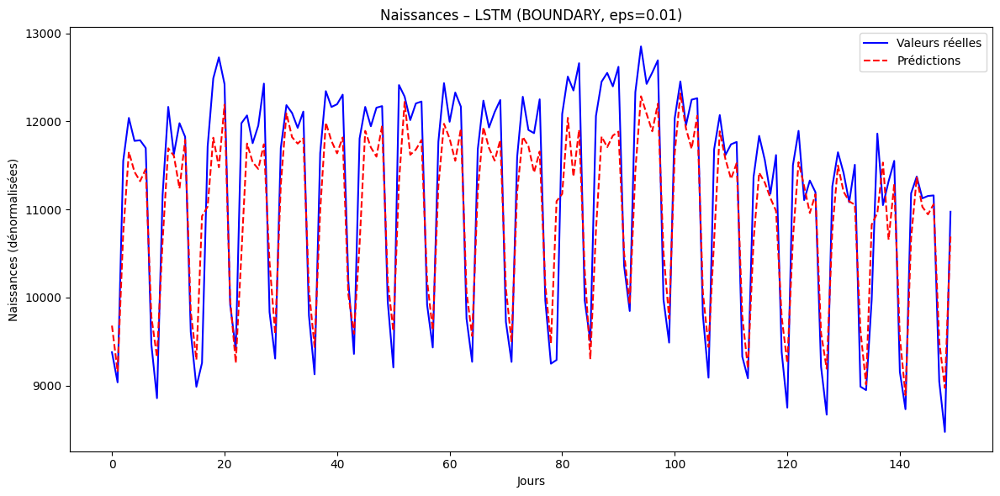

RNN | BOUNDARY – Epsilon 0.01 – MAE: 457.2896 | SIM: 0.9993 | RMSE: 570.3244


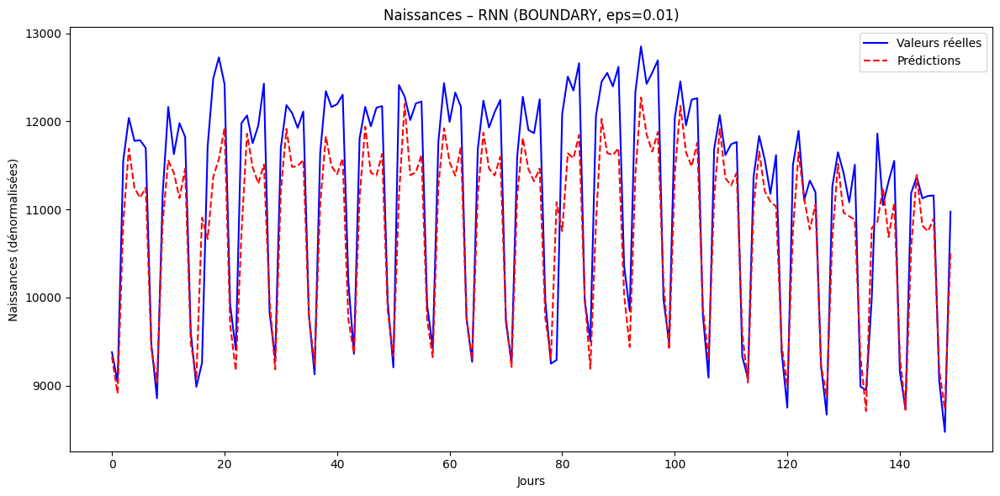

GRU | BOUNDARY – Epsilon 0.02 – MAE: 276.7389 | SIM: 0.9994 | RMSE: 401.6029


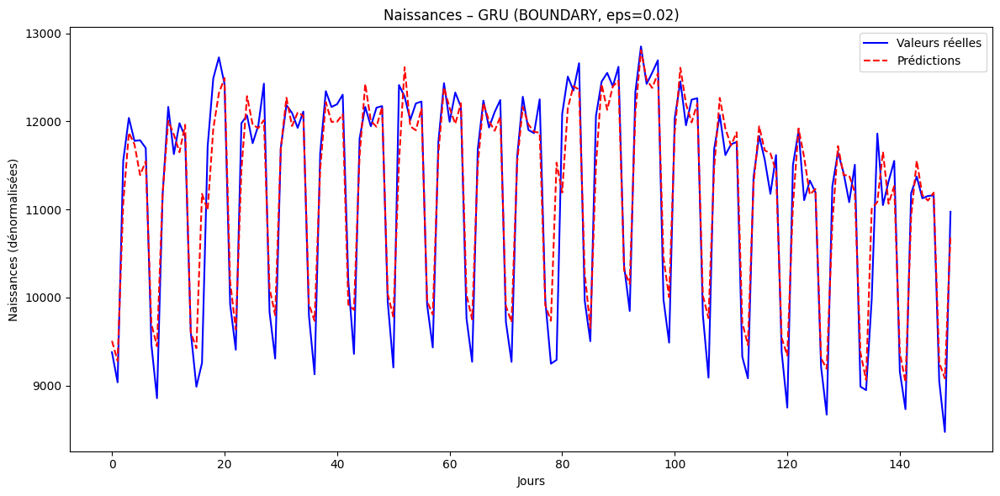

LSTM | BOUNDARY – Epsilon 0.02 – MAE: 434.0184 | SIM: 0.9990 | RMSE: 540.3864


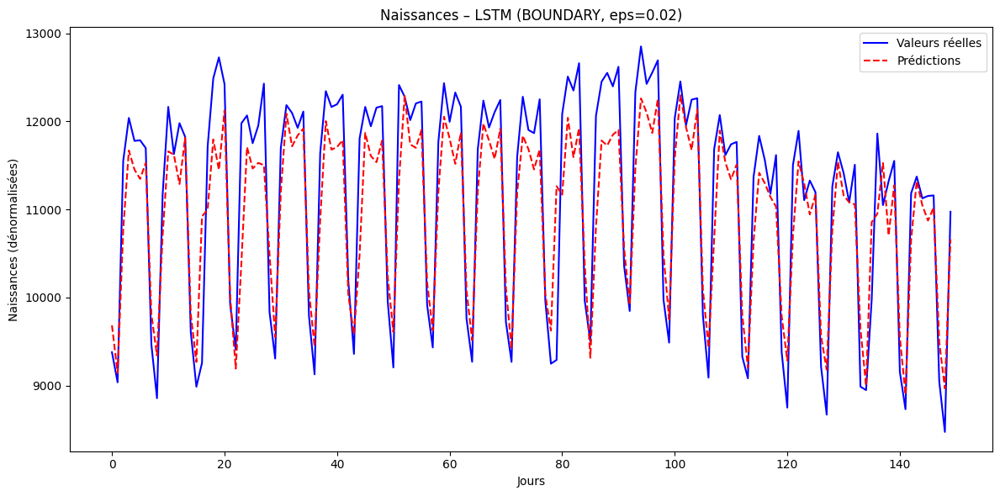

RNN | BOUNDARY – Epsilon 0.02 – MAE: 460.9161 | SIM: 0.9993 | RMSE: 574.5756


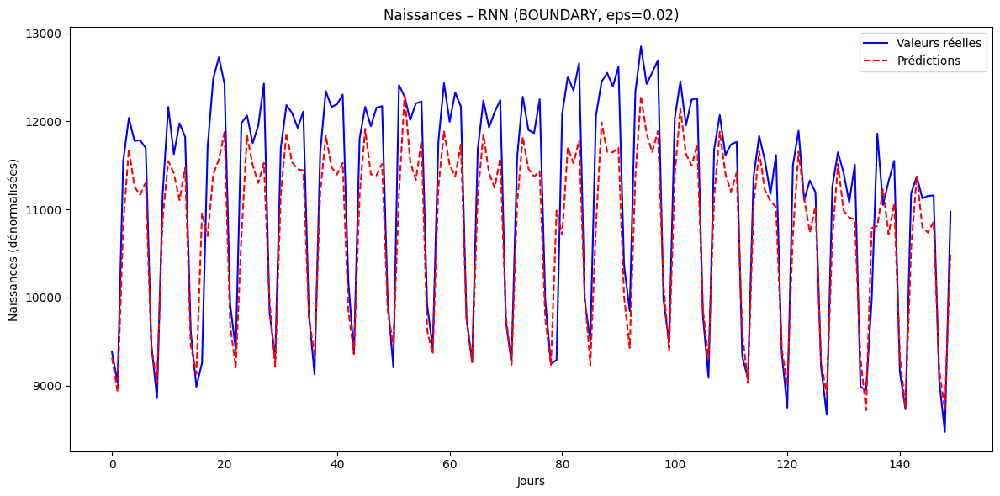

GRU | BOUNDARY – Epsilon 0.03 – MAE: 285.3536 | SIM: 0.9993 | RMSE: 406.9162


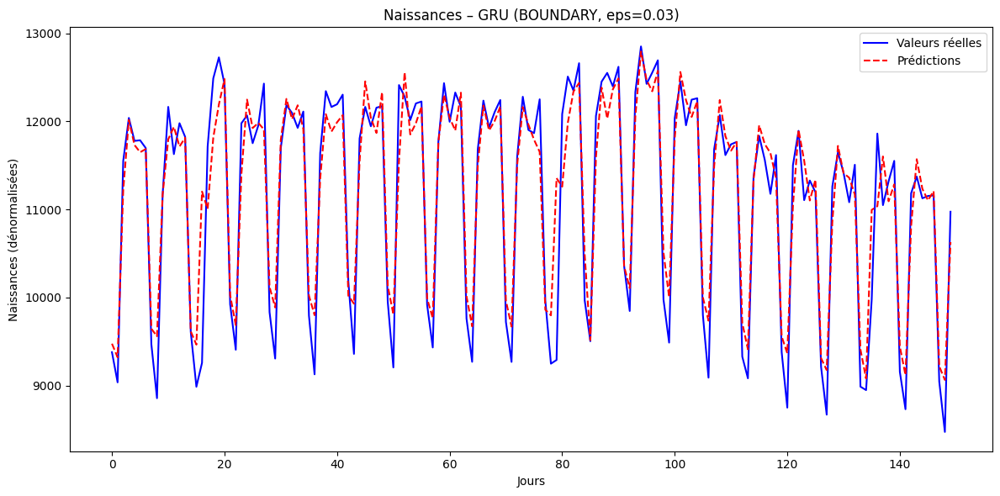

LSTM | BOUNDARY – Epsilon 0.03 – MAE: 442.0885 | SIM: 0.9990 | RMSE: 545.2303


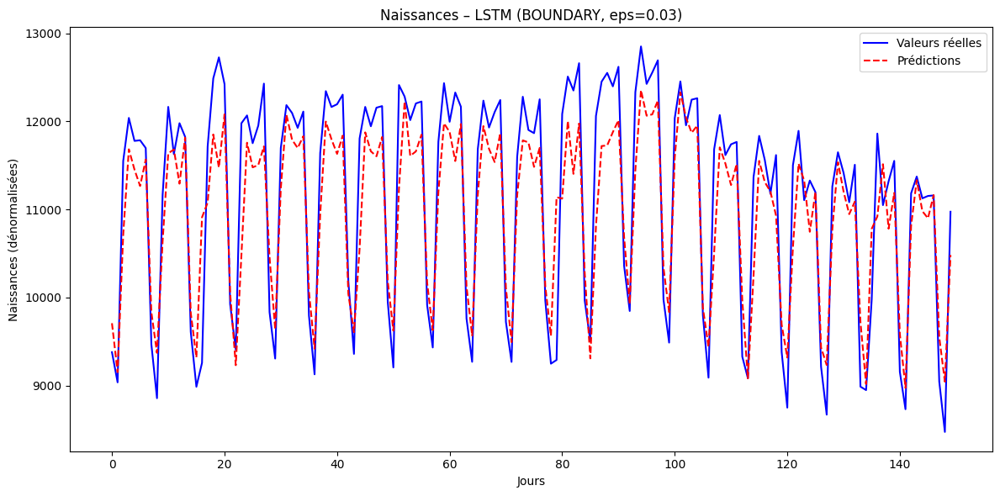

RNN | BOUNDARY – Epsilon 0.03 – MAE: 469.0771 | SIM: 0.9992 | RMSE: 586.0018


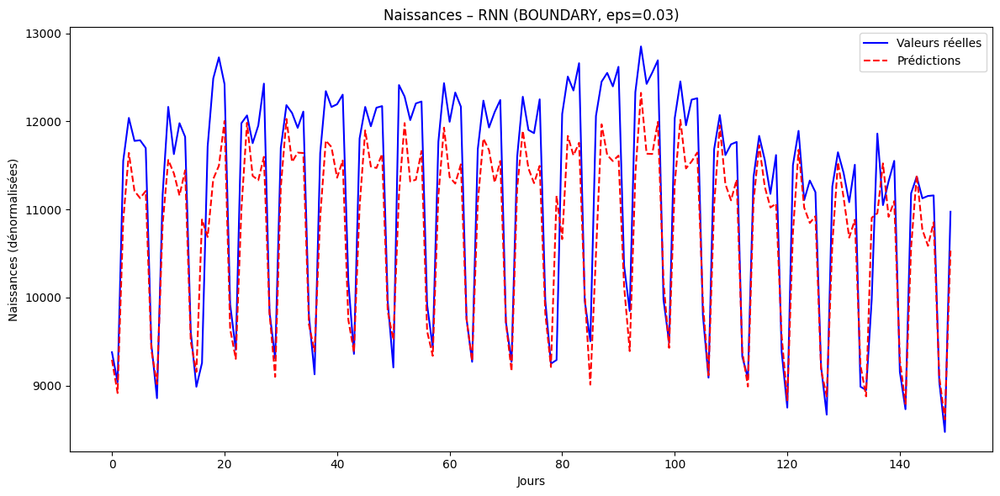

GRU | BOUNDARY – Epsilon 0.04 – MAE: 302.9685 | SIM: 0.9993 | RMSE: 430.2525


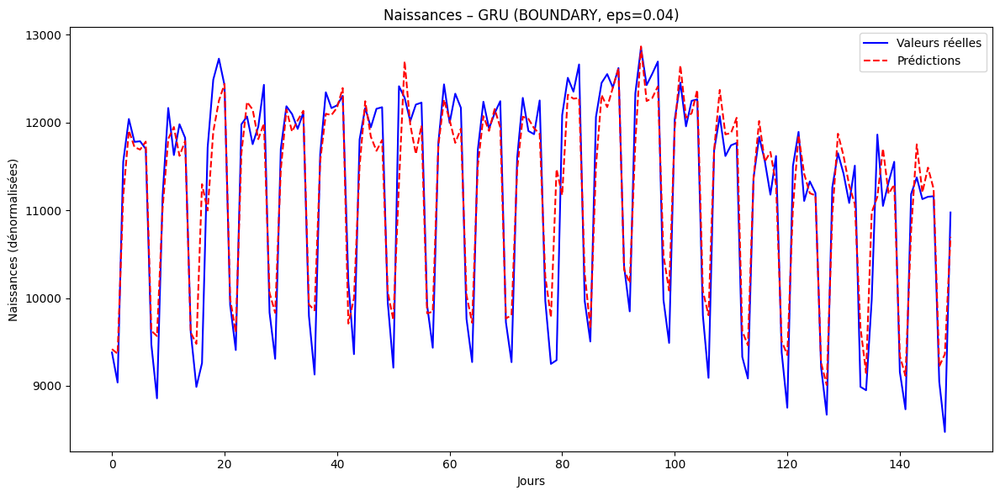

LSTM | BOUNDARY – Epsilon 0.04 – MAE: 455.2186 | SIM: 0.9989 | RMSE: 562.6112


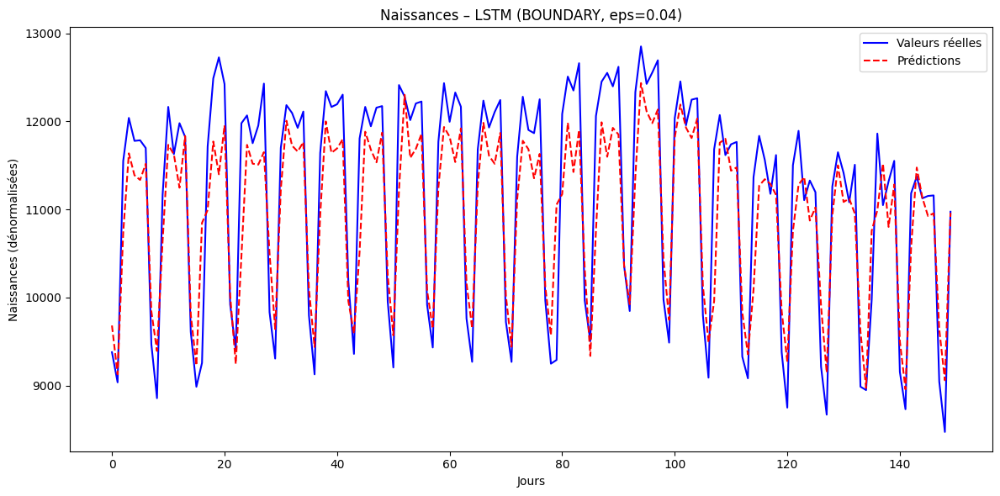

RNN | BOUNDARY – Epsilon 0.04 – MAE: 478.7063 | SIM: 0.9992 | RMSE: 594.7598


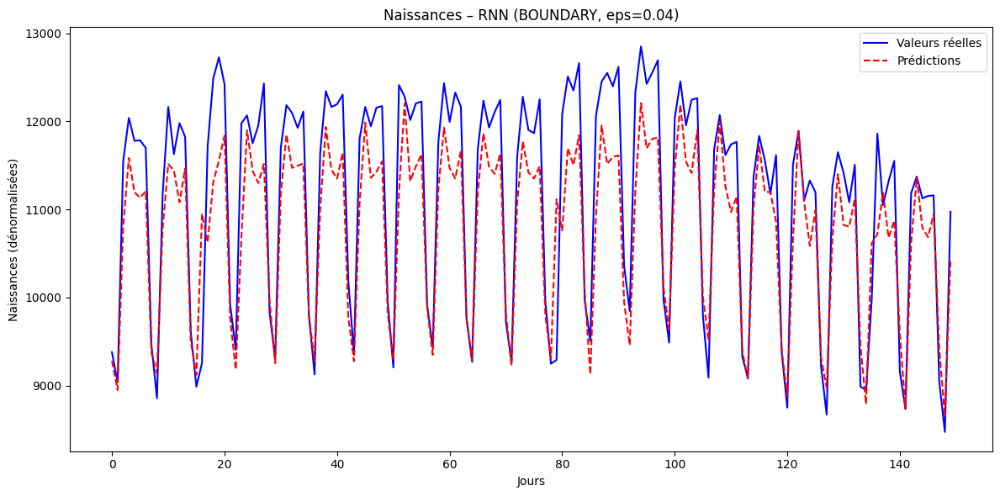

GRU | BOUNDARY – Epsilon 0.05 – MAE: 294.3689 | SIM: 0.9993 | RMSE: 419.6306


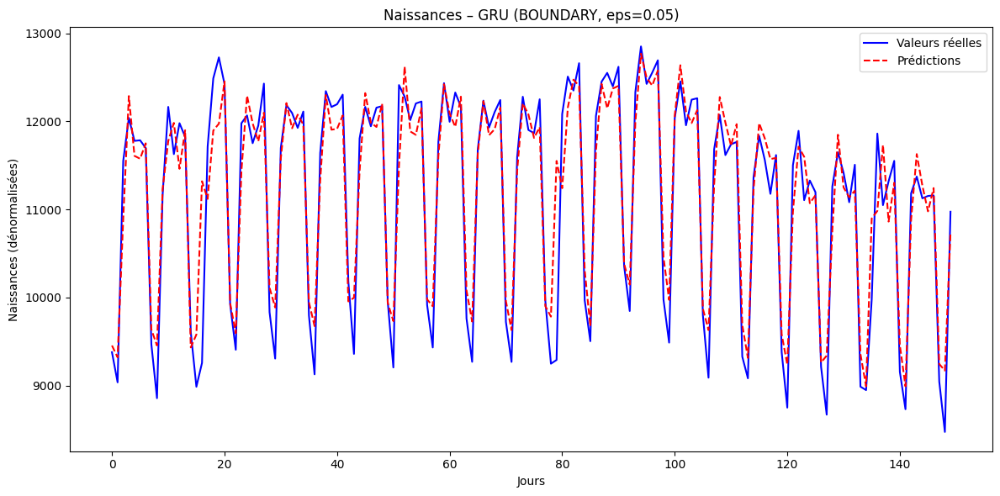

LSTM | BOUNDARY – Epsilon 0.05 – MAE: 445.0442 | SIM: 0.9990 | RMSE: 549.4706


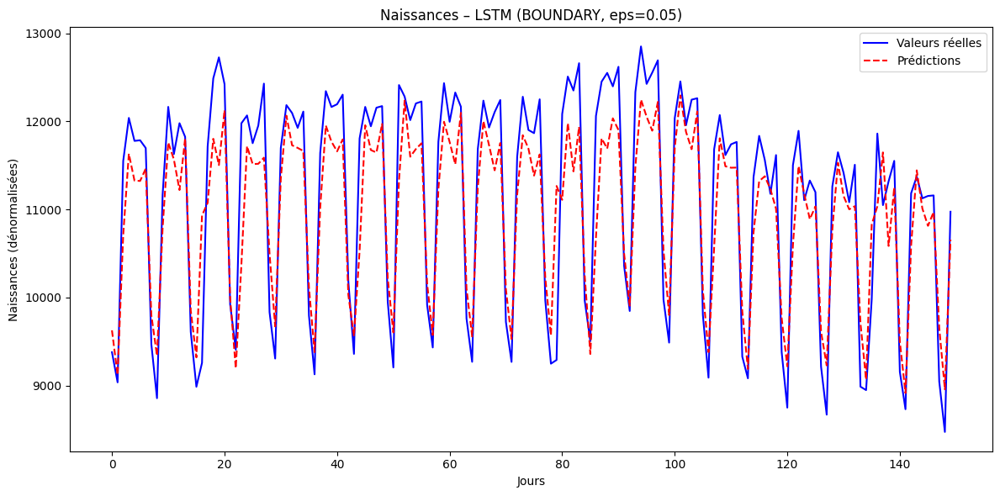

RNN | BOUNDARY – Epsilon 0.05 – MAE: 491.6181 | SIM: 0.9992 | RMSE: 607.2216


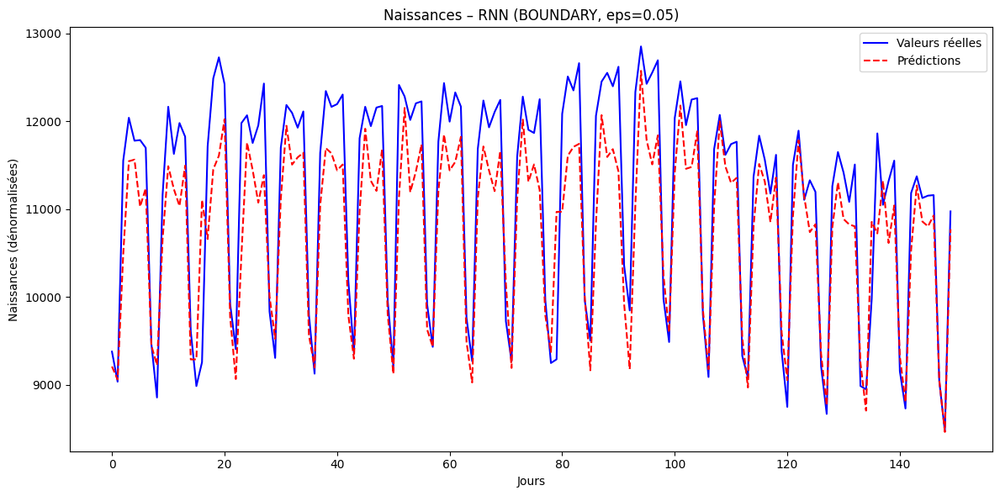

GRU | BOUNDARY – Epsilon 0.07 – MAE: 364.7714 | SIM: 0.9990 | RMSE: 511.8494


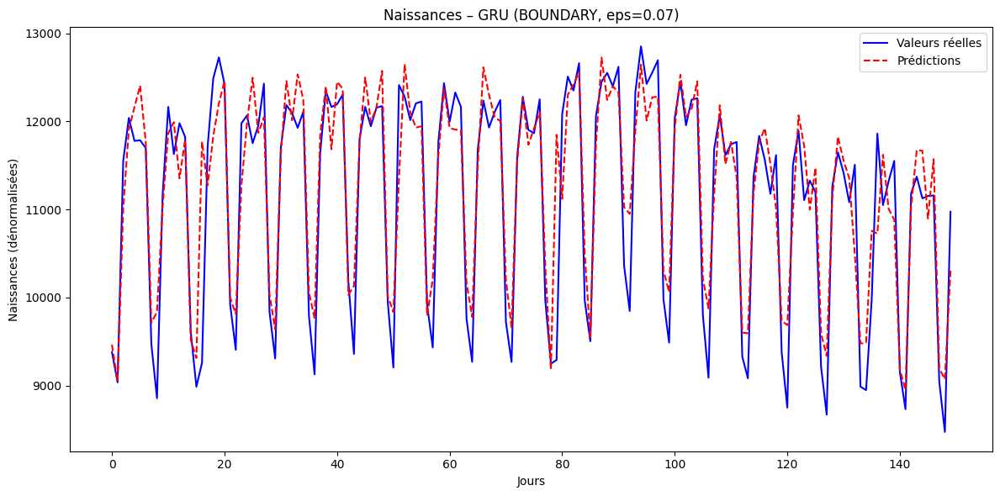

LSTM | BOUNDARY – Epsilon 0.07 – MAE: 456.4611 | SIM: 0.9990 | RMSE: 553.2191


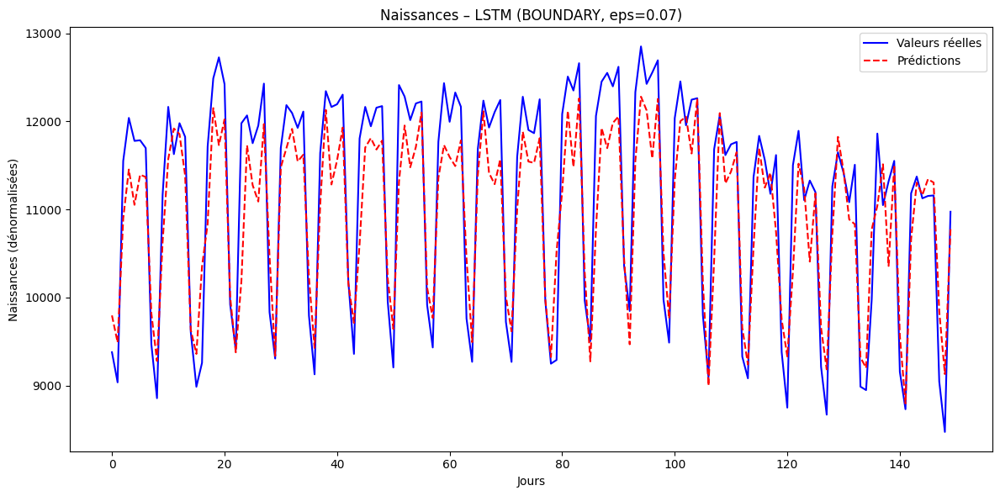

RNN | BOUNDARY – Epsilon 0.07 – MAE: 491.0989 | SIM: 0.9991 | RMSE: 614.2039


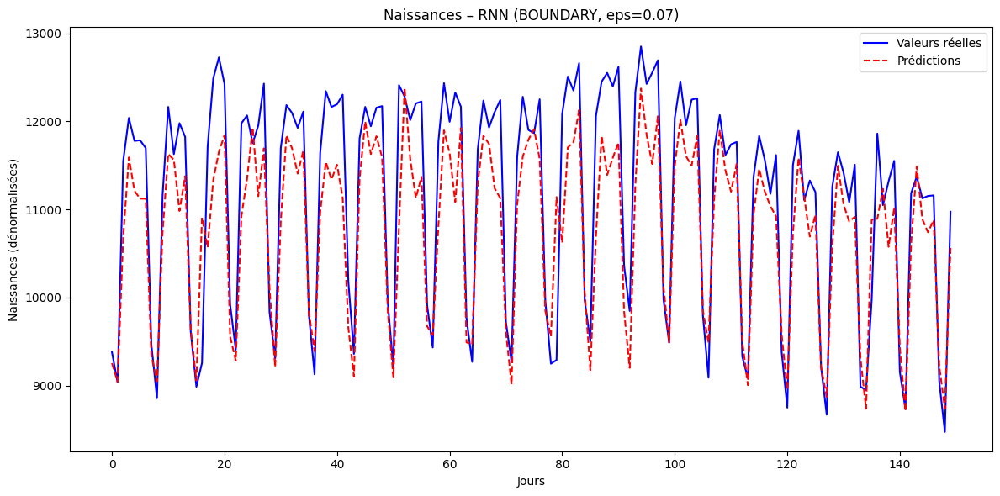

GRU | BOUNDARY – Epsilon 0.10 – MAE: 385.0329 | SIM: 0.9989 | RMSE: 524.9738


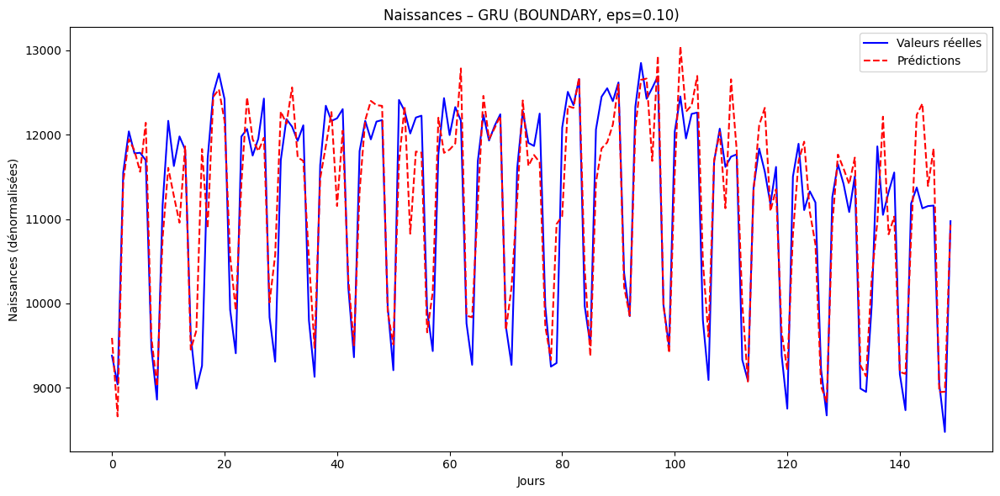

LSTM | BOUNDARY – Epsilon 0.10 – MAE: 535.1031 | SIM: 0.9986 | RMSE: 652.1438


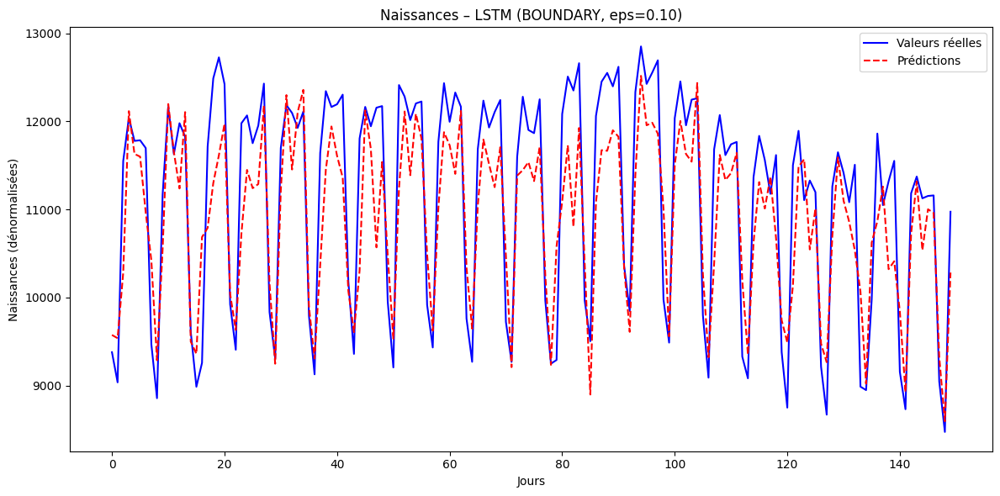

RNN | BOUNDARY – Epsilon 0.10 – MAE: 522.3191 | SIM: 0.9990 | RMSE: 635.3420


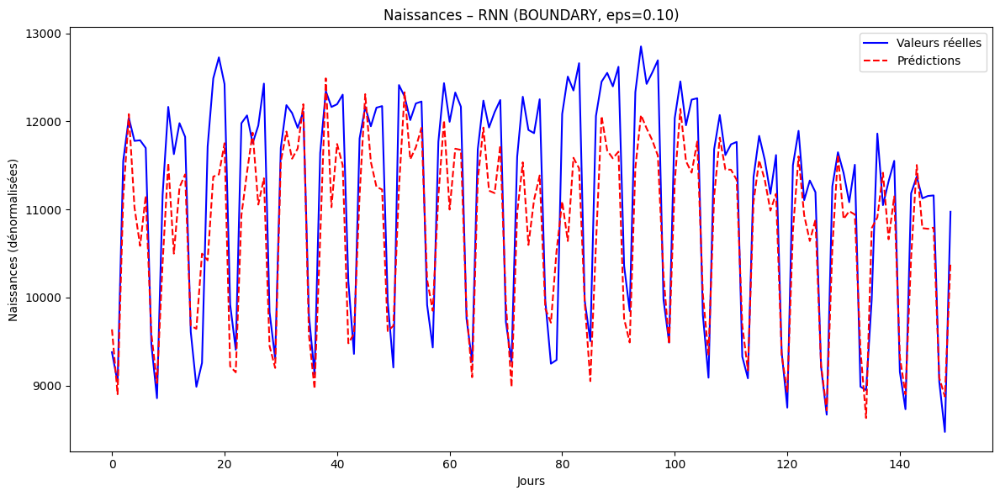

GRU | BOUNDARY – Epsilon 0.20 – MAE: 710.1055 | SIM: 0.9967 | RMSE: 909.0025


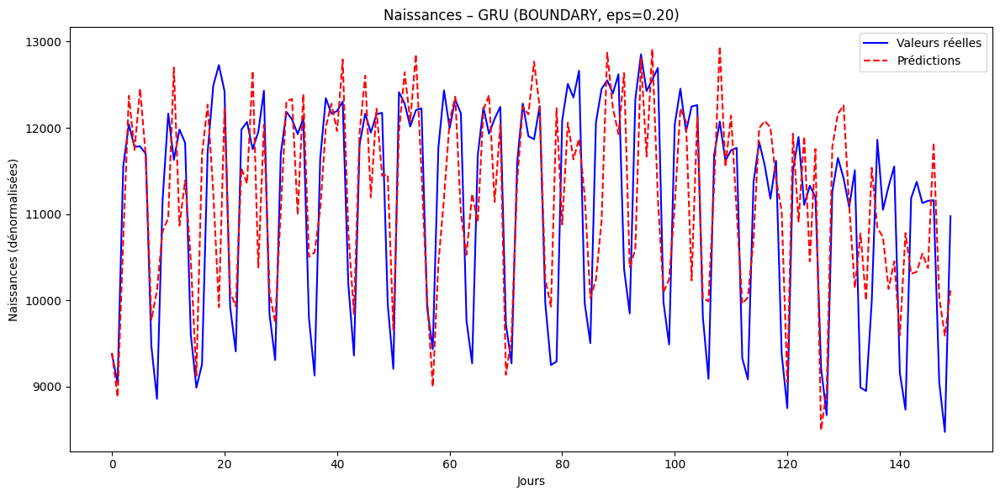

LSTM | BOUNDARY – Epsilon 0.20 – MAE: 675.1907 | SIM: 0.9975 | RMSE: 830.2694


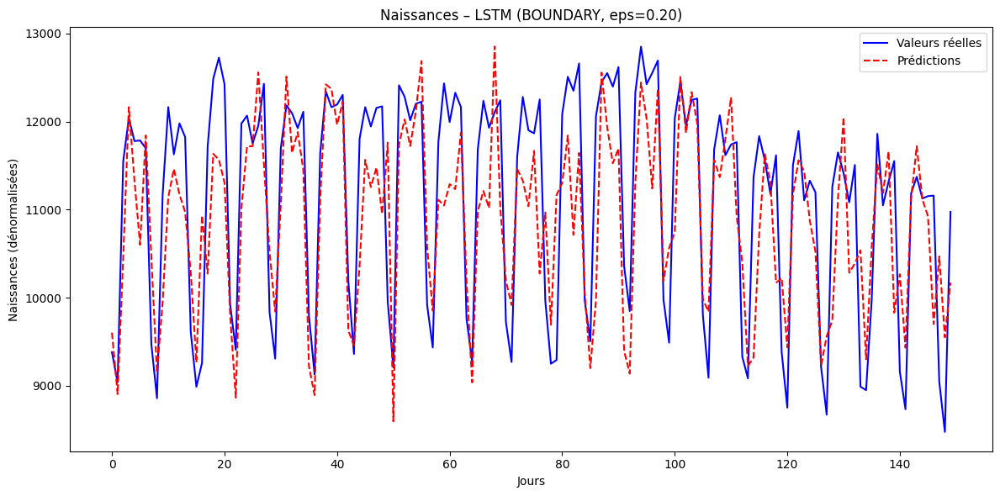

RNN | BOUNDARY – Epsilon 0.20 – MAE: 659.2026 | SIM: 0.9980 | RMSE: 837.5007


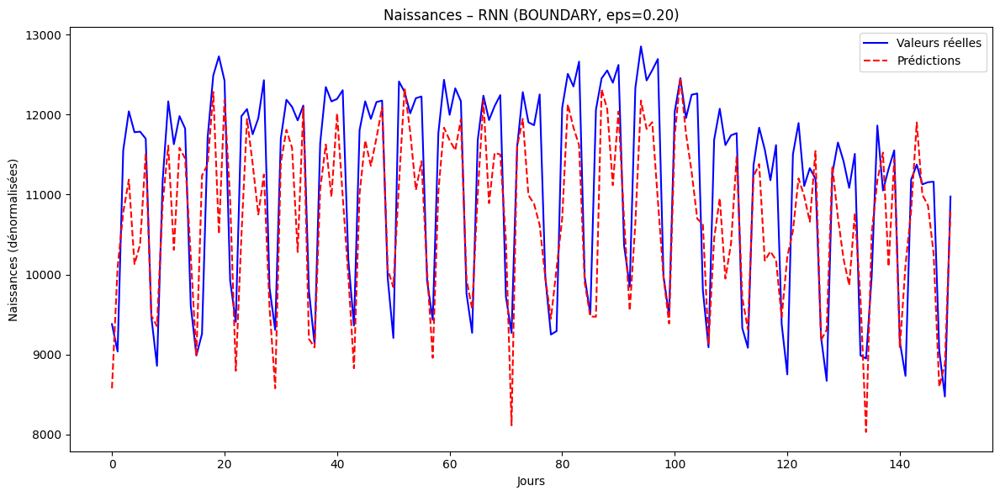

In [ ]:
for eps in epsilons:
  delta = eps * 0.5
  eta = eps * 0.25
  num_iter = int(20 + 200 * eps)
  true_vals_bondary, preds_bondary = boundary_attack(
      model_gru,
      test_loader,
      eps,
      serie_min_rev, serie_max_rev,
      num_iter,delta,eta
  )

  log_and_plot_births(
      true_values=true_vals_bondary[-days_plot:],
      predictions=preds_bondary[-days_plot:],
      model_name='GRU',
      attack_name='BOUNDARY',
      epsilon=eps,
      res_tab=res_tab_boundary,
      similarity_fn=scalar_similarity,
      save_path=f"results/birth/SEED_{seed}/plots/BOUNDARY/{eps}",
      save_png=True
  )

  true_vals_bondary, preds_bondary = boundary_attack(
      model,
      test_loader,
      eps,
      serie_min_rev, serie_max_rev,
      num_iter,delta,eta
  )

  log_and_plot_births(
      true_values=true_vals_bondary[-days_plot:],
      predictions=preds_bondary[-days_plot:],
      model_name='LSTM',
      attack_name='BOUNDARY',
      epsilon=eps,
      res_tab=res_tab_boundary,
      similarity_fn=scalar_similarity,
      save_path=f"results/birth/SEED_{seed}/plots/BOUNDARY/{eps}",
      save_png=True
  )

  true_vals_bondary, preds_bondary = boundary_attack(
      model_rnn,
      test_loader,
      eps,
      serie_min_rev, serie_max_rev,
      num_iter,delta,eta
  )

  log_and_plot_births(
      true_values=true_vals_bondary[-days_plot:],
      predictions=preds_bondary[-days_plot:],
      model_name='RNN',
      attack_name='BOUNDARY',
      epsilon=eps,
      res_tab=res_tab_boundary,
      similarity_fn=scalar_similarity,
      save_path=f"results/birth/SEED_{seed}/plots/BOUNDARY/{eps}",
      save_png=True
  )

In [ ]:
display(res_tab_boundary)

Attack          BOUNDARY                                                  \
ε                   0.01        0.02        0.03        0.04        0.05   
Model Metric                                                               
LSTM  MAE     431.074696  434.018435  442.088485  455.218636  445.044234   
      RMSE    532.226858  540.386357  545.230304  562.611192  549.470624   
      SIM       0.999056    0.999017    0.999001    0.998934    0.998986   
RNN   MAE     457.289622  460.916069  469.077119  478.706265  491.618056   
      RMSE    570.324380  574.575568  586.001834  594.759800  607.221643   
      SIM       0.999264    0.999251    0.999226    0.999182    0.999151   
GRU   MAE     273.088471  276.738928  285.353640  302.968470  294.368861   
      RMSE    402.379852  401.602914  406.916225  430.252492  419.630578   
      SIM       0.999361    0.999364    0.999345    0.999268    0.999302   

Attack                                            
ε                   0.07        0.10        0.20  
Model Metric                                      
LSTM  MAE     456.461094  535.103131  675.190727  
      RMSE    553.219113  652.143761  830.269379  
      SIM       0.998998    0.998615    0.997503  
RNN   MAE     491.098940  522.319116  659.202576  
      RMSE    614.203950  635.342043  837.500692  
      SIM       0.999088    0.999021    0.997962  
GRU   MAE     364.771378  385.032927  710.105496  
      RMSE    511.849416  524.973841  909.002450  
      SIM       0.998985    0.998907    0.996710

In [ ]:
result = pd.concat([res_tab, res_tab_bim,res_tab_fgsm,res_tab_boundary], axis=1)

# Affichage du résultat
display(result)
result.to_excel(f"results/birth/SEED_{seed}/result.xlsx")

Attack                NA        PAST         REV                          \
ε                   0.00        0.00        0.01        0.02        0.03   
Model Metric                                                               
LSTM  MAE     427.817316  328.922987  428.967296  429.811878  433.667491   
      RMSE    529.717237  439.150283  530.587851  533.960743  537.489750   
      SIM       0.999057    0.999335    0.999044    0.999028    0.998981   
RNN   MAE     453.177722  317.246896  455.122041  458.479528  463.590075   
      RMSE    567.480292  450.218435  570.409911  574.566491  580.249171   
      SIM       0.999266    0.999224    0.999270    0.999268    0.999261   
GRU   MAE     268.170518  333.241523  451.473848  452.666331  455.525579   
      RMSE    397.744667  456.641566  566.563518  568.517340  573.474159   
      SIM       0.999376    0.999255    0.999283    0.999287    0.999277   

Attack                                                                    ...  \
ε                   0.04        0.05        0.07        0.10        0.20  ...   
Model Metric                                                              ...   
LSTM  MAE     450.732569  433.265869  495.211502  502.140627  753.430234  ...   
      RMSE    552.652235  547.680498  607.824639  631.816271  962.419282  ...   
      SIM       0.998902    0.998901    0.998638    0.998463    0.996317  ...   
RNN   MAE     469.462190  477.298076  502.677460  538.268650  770.176554  ...   
      RMSE    587.206857  595.494915  623.050059  660.716555  915.748121  ...   
      SIM       0.999247    0.999228    0.999151    0.999032    0.997999  ...   
GRU   MAE     460.607980  468.568124  496.743084  540.202739  816.376805  ...   
      RMSE    581.287198  591.975200  630.821837  685.513595  993.154934  ...   
      SIM       0.999255    0.999220    0.999077    0.998860    0.997355  ...   

Attack               FGSM                 BOUNDARY                          \
ε                    0.10         0.20        0.01        0.02        0.03   
Model Metric                                                                 
LSTM  MAE     1683.855415  2949.041294  431.074696  434.018435  442.088485   
      RMSE    1793.092954  3084.494190  532.226858  540.386357  545.230304   
      SIM        0.989210     0.966124    0.999056    0.999017    0.999001   
RNN   MAE     1203.837872  1965.922007  457.289622  460.916069  469.077119   
      RMSE    1260.058838  2011.124590  570.324380  574.575568  586.001834   
      SIM        0.996065     0.988472    0.999264    0.999251    0.999226   
GRU   MAE     1116.482362  1883.552561  273.088471  276.738928  285.353640   
      RMSE    1159.433993  1940.794624  402.379852  401.602914  406.916225   
      SIM        0.994685     0.985167    0.999361    0.999364    0.999345   

Attack                                                                    
ε                   0.04        0.05        0.07        0.10        0.20  
Model Metric                                                              
LSTM  MAE     455.218636  445.044234  456.461094  535.103131  675.190727  
      RMSE    562.611192  549.470624  553.219113  652.143761  830.269379  
      SIM       0.998934    0.998986    0.998998    0.998615    0.997503  
RNN   MAE     478.706265  491.618056  491.098940  522.319116  659.202576  
      RMSE    594.759800  607.221643  614.203950  635.342043  837.500692  
      SIM       0.999182    0.999151    0.999088    0.999021    0.997962  
GRU   MAE     302.968470  294.368861  364.771378  385.032927  710.105496  
      RMSE    430.252492  419.630578  511.849416  524.973841  909.002450  
      SIM       0.999268    0.999302    0.998985    0.998907    0.996710  

[9 rows x 42 columns]

In [ ]:
from getpass import getpass

token = getpass("GitHub Token: ")

username = "Samy-Annasri"
repo = "ReverseForecastAttack"
branch = "main"  # ou 'master' selon ton repo
folder_path = f"results/birth/SEED_{seed}/"
!git add {folder_path}

!git config --global user.email "samyannasri.pro@gmail.com"
!git config --global user.name "Samy Annasri"

!git add {folder_path}
!git commit -m "add res boundary attack for SEED 999"
!git remote set-url origin https://{token}@github.com/{username}/{repo}.git
!git push origin {branch}

GitHub Token: ··········
[main ba77c22] add res boundary attack for SEED 999
 1 file changed, 0 insertions(+), 0 deletions(-)
 rewrite results/birth/SEED_999/result.xlsx (76%)
Enumerating objects: 11, done.
Counting objects: 100% (11/11), done.
Delta compression using up to 2 threads
Compressing objects: 100% (6/6), done.
Writing objects: 100% (6/6), 10.28 KiB | 10.28 MiB/s, done.
Total 6 (delta 3), reused 0 (delta 0), pack-reused 0
remote: Resolving deltas: 100% (3/3), completed with 3 local objects.
To https://github.com/Samy-Annasri/ReverseForecastAttack.git
   2d9d9d3..ba77c22  main -> main
